## Importing the relevant libraries

In [192]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import warnings, gc, joblib
warnings.filterwarnings('ignore')
from sklearnex import patch_sklearn
patch_sklearn()
from sklearn.model_selection import train_test_split, RandomizedSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression, PassiveAggressiveRegressor, SGDRegressor, HuberRegressor, Lasso, Ridge, ElasticNet, BayesianRidge, PoissonRegressor, ARDRegression, RANSACRegressor, GammaRegressor, TweedieRegressor, TheilSenRegressor
from sklearn.neighbors import KNeighborsRegressor 
from sklearn.svm import SVR, LinearSVR, NuSVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, AdaBoostRegressor, GradientBoostingRegressor, HistGradientBoostingRegressor, BaggingRegressor, VotingRegressor, StackingRegressor
from sklearn.neural_network import MLPRegressor
from xgboost import XGBRegressor, XGBRFRegressor
from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor
from scipy.stats import probplot
from sklearn.preprocessing import StandardScaler, OrdinalEncoder, OneHotEncoder, FunctionTransformer, PowerTransformer
from sklearn.metrics import r2_score, mean_absolute_percentage_error, mean_squared_error, mean_absolute_error
from sklearn.compose import ColumnTransformer
from feature_engine.outliers import Winsorizer
from sklearn.impute import KNNImputer, SimpleImputer
from sklearn.feature_selection import SelectKBest, SelectPercentile, SelectFromModel, f_regression, SequentialFeatureSelector, RFE
from yellowbrick.regressor import PredictionError, ResidualsPlot
from sklearn.pipeline import Pipeline

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


## Loading the dataset

In [2]:
df = pd.read_csv('Life Expectancy Data.csv')
df.head()

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5


## Data Exploration

In [3]:
df.shape

(2938, 22)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   object 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   float64
 5   infant deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   percentage expenditure           2938 non-null   float64
 8   Hepatitis B                      2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10   BMI                             2904 non-null   float64
 11  under-five deaths                2938 non-null   int64  
 12  Polio               

In [5]:
df.describe()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
count,2938.000000,2928.000000,2928.000000,2938.000000,2744.000000,2938.000000,2385.000000,2938.000000,2904.000000,2938.000000,2919.000000,2712.00000,2919.000000,2938.000000,2490.000000,2.286000e+03,2904.000000,2904.000000,2771.000000,2775.000000
mean,2007.518720,69.224932,164.796448,30.303948,4.602861,738.251295,80.940461,2419.592240,38.321247,42.035739,82.550188,5.93819,82.324084,1.742103,7483.158469,1.275338e+07,4.839704,4.870317,0.627551,11.992793
std,4.613841,9.523867,124.292079,117.926501,4.052413,1987.914858,25.070016,11467.272489,20.044034,160.445548,23.428046,2.49832,23.716912,5.077785,14270.169342,6.101210e+07,4.420195,4.508882,0.210904,3.358920
min,2000.000000,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.37000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2004.000000,63.100000,74.000000,0.000000,0.877500,4.685343,77.000000,0.000000,19.300000,0.000000,78.000000,4.26000,78.000000,0.100000,463.935626,1.957932e+05,1.600000,1.500000,0.493000,10.100000
50%,2008.000000,72.100000,144.000000,3.000000,3.755000,64.912906,92.000000,17.000000,43.500000,4.000000,93.000000,5.75500,93.000000,0.100000,1766.947595,1.386542e+06,3.300000,3.300000,0.677000,12.300000
75%,2012.000000,75.700000,228.000000,22.000000,7.702500,441.534144,97.000000,360.250000,56.200000,28.000000,97.000000,7.49250,97.000000,0.800000,5910.806335,7.420359e+06,7.200000,7.200000,0.779000,14.300000
max,2015.000000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,87.300000,2500.000000,99.000000,17.60000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


In [6]:
df.isna().sum()

Country                              0
Year                                 0
Status                               0
Life expectancy                     10
Adult Mortality                     10
infant deaths                        0
Alcohol                            194
percentage expenditure               0
Hepatitis B                        553
Measles                              0
 BMI                                34
under-five deaths                    0
Polio                               19
Total expenditure                  226
Diphtheria                          19
 HIV/AIDS                            0
GDP                                448
Population                         652
 thinness  1-19 years               34
 thinness 5-9 years                 34
Income composition of resources    167
Schooling                          163
dtype: int64

In [7]:
df.duplicated().sum()

0

In [8]:
df.nunique()

Country                             193
Year                                 16
Status                                2
Life expectancy                     362
Adult Mortality                     425
infant deaths                       209
Alcohol                            1076
percentage expenditure             2328
Hepatitis B                          87
Measles                             958
 BMI                                608
under-five deaths                   252
Polio                                73
Total expenditure                   818
Diphtheria                           81
 HIV/AIDS                           200
GDP                                2490
Population                         2278
 thinness  1-19 years               200
 thinness 5-9 years                 207
Income composition of resources     625
Schooling                           173
dtype: int64

In [9]:
df.rename({'Life expectancy ': 'Life Expectancy',
           'infant deaths': 'Infant Deaths',
           'percentage expenditure': 'Percentage Expenditure',
           'Measles ': 'Measles',
           ' BMI ': 'BMI',
           'under-five deaths ': 'Under-Five Deaths',
           'Total expenditure': 'Total Expenditure',
           'Diphtheria ': 'Diphtheria',
           ' HIV/AIDS': 'HIV/AIDS',
           ' thinness  1-19 years': 'Thinness 1-19 Years',
           ' thinness 5-9 years': 'Thinness 5-9 Years',
           'Income composition of resources': 'Income Composition of Resources'},axis=1,inplace=True)

## Exploratory Data Analysis

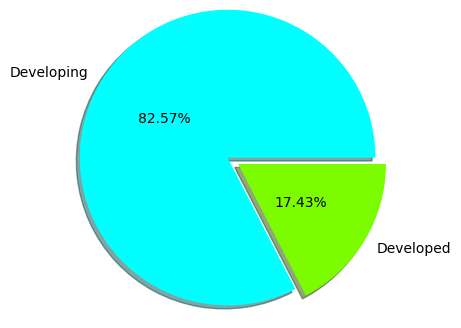

In [10]:
labels = df.Status.value_counts().keys()
values = df.Status.value_counts().values

plt.figure(figsize=(7,4))
plt.pie(values,labels=labels,explode=(0.1,0),shadow=True,autopct='%1.2f%%',pctdistance=0.5,radius=1.2,colors=['aqua','lawngreen'])
plt.show();

A significant number of nations are developing with just over 17% countries being developed.

Skewness of Year: -0.0064090273593942005
Kurtosis of Year: -1.2137217117396855


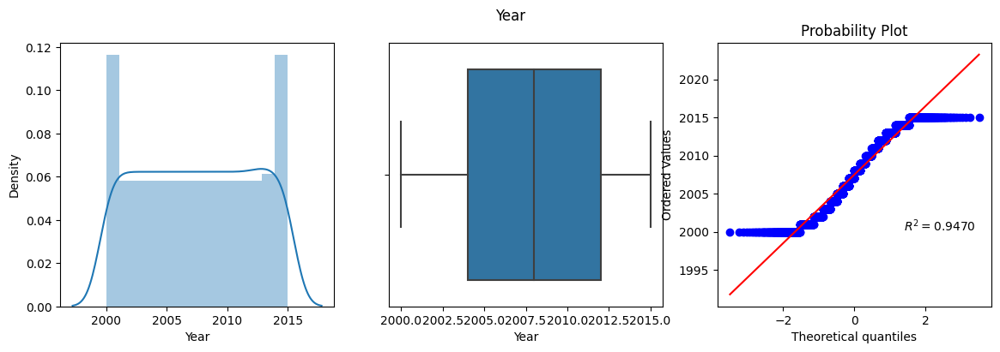

Skewness of Life Expectancy: -0.6386047358773552
Kurtosis of Life Expectancy: -0.23447739417967428


posx and posy should be finite values
posx and posy should be finite values


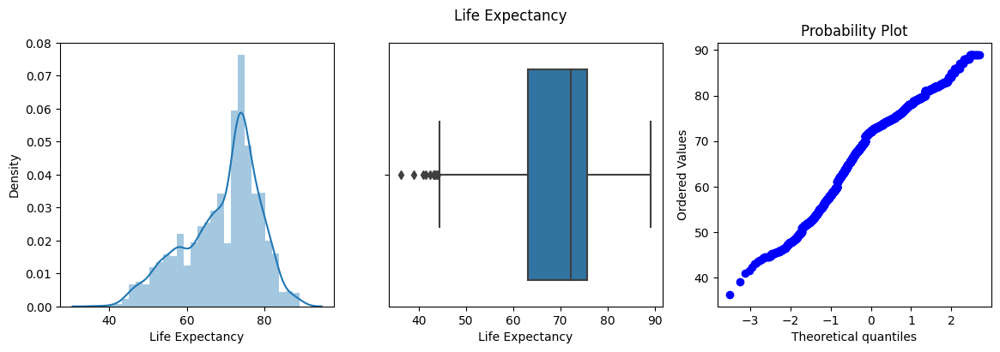

Skewness of Adult Mortality: 1.1743694876948636
Kurtosis of Adult Mortality: 1.7488602082178155


posx and posy should be finite values
posx and posy should be finite values


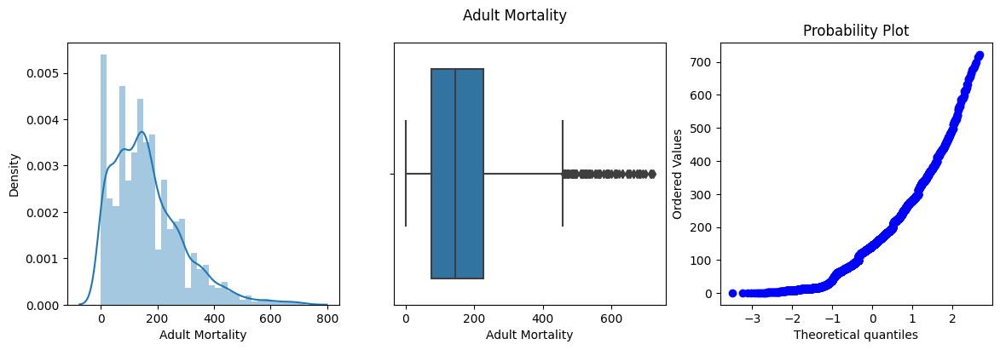

Skewness of Infant Deaths: 9.786962950426057
Kurtosis of Infant Deaths: 116.04275614693887


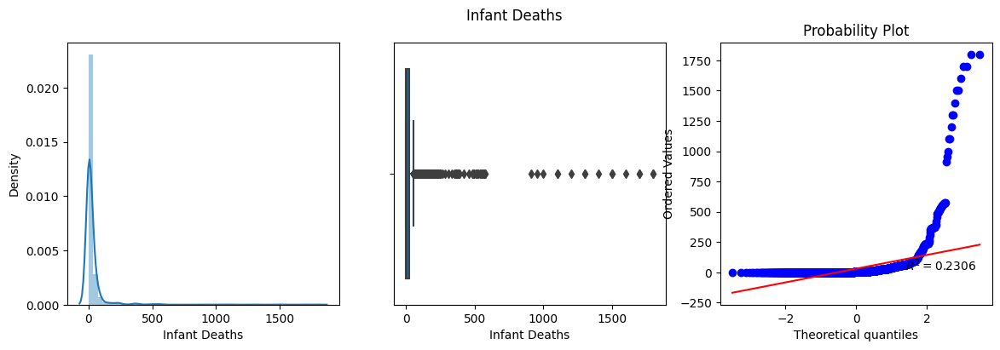

Skewness of Alcohol: 0.5895625281160799
Kurtosis of Alcohol: -0.8029092244433906


posx and posy should be finite values
posx and posy should be finite values


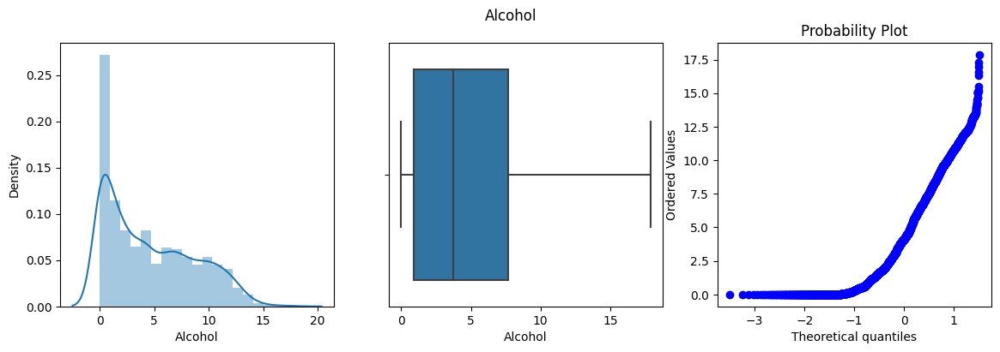

Skewness of Percentage Expenditure: 4.6520513478350605
Kurtosis of Percentage Expenditure: 26.573387390812936


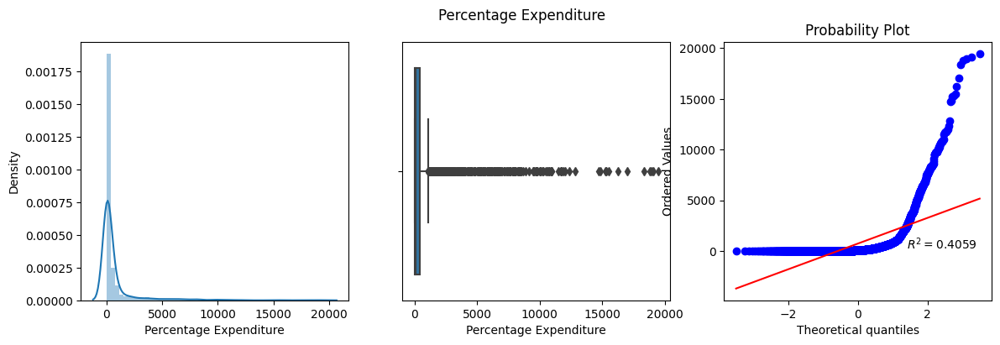

Skewness of Hepatitis B: -1.9308451037678318
Kurtosis of Hepatitis B: 2.77025939869103


posx and posy should be finite values
posx and posy should be finite values


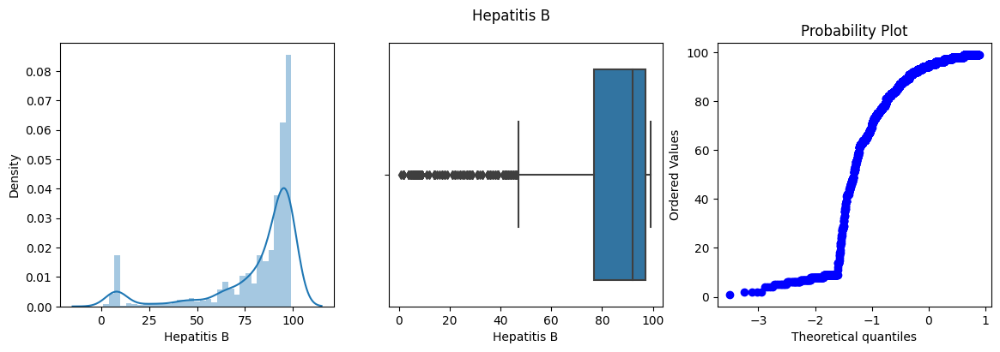

Skewness of Measles: 9.441331947061583
Kurtosis of Measles: 114.85990316352131


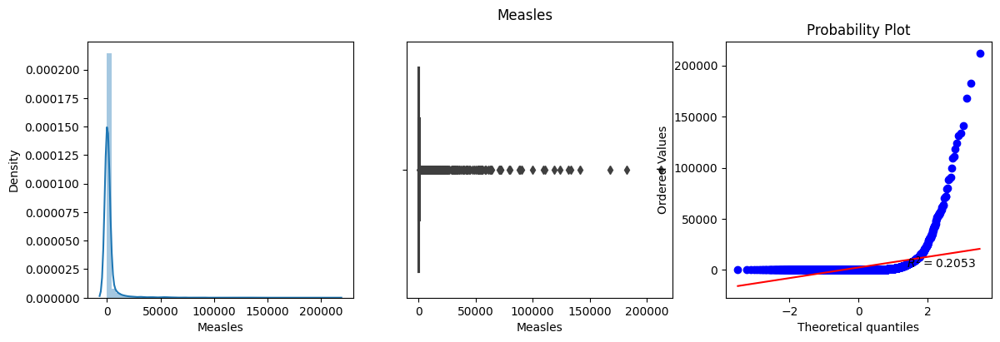

Skewness of BMI: -0.219311603419775
Kurtosis of BMI: -1.2910954677664324


posx and posy should be finite values
posx and posy should be finite values


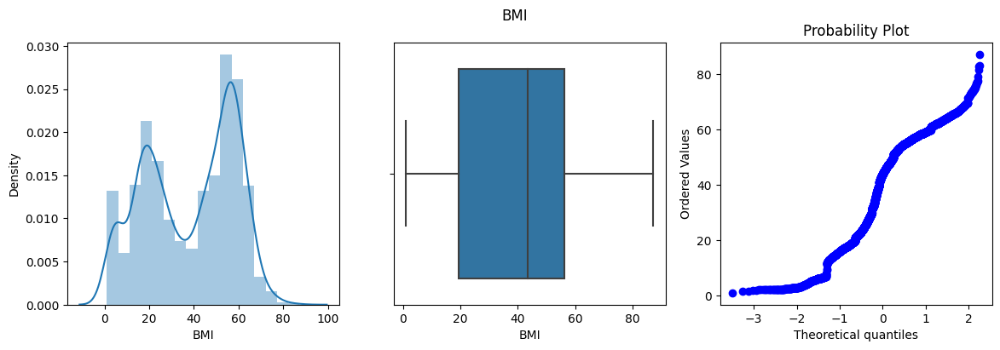

Skewness of Under-Five Deaths: 9.495064656961773
Kurtosis of Under-Five Deaths: 109.75279512408747


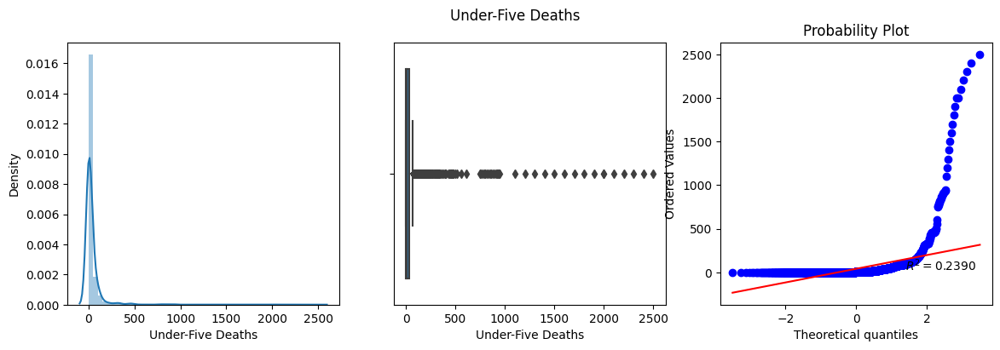

Skewness of Polio: -2.0980532489729056
Kurtosis of Polio: 3.776509818530341


posx and posy should be finite values
posx and posy should be finite values


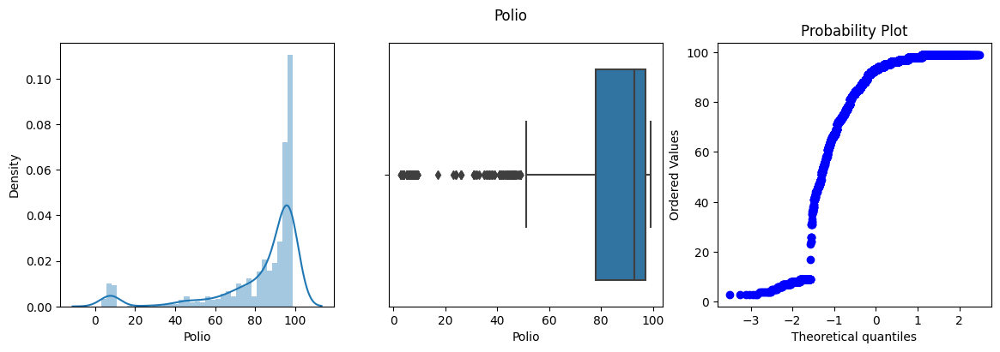

Skewness of Total Expenditure: 0.6186855520639749
Kurtosis of Total Expenditure: 1.1562704692070507


posx and posy should be finite values
posx and posy should be finite values


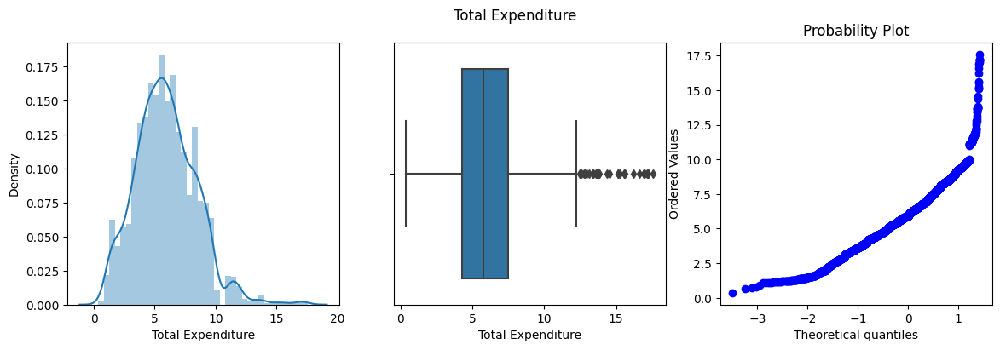

Skewness of Diphtheria: -2.0727529292965605
Kurtosis of Diphtheria: 3.558143000143282


posx and posy should be finite values
posx and posy should be finite values


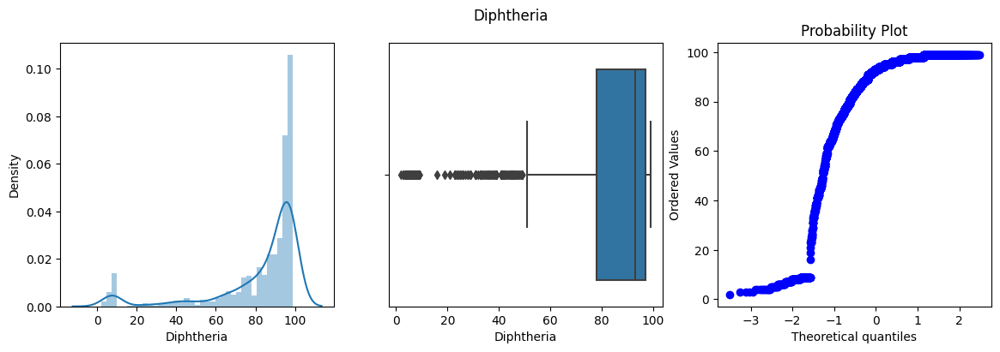

Skewness of HIV/AIDS: 5.396112042126371
Kurtosis of HIV/AIDS: 34.892007872835045


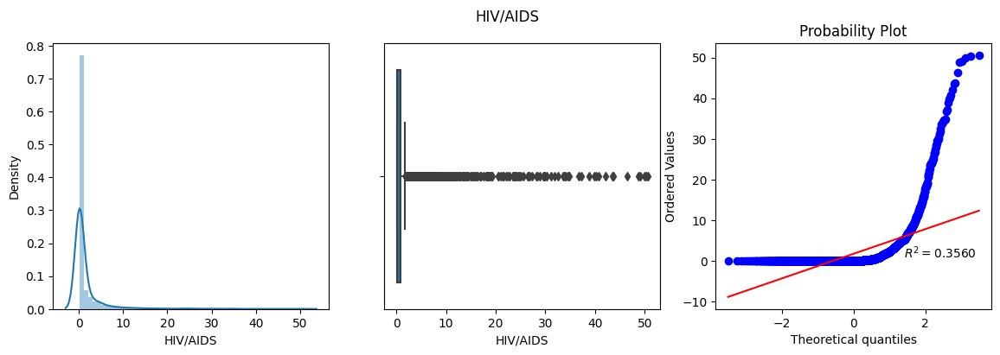

Skewness of GDP: 3.2066548698696393
Kurtosis of GDP: 12.33307363671508


posx and posy should be finite values
posx and posy should be finite values


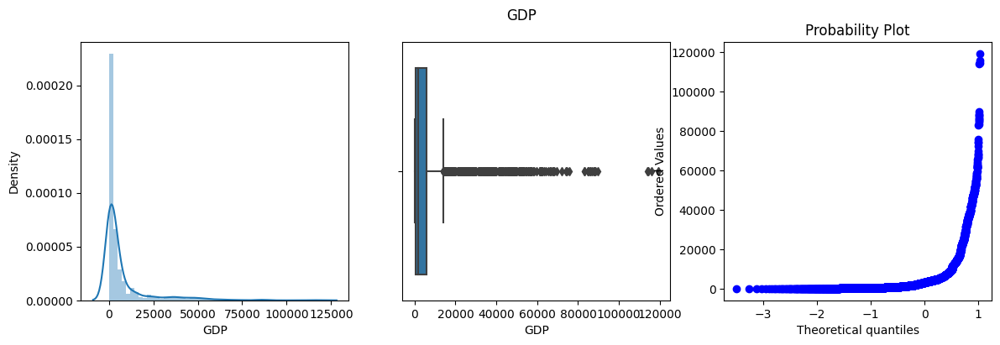

Skewness of Population: 15.916235598428203
Kurtosis of Population: 298.0102666341128


posx and posy should be finite values
posx and posy should be finite values


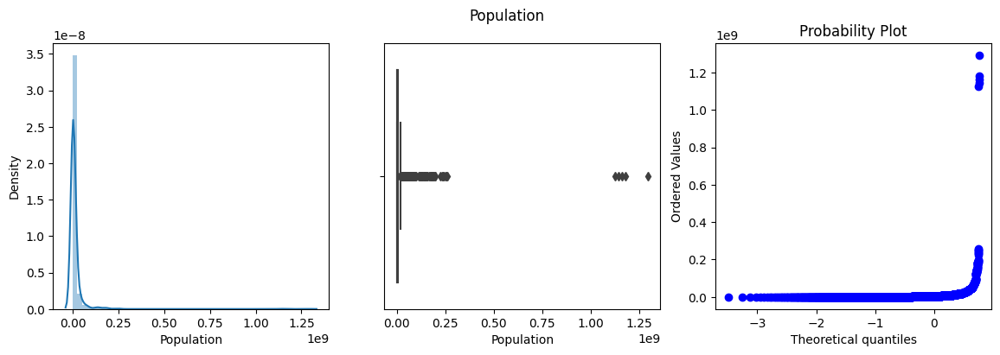

Skewness of Thinness 1-19 Years: 1.7114710881233637
Kurtosis of Thinness 1-19 Years: 3.970438670046728


posx and posy should be finite values
posx and posy should be finite values


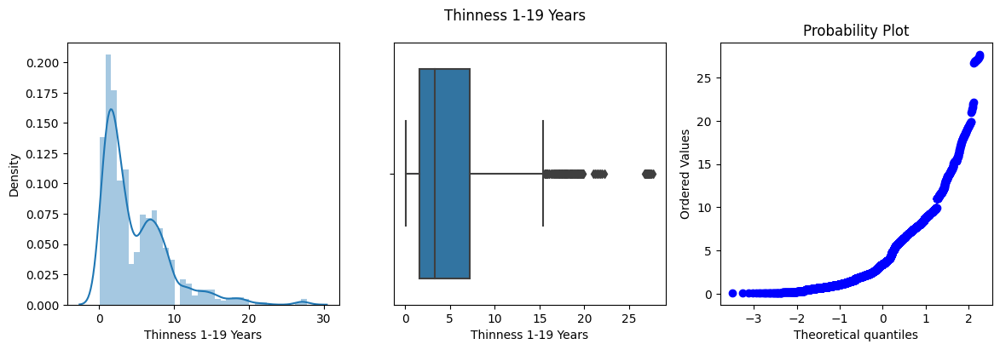

Skewness of Thinness 5-9 Years: 1.777423977376571
Kurtosis of Thinness 5-9 Years: 4.3587303420468295


posx and posy should be finite values
posx and posy should be finite values


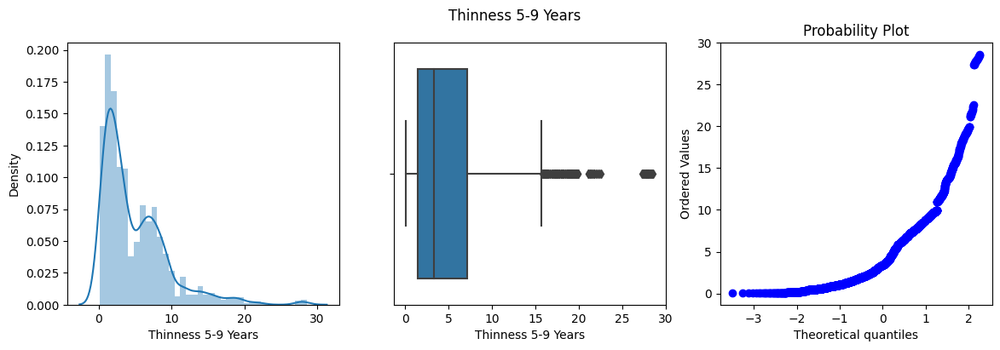

Skewness of Income Composition of Resources: -1.143762720185521
Kurtosis of Income Composition of Resources: 1.3928142386325635


posx and posy should be finite values
posx and posy should be finite values


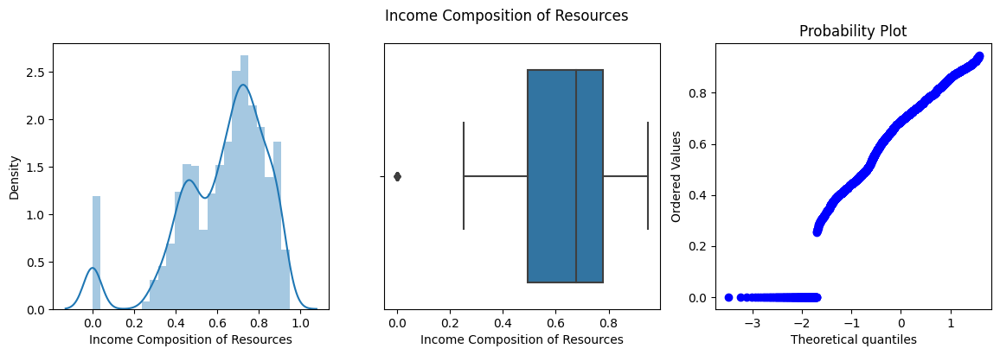

Skewness of Schooling: -0.6024365418785147
Kurtosis of Schooling: 0.886151268906703


posx and posy should be finite values
posx and posy should be finite values


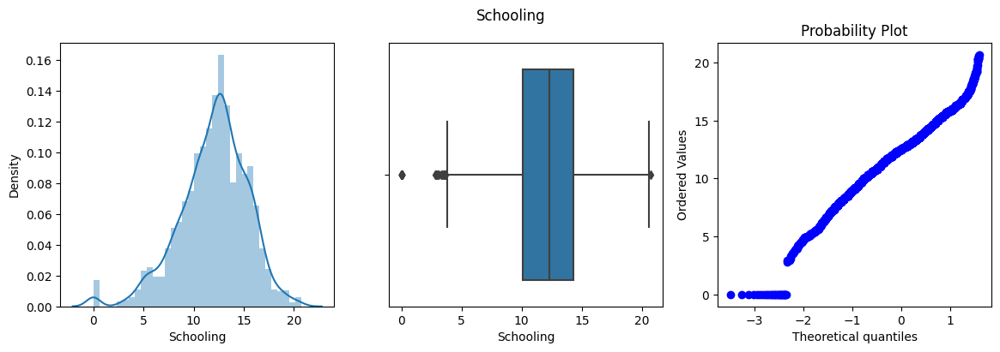

In [11]:
for col in df.select_dtypes(np.number).columns:
    print(f"Skewness of {col}:",df[col].skew())
    print(f"Kurtosis of {col}:",df[col].kurtosis())
    plt.figure(figsize=(14,4))
    plt.subplot(131)
    sns.distplot(df[col])
    plt.subplot(132)
    sns.boxplot(df[col])
    plt.subplot(133)
    probplot(df[col],plot=plt,dist='norm',rvalue=True)
    plt.suptitle(col)
    plt.show()
    gc.collect();

In [12]:
skewed_cols = ['Life Expectancy','Adult Mortality','Infant Deaths','Percentage Expenditure','Hepatitis B','Measles','Under-Five Deaths','Polio','Total Expenditure','Diphtheria','HIV/AIDS','GDP','Population','Thinness 1-19 Years','Thinness 5-9 Years','Income Composition of Resources','Schooling']
skewed_cols

['Life Expectancy',
 'Adult Mortality',
 'Infant Deaths',
 'Percentage Expenditure',
 'Hepatitis B',
 'Measles',
 'Under-Five Deaths',
 'Polio',
 'Total Expenditure',
 'Diphtheria',
 'HIV/AIDS',
 'GDP',
 'Population',
 'Thinness 1-19 Years',
 'Thinness 5-9 Years',
 'Income Composition of Resources',
 'Schooling']

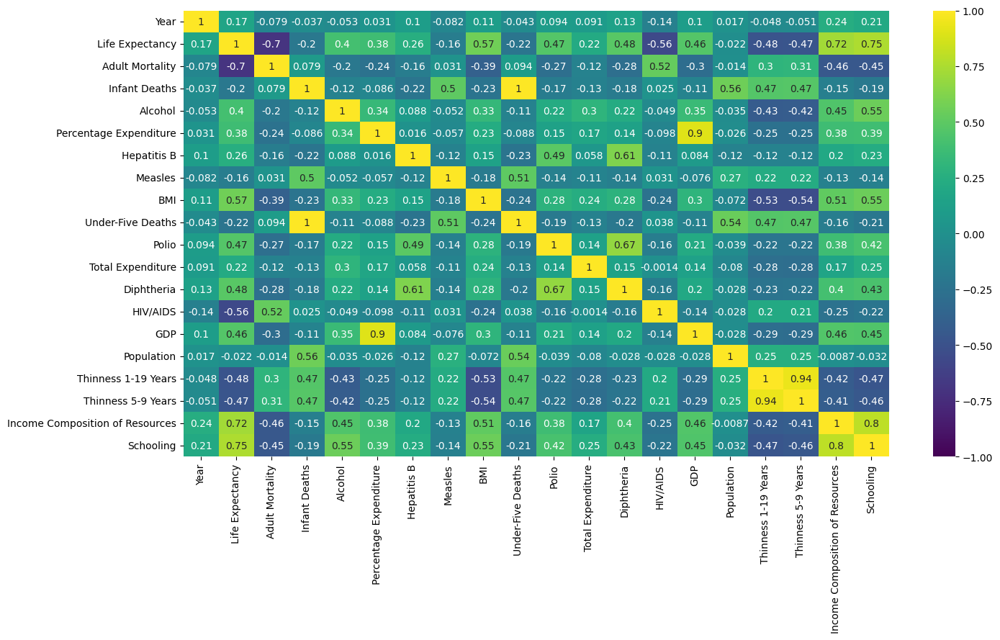

In [13]:
plt.figure(figsize=(15,9))
fig = sns.heatmap(df.corr(),annot=True,cmap='viridis',vmin=-1.0,vmax=1.0)
plt.tight_layout()
plt.show(fig)
plt.close('all')
del fig
gc.collect();

<Figure size 1500x900 with 0 Axes>

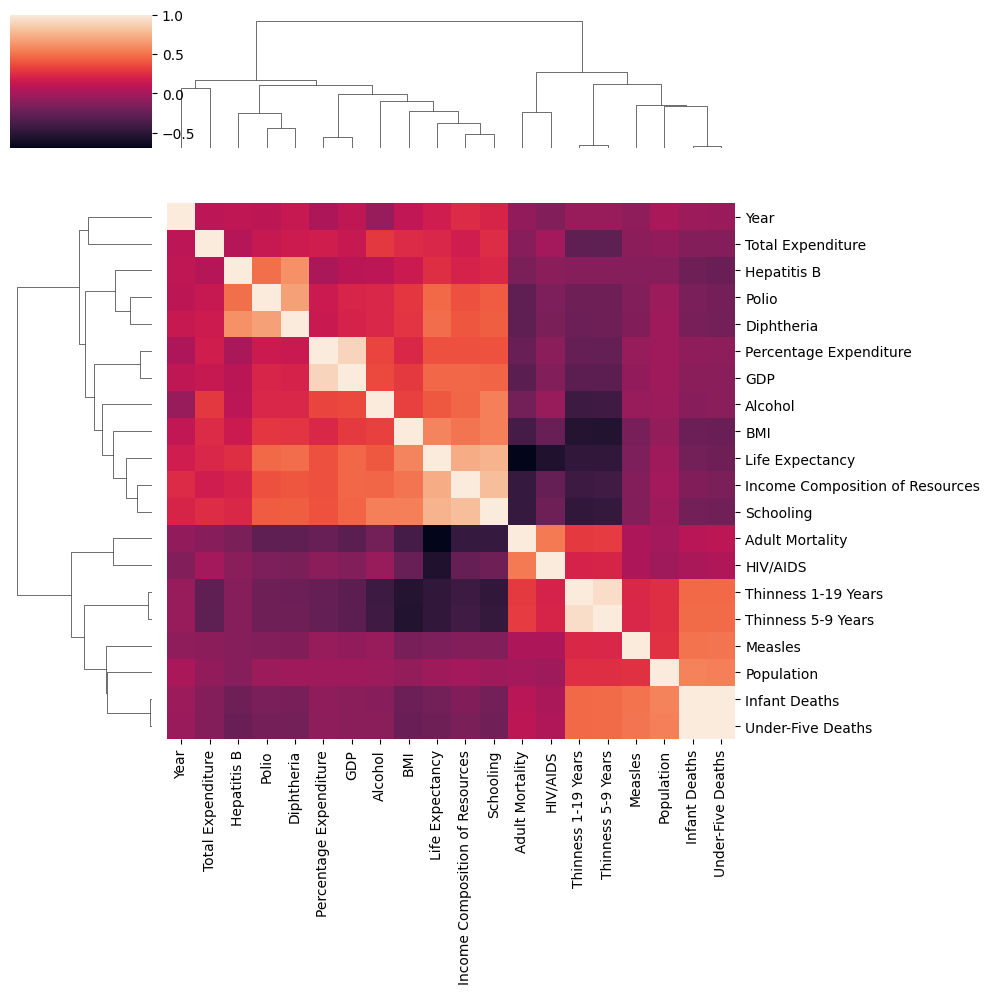

In [14]:
plt.figure(figsize=(15,9))
fig = sns.clustermap(df.corr())
plt.tight_layout()
plt.show(fig)
plt.close('all')
del fig
gc.collect();

<Figure size 1500x900 with 0 Axes>

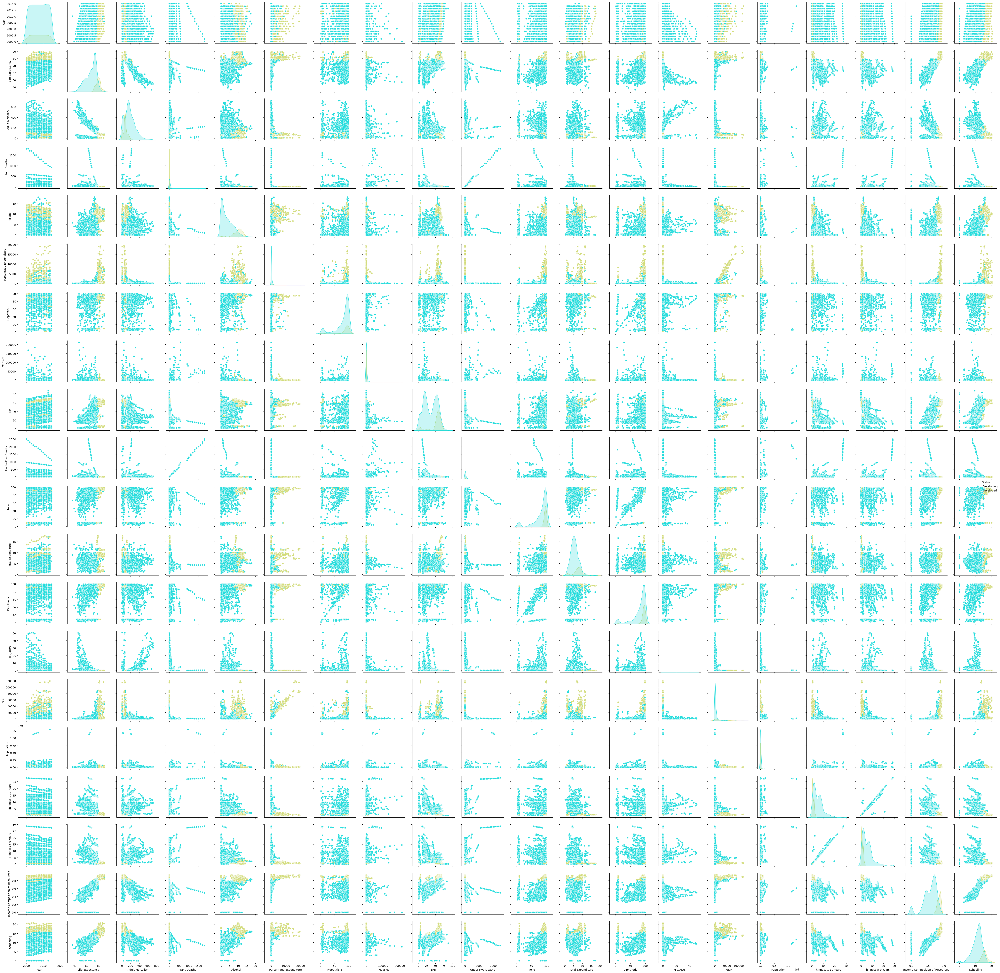

In [15]:
plt.figure(figsize=(15,9))
fig = sns.pairplot(df,hue='Status',palette='rainbow')
plt.tight_layout()
plt.show(fig)
plt.close('all')
del fig
gc.collect();

## Feature Engineering

### Missing Values Imputation

In [16]:
missing_val_cols = df.columns[df.isnull().any()]
imputer = KNNImputer()

for col in missing_val_cols:
    df[col] = imputer.fit_transform(df[[col]])

In [17]:
df.isna().sum()

Country                            0
Year                               0
Status                             0
Life Expectancy                    0
Adult Mortality                    0
Infant Deaths                      0
Alcohol                            0
Percentage Expenditure             0
Hepatitis B                        0
Measles                            0
BMI                                0
Under-Five Deaths                  0
Polio                              0
Total Expenditure                  0
Diphtheria                         0
HIV/AIDS                           0
GDP                                0
Population                         0
Thinness 1-19 Years                0
Thinness 5-9 Years                 0
Income Composition of Resources    0
Schooling                          0
dtype: int64

### Feature Transformation

In [18]:
def apply_transform(transformer,col):
    plt.figure(figsize=(14,4))
    plt.subplot(131)
    sns.distplot(df[col])
    plt.subplot(132)
    sns.boxplot(df[col])
    plt.subplot(133)
    probplot(df[col],rvalue=True,dist='norm',plot=plt)
    plt.suptitle(f"{col} Before Transform")
    plt.show()
    col_tf = transformer.fit_transform(df[[col]])
    col_tf = np.array(col_tf).reshape(col_tf.shape[0])
    plt.figure(figsize=(14,4))
    plt.subplot(131)
    sns.distplot(col_tf)
    plt.subplot(132)
    sns.boxplot(col_tf)
    plt.subplot(133)
    probplot(col_tf,rvalue=True,dist='norm',plot=plt)
    plt.suptitle(f"{col} After Transform")
    plt.show()
    gc.collect();

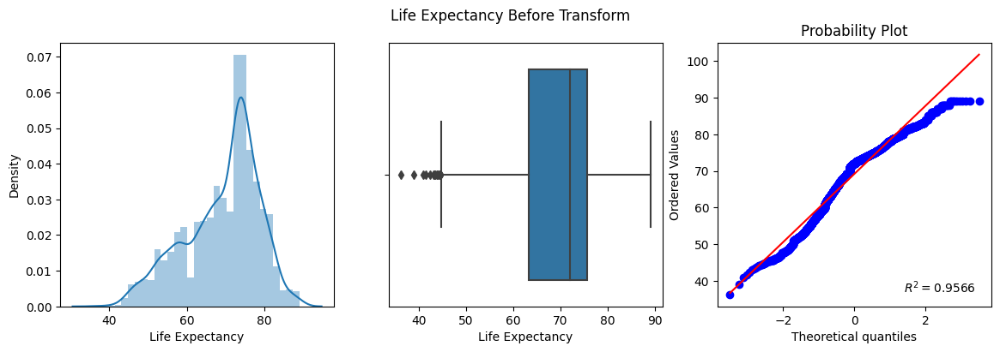

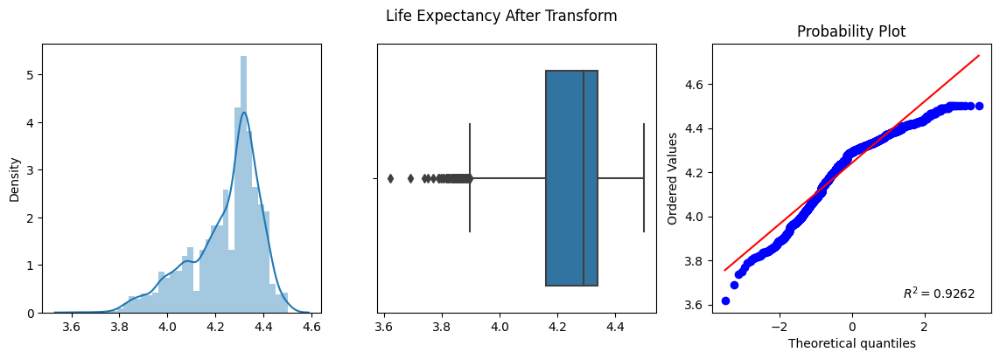

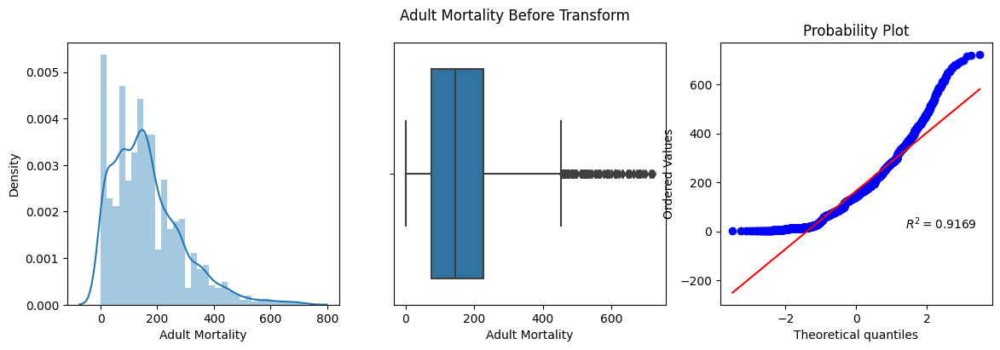

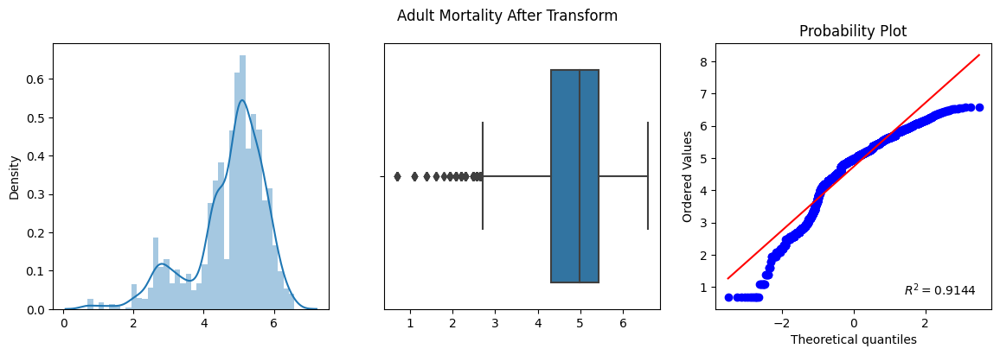

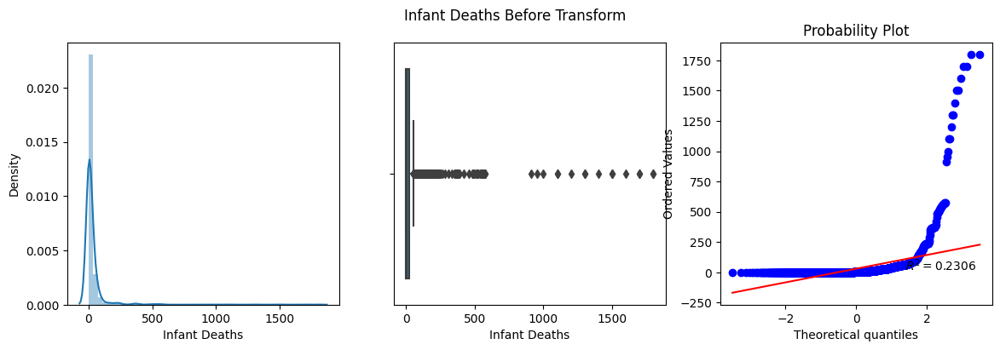

...

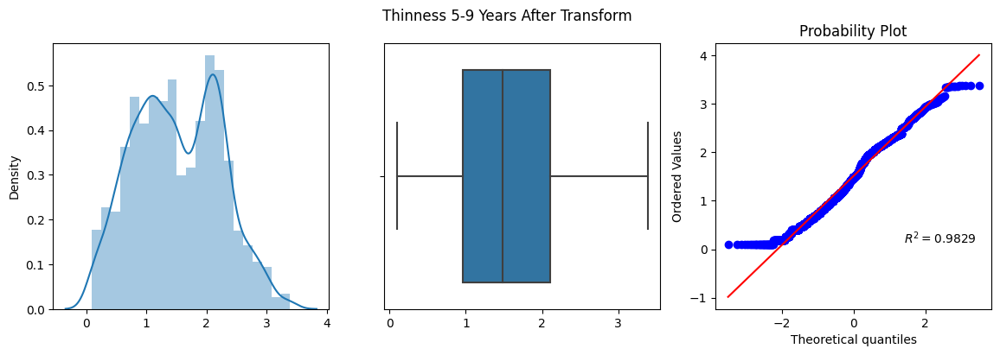

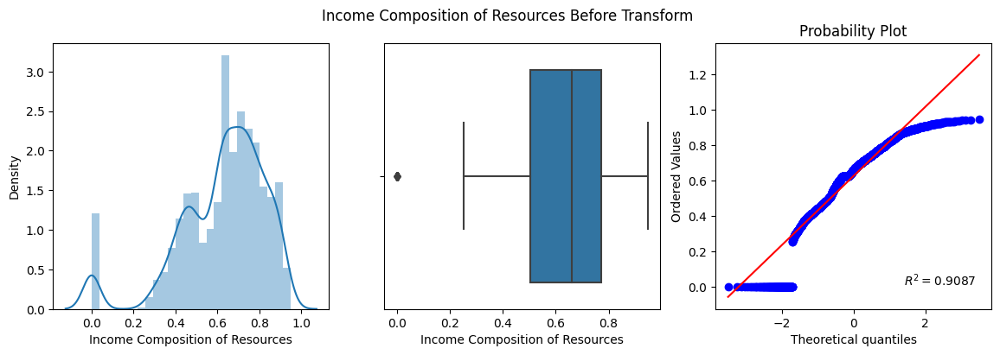

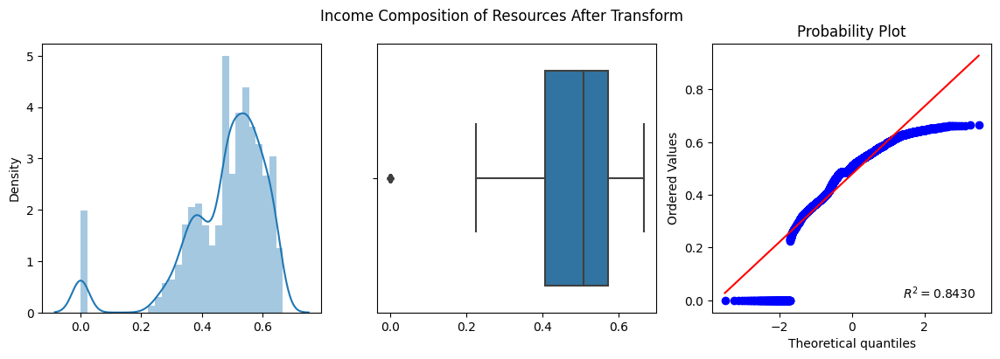

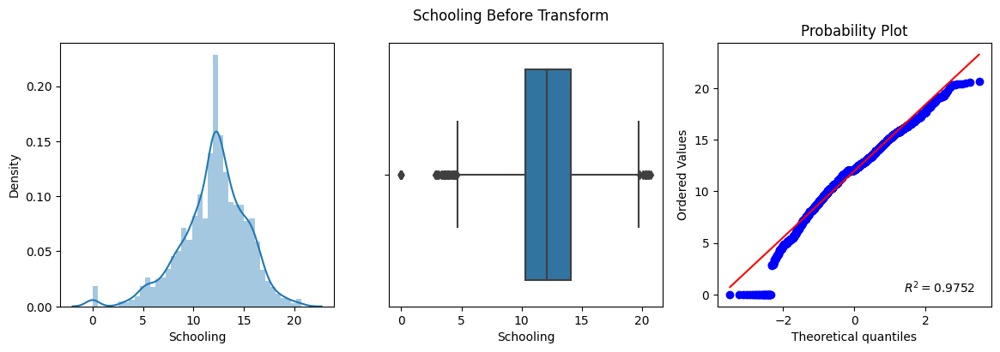

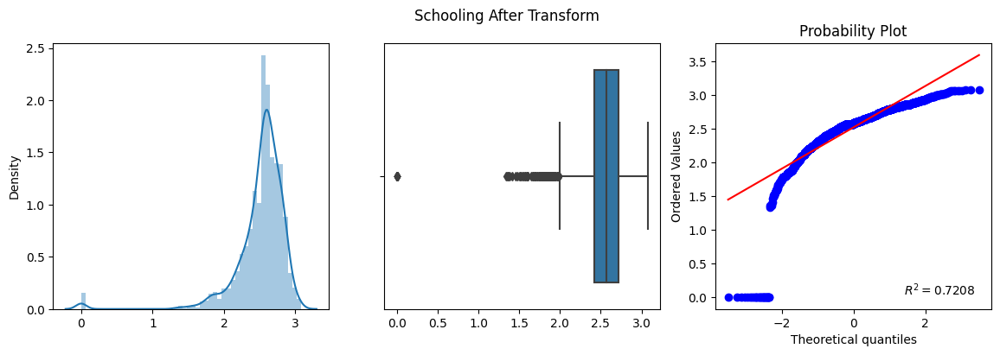

In [19]:
# Log Transform
for col in skewed_cols:
    apply_transform(FunctionTransformer(np.log1p),col)

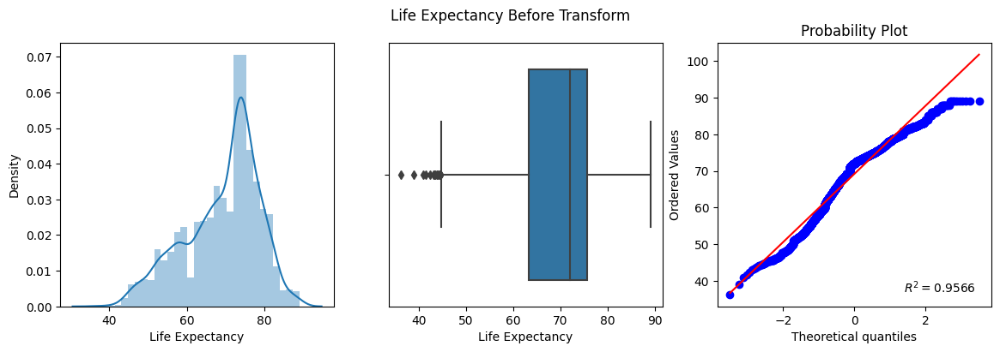

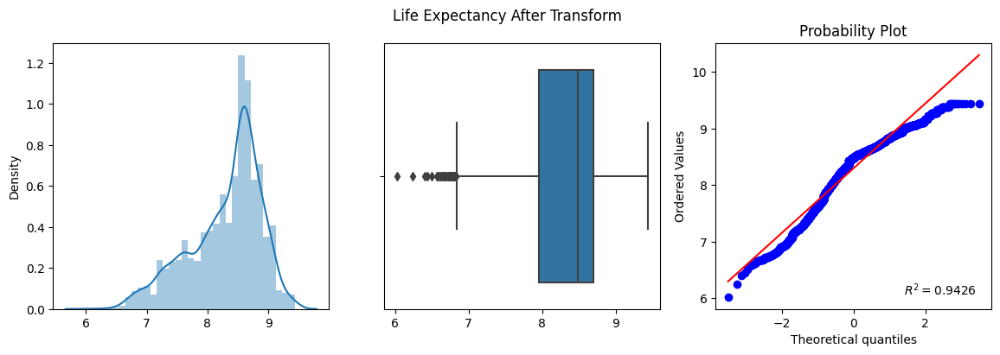

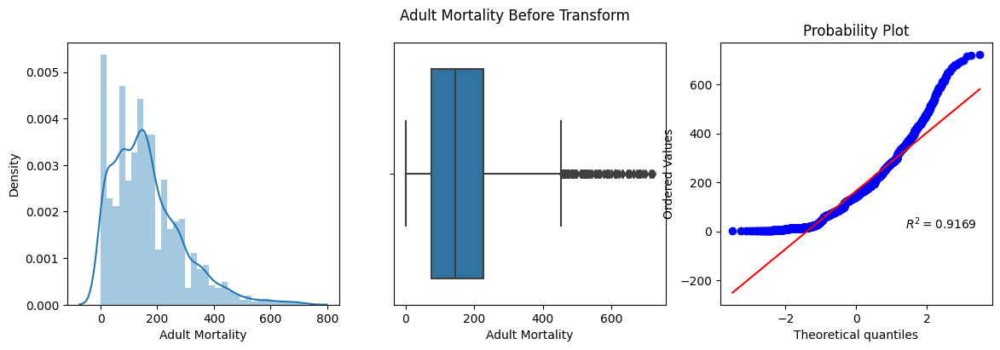

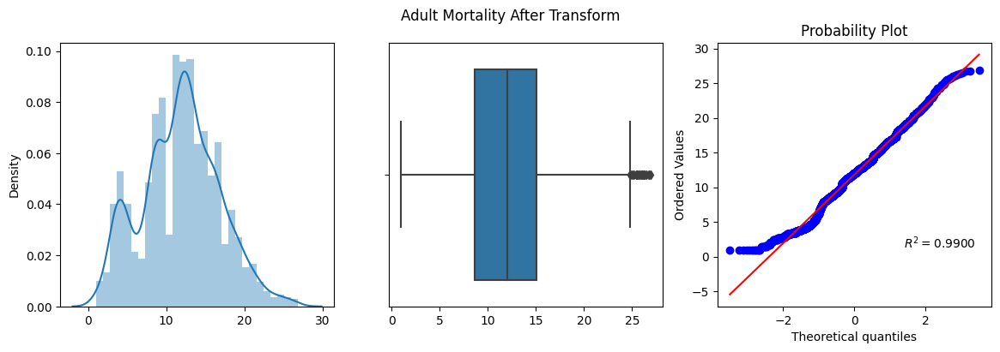

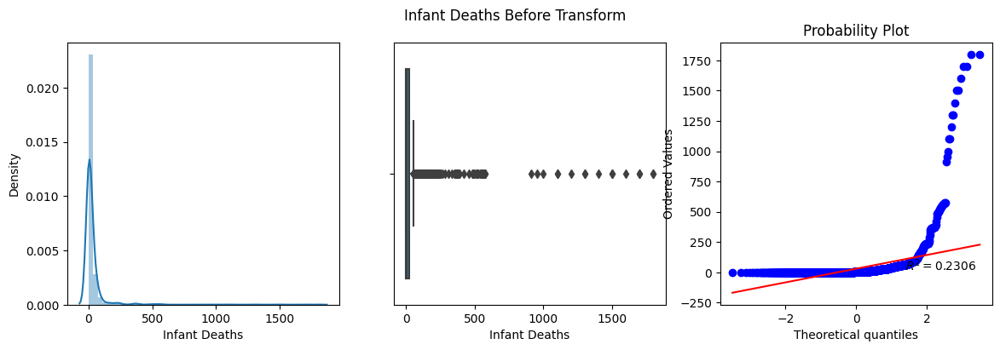

...

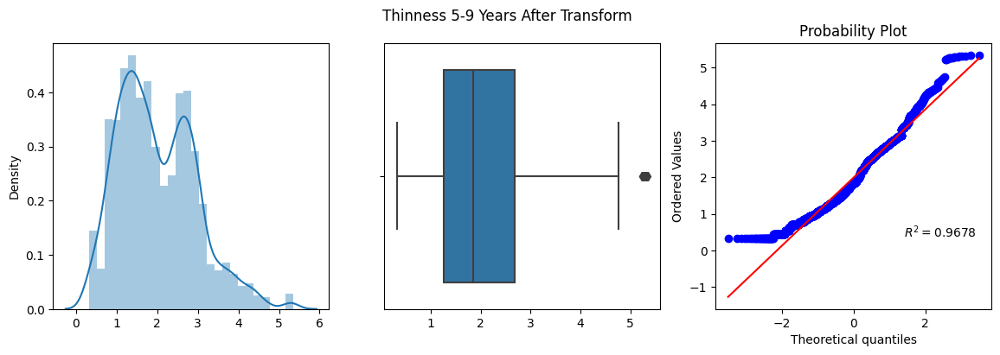

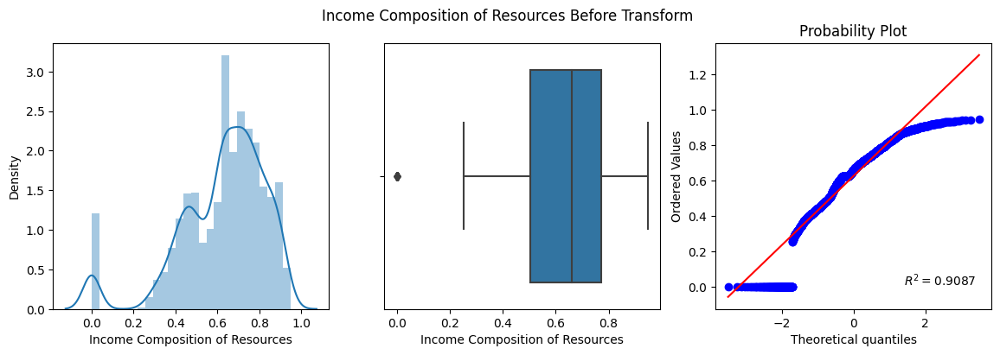

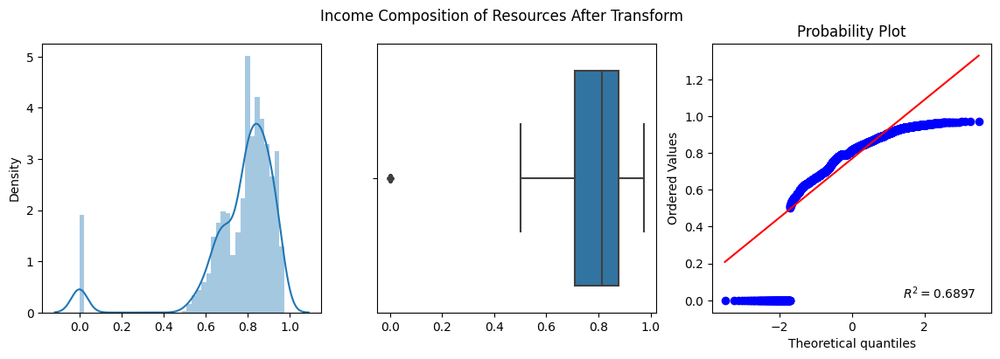

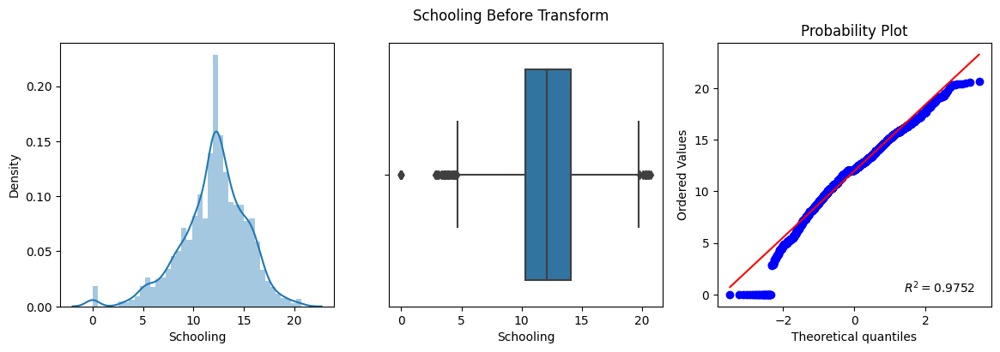

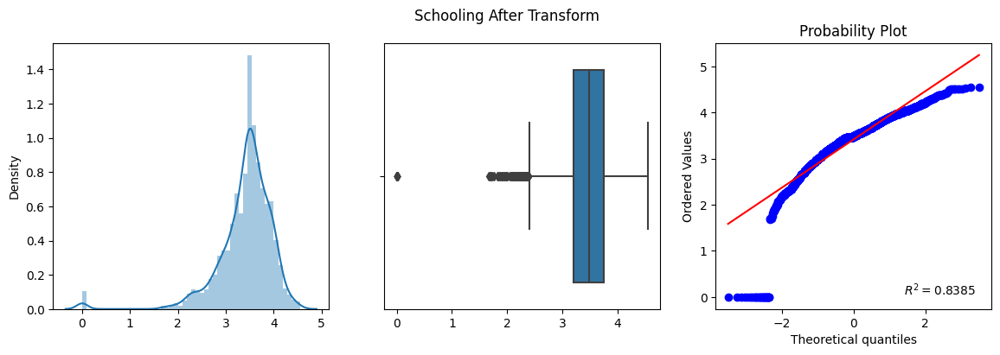

In [20]:
# Square Root Transform
for col in skewed_cols:
    apply_transform(FunctionTransformer(np.sqrt),col)

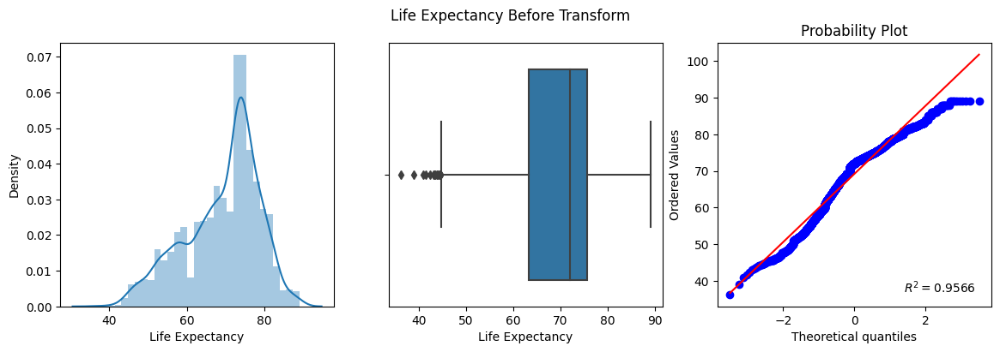

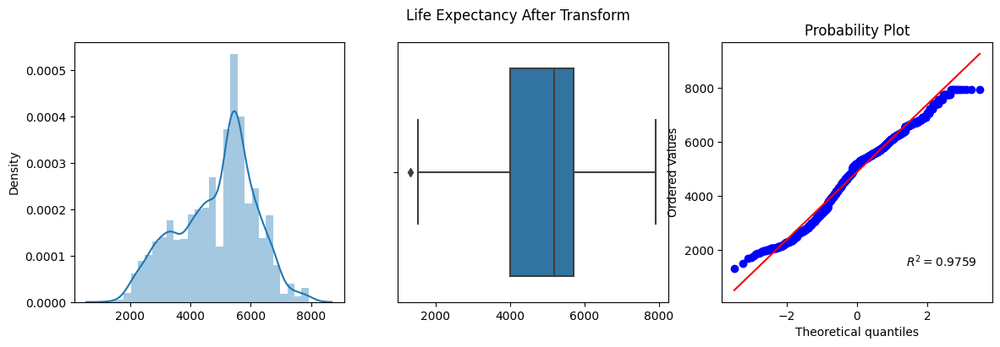

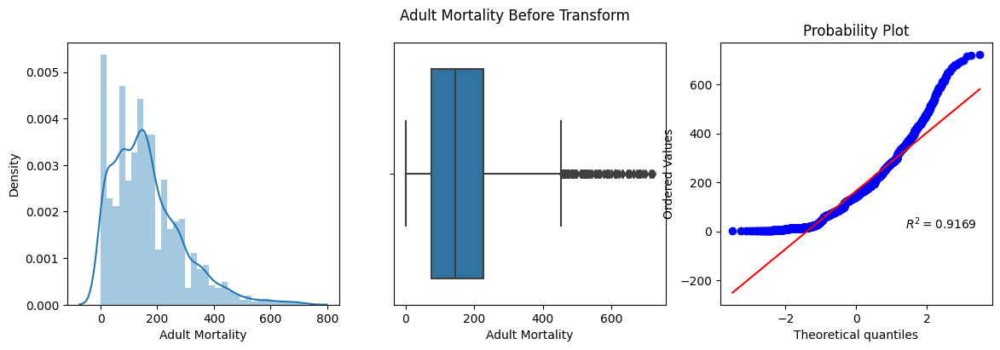

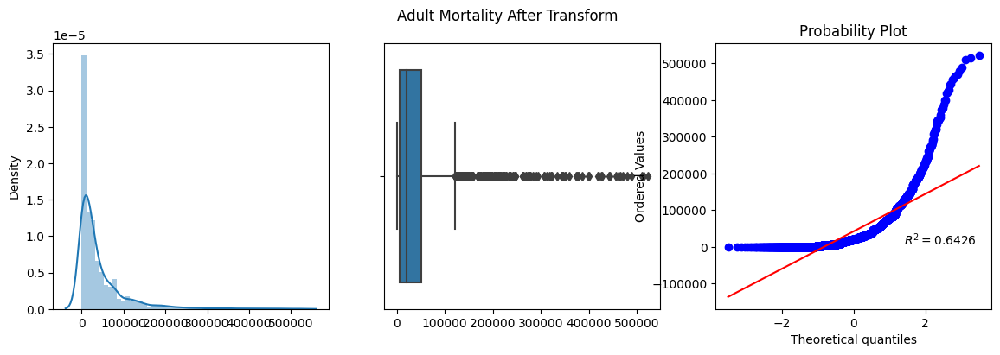

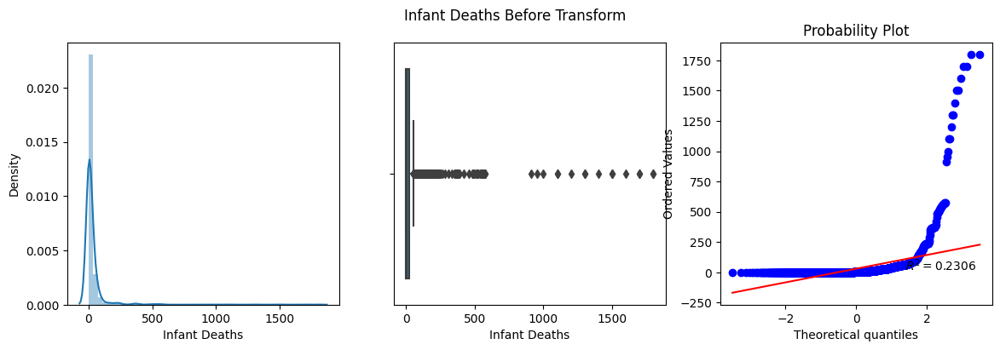

...

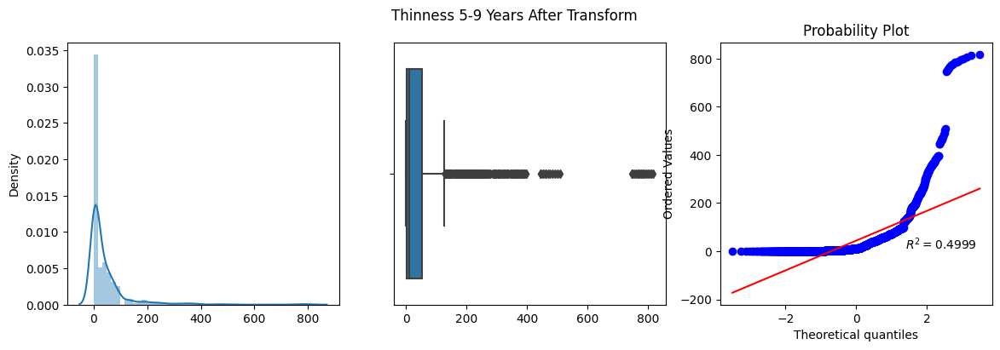

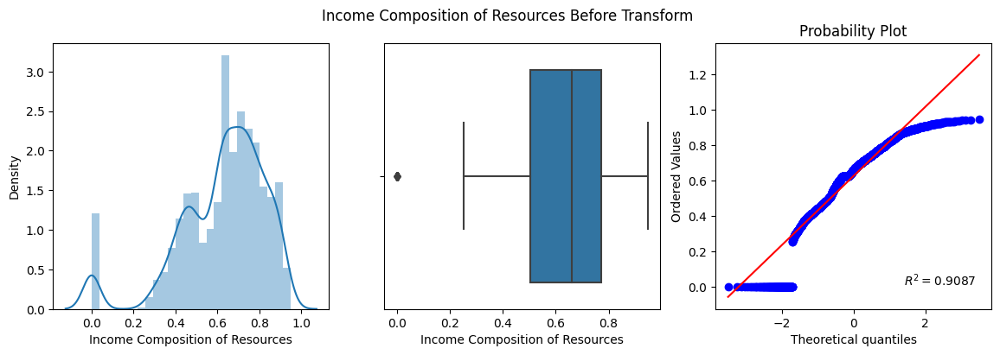

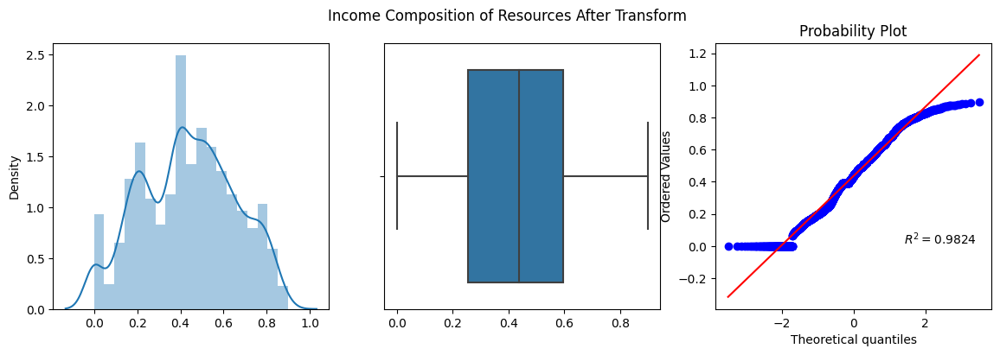

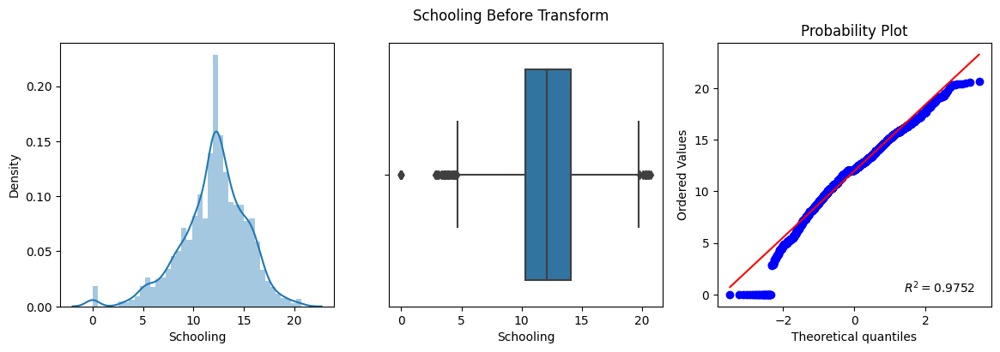

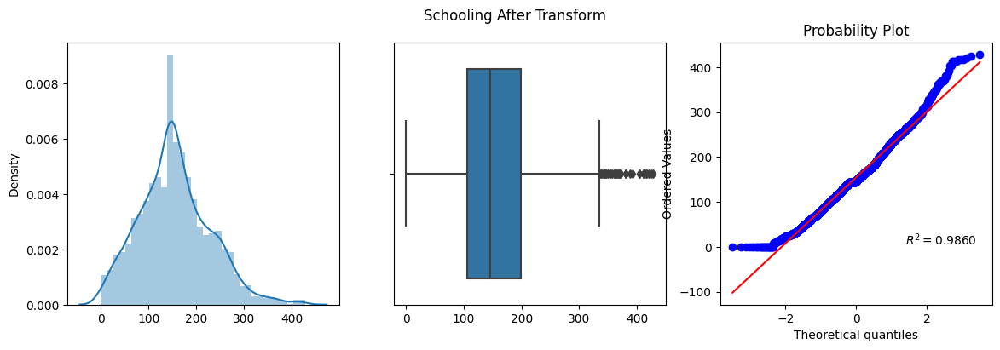

In [21]:
# Square Transform
for col in skewed_cols:
    apply_transform(FunctionTransformer(np.square),col)

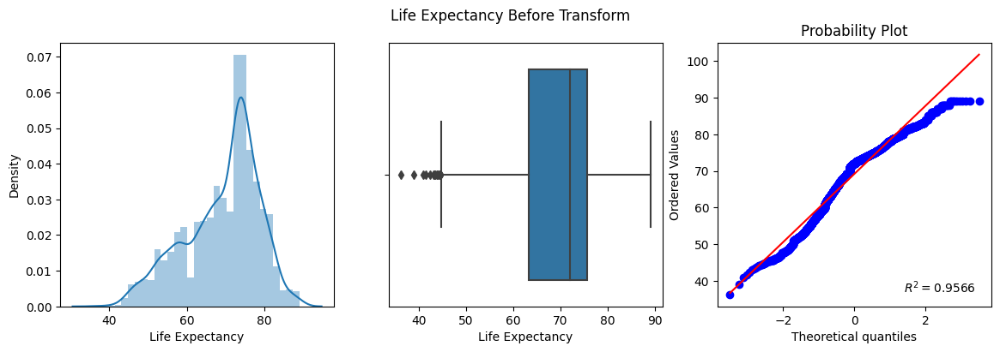

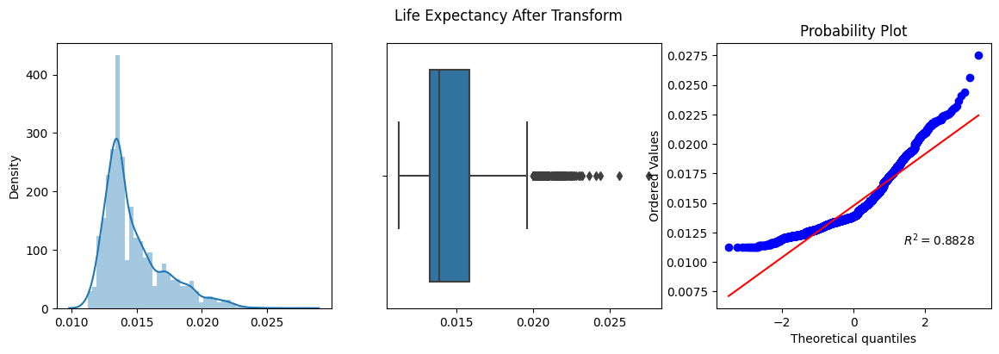

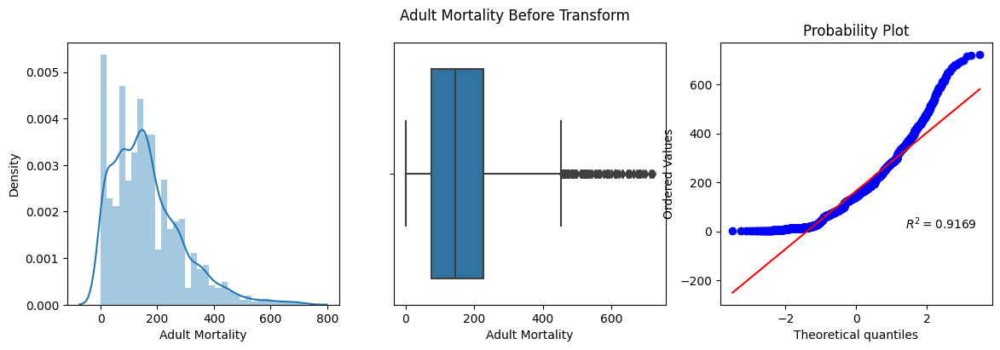

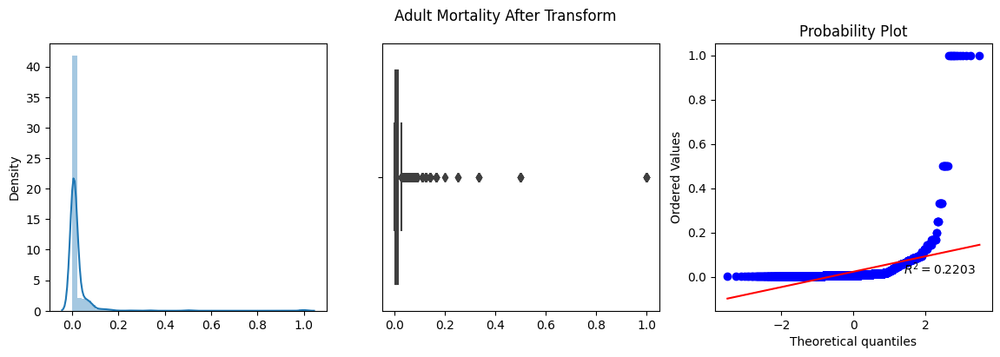

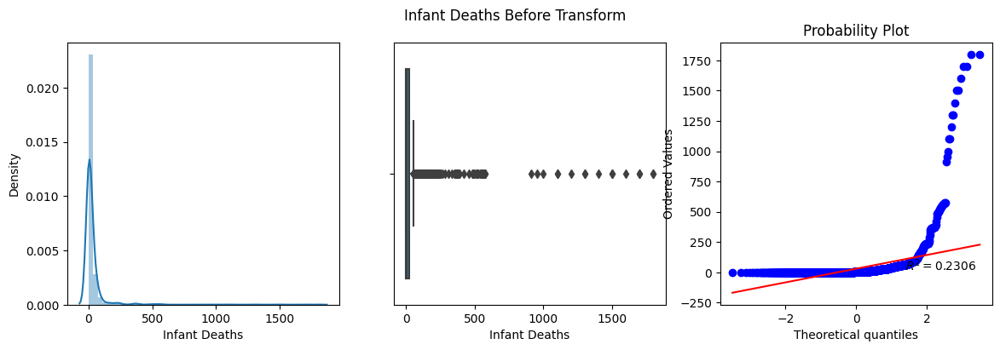

...

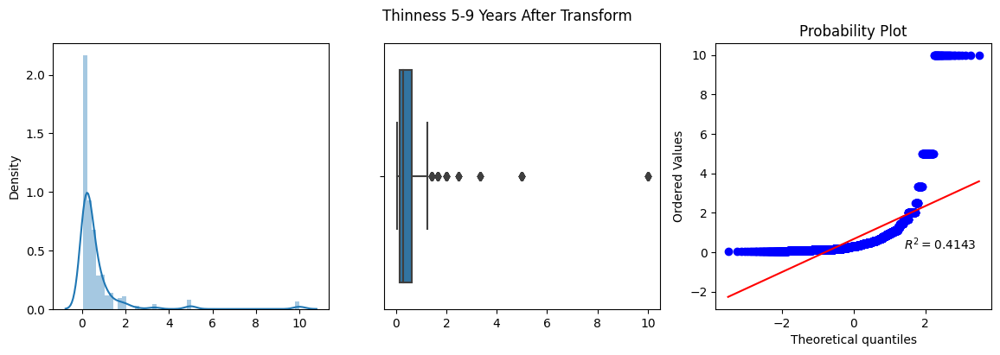

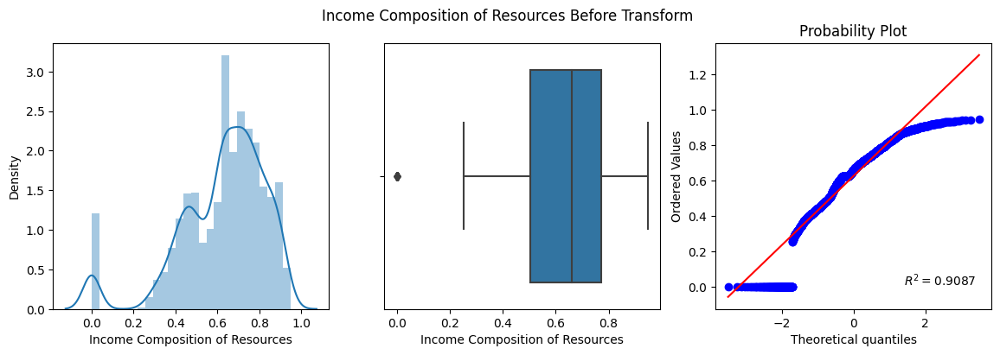

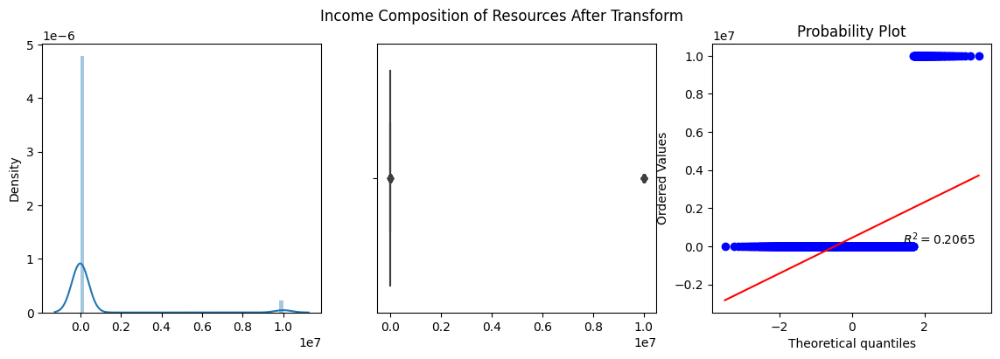

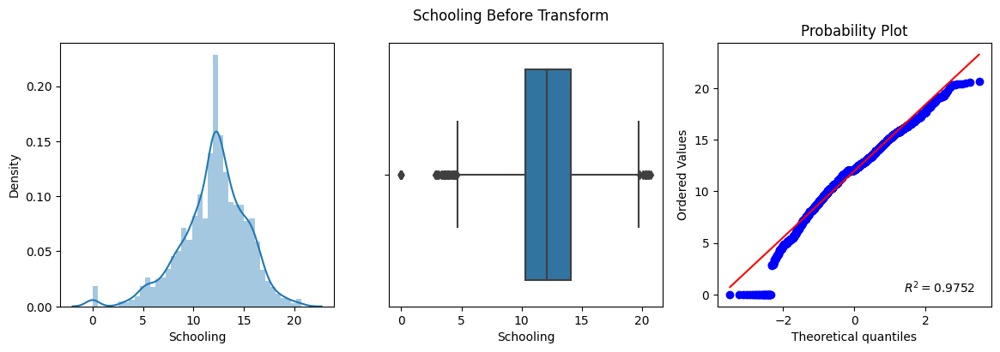

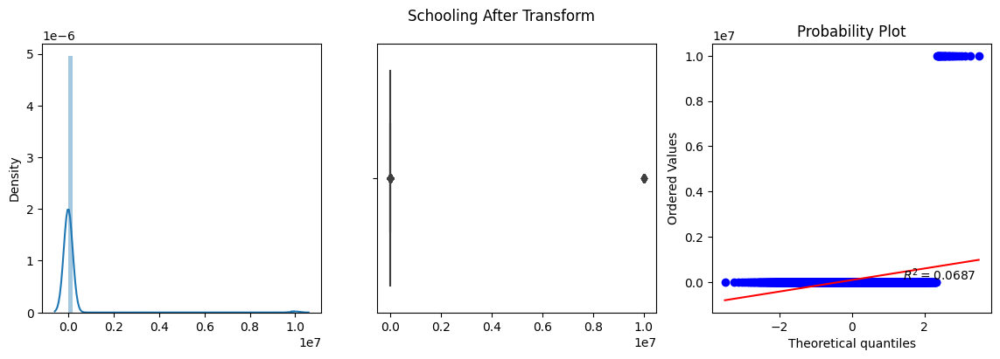

In [22]:
# Reciprocal Transform
for col in skewed_cols:
    apply_transform(FunctionTransformer(lambda x: 1/(x+0.0000001)),col)

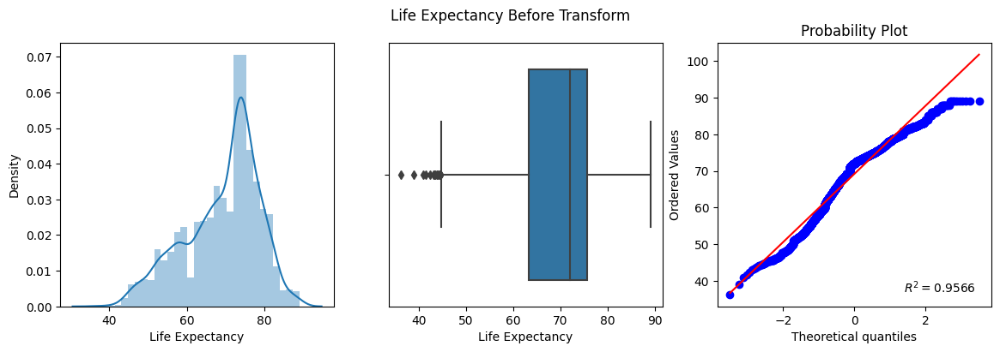

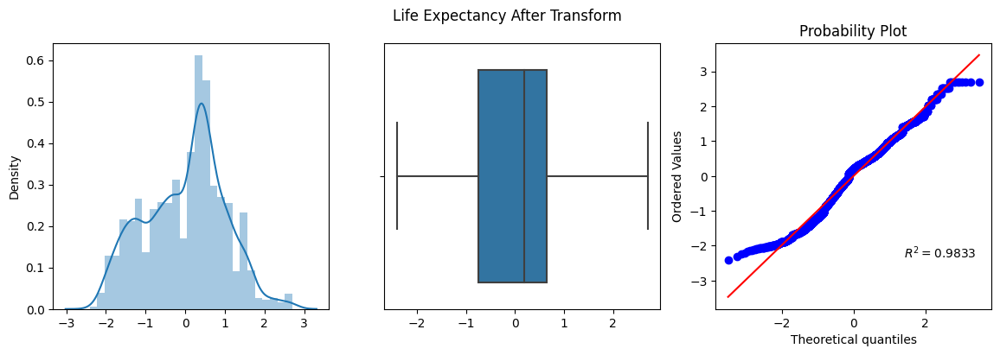

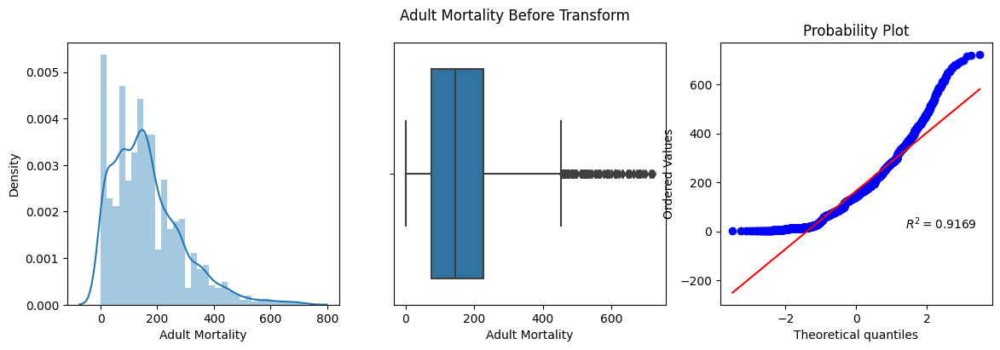

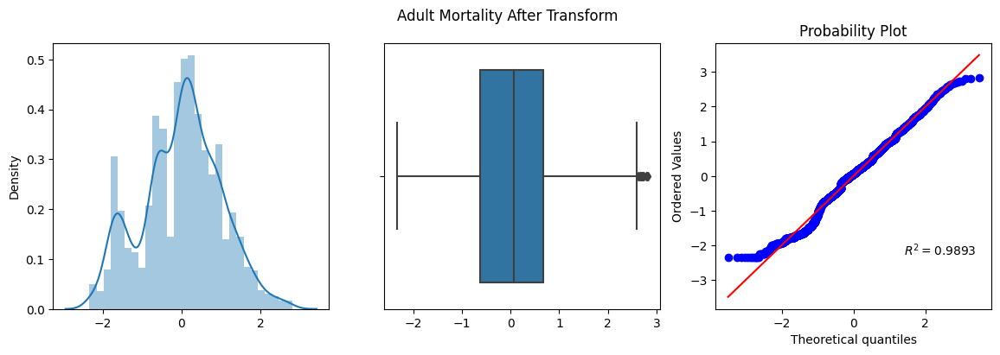

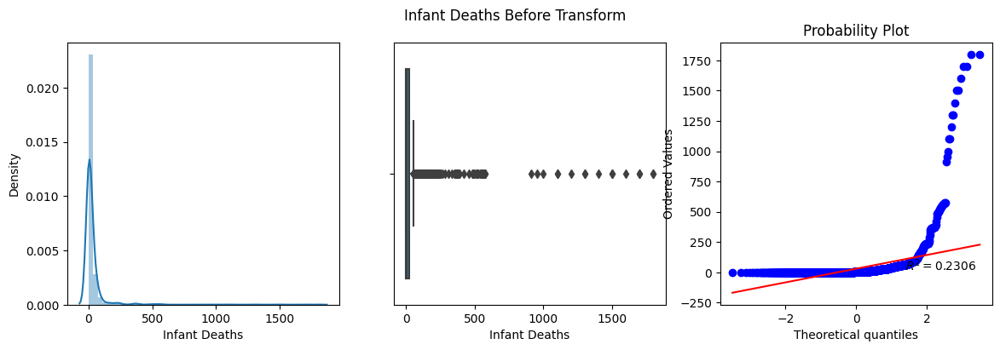

...

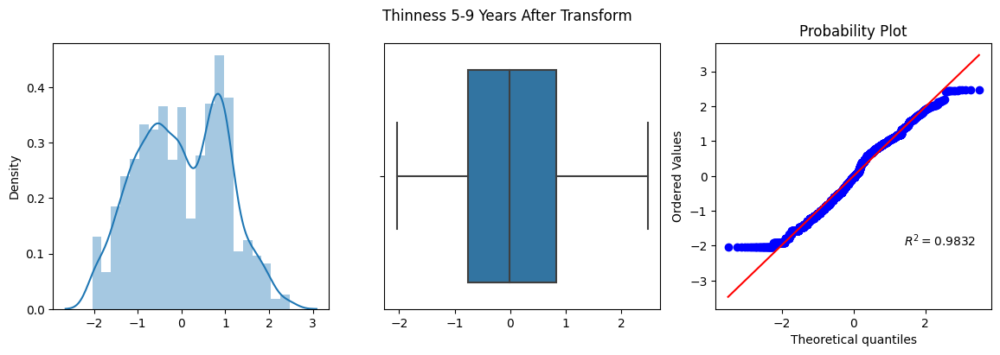

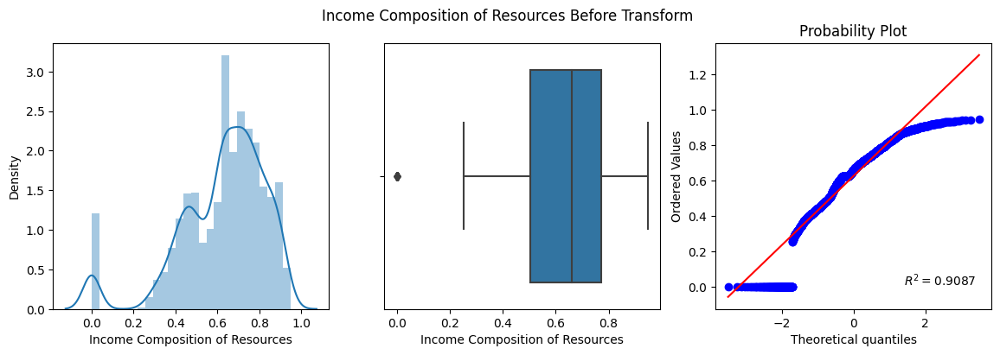

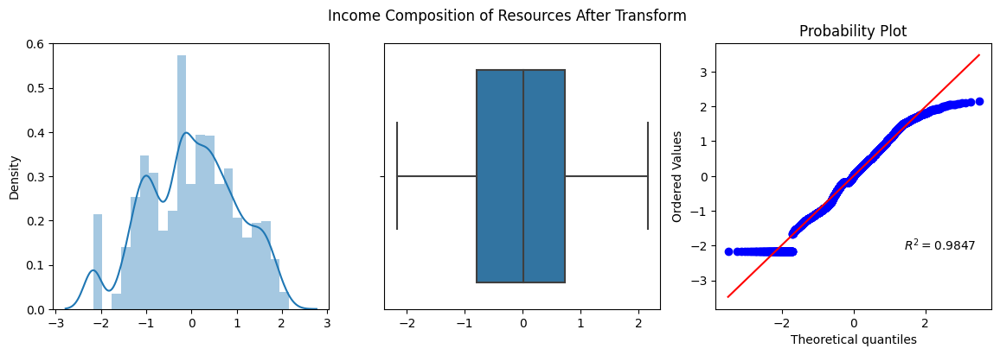

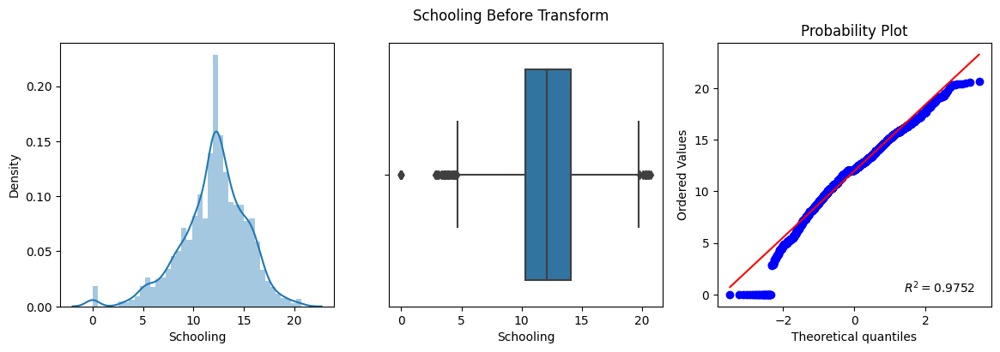

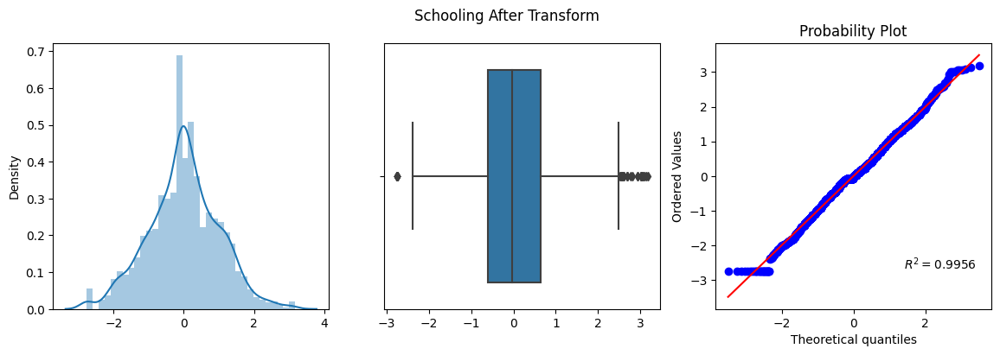

In [23]:
# Power Transform
for col in skewed_cols:
    apply_transform(PowerTransformer(),col)

Log Transform: Measles<br>
Square Transform: None <br>
Square Root Transform: None<br>
Reciprocal Transform: None <br>
Power Transform: Life Expectancy, Adult Mortality, Infant Deaths, Percentage Expenditure, Hepatitis B, Under-Five Deaths, Polio, Total Expenditure, Diphtheria, HIV/AIDS, GDP, Population, Thinness 1-19 Years, Thinness 5-9 Years, Schooling, Income Composition of Resources

### Outlier Treatment

In [24]:
def impute_outliers(data,col):
    winsorizer = Winsorizer(capping_method='iqr',fold=1.5,tail='both')
    fig = sns.boxplot(winsorizer.fit_transform(data[[col]]).values)
    plt.title(f"Box Plot of {col} after Outlier Removal")
    plt.show(fig)
    plt.close('all')
    del fig
    gc.collect()

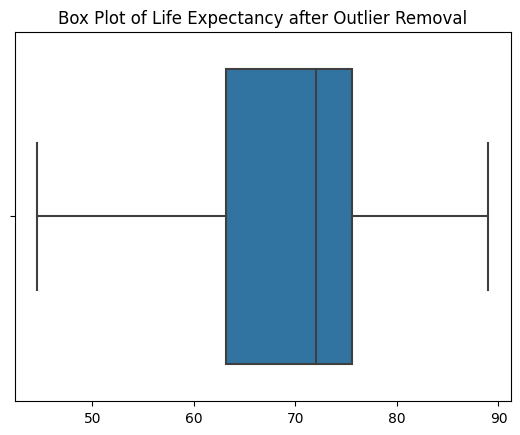

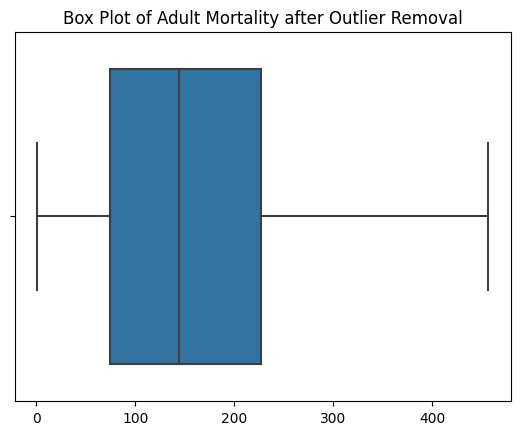

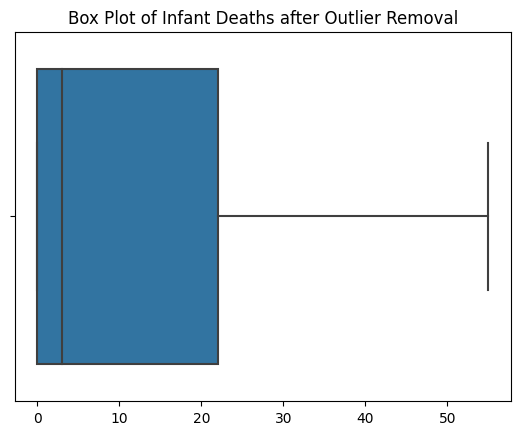

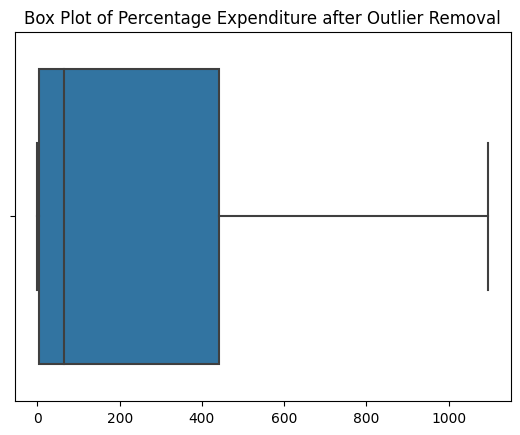

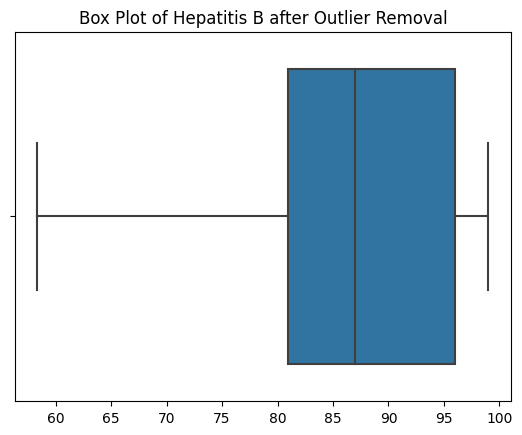

...

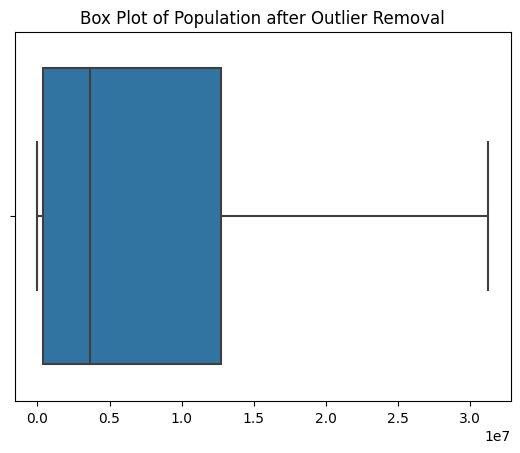

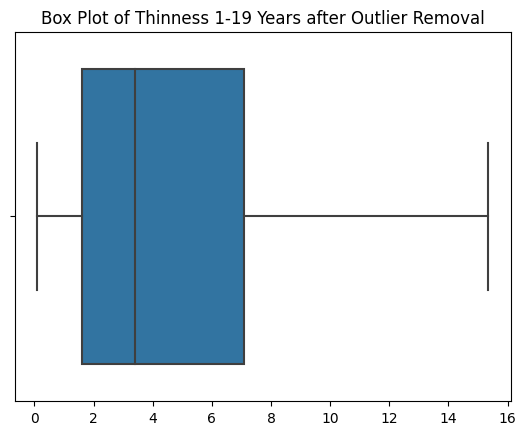

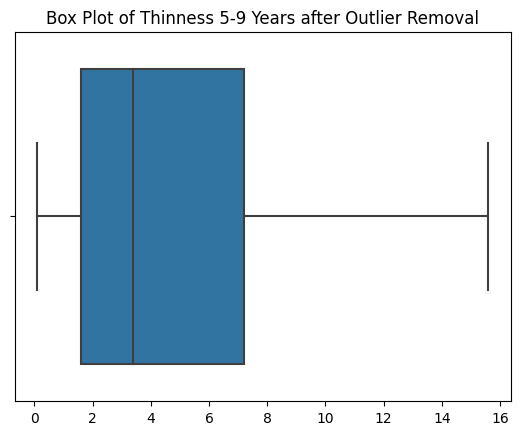

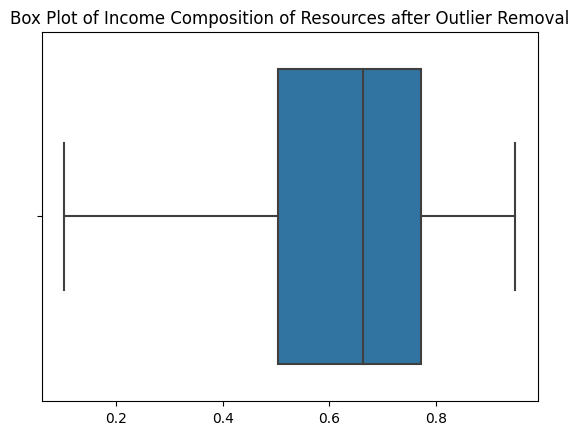

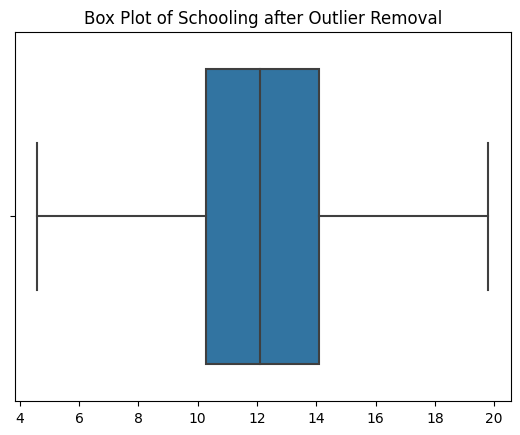

In [25]:
for col in skewed_cols:
    impute_outliers(df,col)

In [26]:
winsorizer = Winsorizer(capping_method='iqr',tail='both',fold=1.5)

for col in skewed_cols:
    df[col] = winsorizer.fit_transform(df[[col]])

### Categorical Encoding

In [27]:
status_encoder = OrdinalEncoder(categories=[['Developing','Developed']])
df['Status'] = status_encoder.fit_transform(df[['Status']])
df['Status'].sample(10)

1537    1.0
1150    0.0
800     0.0
1981    0.0
1727    0.0
2798    1.0
602     0.0
741     1.0
493     0.0
950     0.0
Name: Status, dtype: float64

In [28]:
status_mapping = {}

for idx, status in enumerate(status_encoder.categories_[0]):
    status_mapping[idx] = status

status_mapping

{0: 'Developing', 1: 'Developed'}

In [29]:
country_encoder = OneHotEncoder(drop='first',sparse_output=False,max_categories=10)
countries_encoded = country_encoder.fit_transform(df[['Country']])
countries_encoded = pd.DataFrame(countries_encoded,columns=country_encoder.get_feature_names_out())
countries_encoded.head()

,Country_Uruguay,Country_Uzbekistan,Country_Vanuatu,Country_Venezuela (Bolivarian Republic of),Country_Viet Nam,Country_Yemen,Country_Zambia,Country_Zimbabwe,Country_infrequent_sklearn
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [30]:
df = pd.concat([df,countries_encoded],axis=1)
df.drop('Country',axis=1,inplace=True)
df.head()

,Year,Status,Life Expectancy,Adult Mortality,Infant Deaths,Alcohol,Percentage Expenditure,Hepatitis B,Measles,BMI,...,Schooling,Country_Uruguay,Country_Uzbekistan,Country_Vanuatu,Country_Venezuela (Bolivarian Republic of),Country_Viet Nam,Country_Yemen,Country_Zambia,Country_Zimbabwe,Country_infrequent_sklearn
0,2015,0.0,65.0,263.0,55,0.01,71.279624,65.0,900.625,19.1,...,10.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,2014,0.0,59.9,271.0,55,0.01,73.523582,62.0,492.000,18.6,...,10.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,2013,0.0,59.9,268.0,55,0.01,73.219243,64.0,430.000,18.1,...,9.9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,2012,0.0,59.5,272.0,55,0.01,78.184215,67.0,900.625,17.6,...,9.8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,2011,0.0,59.2,275.0,55,0.01,7.097109,68.0,900.625,17.2,...,9.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


### Feature Splitting

In [31]:
X = df.drop('Life Expectancy',axis=1)
y = df['Life Expectancy']

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25,shuffle=True,random_state=50)

### Feature Selection

In [33]:
kbest = SelectKBest(k=10,score_func=f_regression)
kbest.fit(X_train,y_train)

SelectKBest(score_func=<function f_regression at 0x000001B774270B80>)

In [34]:
selected_features = kbest.get_feature_names_out()
selected_features

array(['Adult Mortality', 'Infant Deaths', 'BMI', 'Under-Five Deaths',
       'Polio', 'Diphtheria', 'HIV/AIDS', 'Thinness 1-19 Years',
       'Income Composition of Resources', 'Schooling'], dtype=object)

In [35]:
perc = SelectPercentile(percentile=50,score_func=f_regression)
perc.fit(X_train,y_train)

SelectPercentile(percentile=50,
                 score_func=<function f_regression at 0x000001B774270B80>)

In [36]:
selected_features = perc.get_feature_names_out()
selected_features

array(['Status', 'Adult Mortality', 'Infant Deaths',
       'Percentage Expenditure', 'BMI', 'Under-Five Deaths', 'Polio',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Thinness 1-19 Years',
       'Thinness 5-9 Years', 'Income Composition of Resources',
       'Schooling'], dtype=object)

In [37]:
lasso = SelectFromModel(estimator=Lasso(),max_features=10)
lasso.fit(X_train,y_train)

SelectFromModel(estimator=Lasso(), max_features=10)

In [38]:
selected_features = lasso.get_feature_names_out()
selected_features

array(['Year', 'Infant Deaths', 'Hepatitis B', 'BMI', 'Under-Five Deaths',
       'Polio', 'Diphtheria', 'HIV/AIDS', 'Thinness 1-19 Years',
       'Schooling'], dtype=object)

In [39]:
rf = RFE(estimator=RandomForestRegressor(),n_features_to_select=10,step=2,verbose=2)
rf.fit(X_train,y_train)

Fitting estimator with 29 features.
Fitting estimator with 27 features.
Fitting estimator with 25 features.
Fitting estimator with 23 features.
Fitting estimator with 21 features.
Fitting estimator with 19 features.
Fitting estimator with 17 features.
Fitting estimator with 15 features.
Fitting estimator with 13 features.
Fitting estimator with 11 features.


RFE(estimator=RandomForestRegressor(), n_features_to_select=10, step=2,
    verbose=2)

In [40]:
selected_features = rf.get_feature_names_out()
selected_features

array(['Year', 'Adult Mortality', 'Alcohol', 'BMI', 'Under-Five Deaths',
       'Polio', 'HIV/AIDS', 'Thinness 5-9 Years',
       'Income Composition of Resources', 'Schooling'], dtype=object)

In [41]:
sfs = SequentialFeatureSelector(estimator=RandomForestRegressor(),n_features_to_select=10,direction='backward')
sfs.fit(X_train,y_train)

SequentialFeatureSelector(direction='backward',
                          estimator=RandomForestRegressor(),
                          n_features_to_select=10)

In [42]:
selected_features = sfs.get_feature_names_out()
selected_features

array(['Year', 'Adult Mortality', 'Infant Deaths', 'HIV/AIDS',
       'Thinness 1-19 Years', 'Thinness 5-9 Years',
       'Income Composition of Resources', 'Schooling',
       'Country_Uzbekistan', 'Country_Vanuatu'], dtype=object)

In [43]:
xgb = XGBRegressor()
xgb.fit(X_train,y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [44]:
def plot_feature_importances(feat_imp_type):
    feat_imps = xgb.get_booster().get_score(importance_type=feat_imp_type)
    keys = list(feat_imps.keys())
    values = list(feat_imps.values())
    feat_imps_df = pd.DataFrame(data=values, index=keys, columns=["Importance"]).sort_values(by="Importance", ascending=False).reset_index()
    feat_imps_df.rename({'index': 'Feature'},axis=1,inplace=True)
    fig = sns.barplot(x='Importance',y='Feature',data=feat_imps_df,orient='horizontal',palette='viridis')
    plt.title(f"{feat_imp_type.title()} Feature Importance")
    plt.show(fig)
    plt.close('all')
    del fig
    gc.collect();

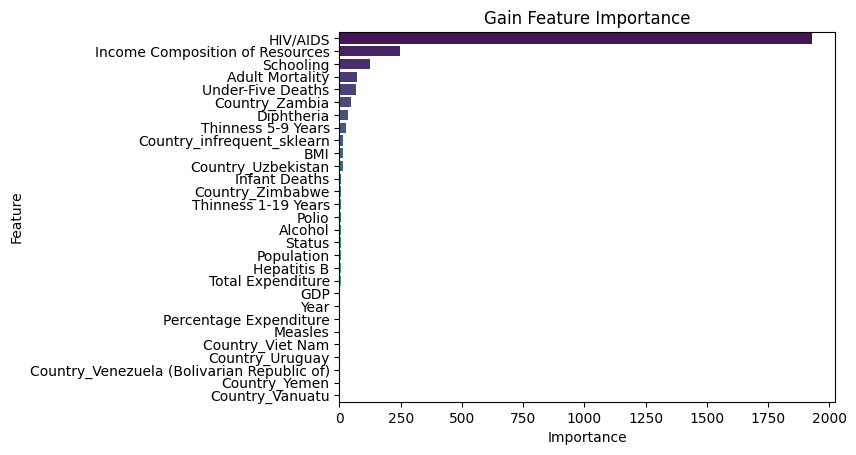

In [45]:
plot_feature_importances('gain')

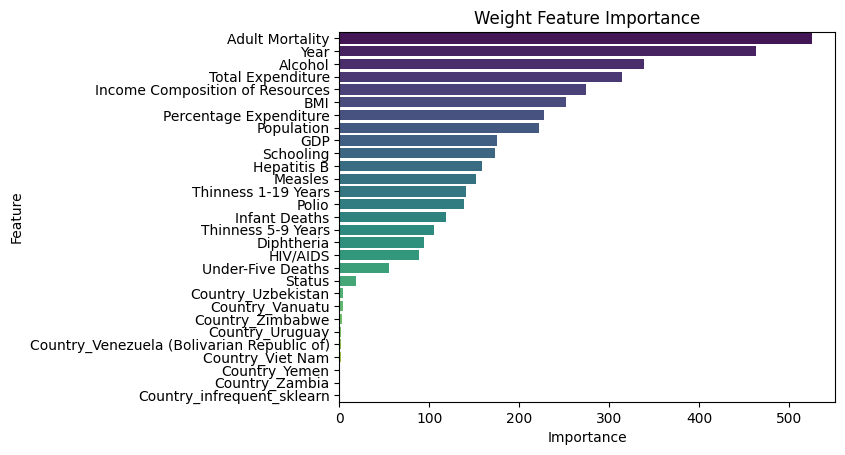

In [46]:
plot_feature_importances('weight')

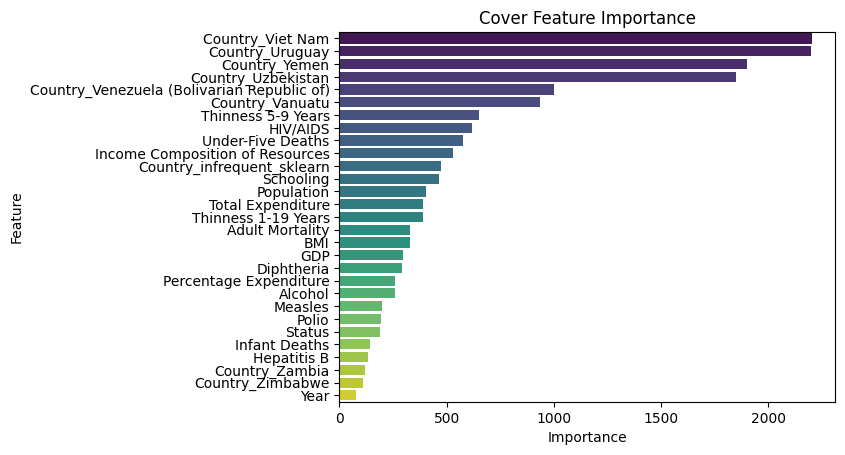

In [47]:
plot_feature_importances('cover')

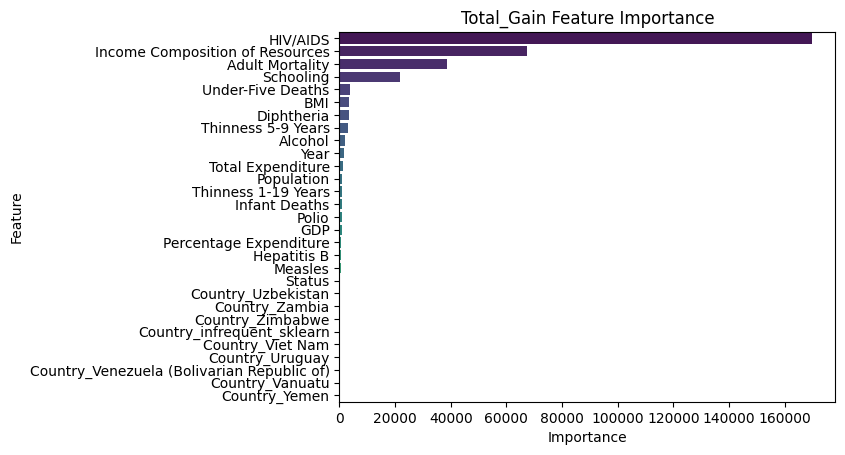

In [48]:
plot_feature_importances('total_gain')

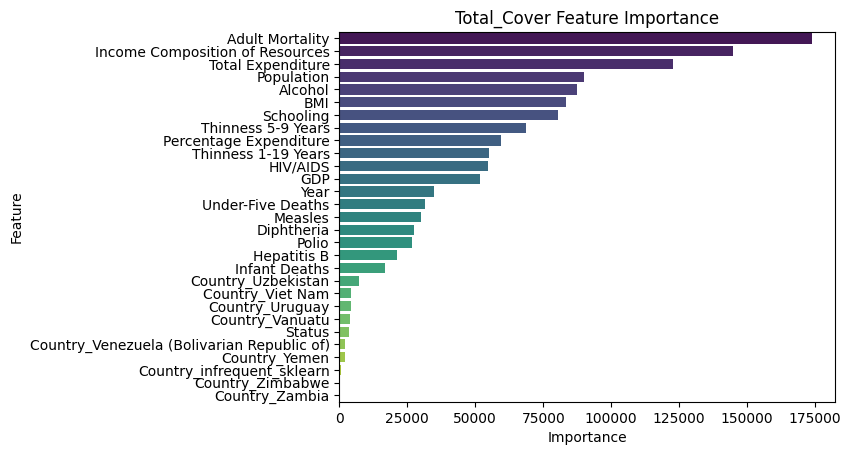

In [49]:
plot_feature_importances('total_cover')

In [50]:
final_selected_features = ['Polio','Adult Mortality','BMI','Diphtheria','HIV/AIDS','Schooling','Income Composition of Resources','Thinness 5-9 Years','Under-Five Deaths','Alcohol']

final_X_train = X_train[final_selected_features]
final_X_test = X_test[final_selected_features]

In [51]:
gc.collect()

0

In [52]:
skewed_cols = ['Polio','Adult Mortality','Diphtheria','HIV/AIDS','Schooling','Income Composition of Resources','Thinness 5-9 Years','Under-Five Deaths']

transformer = ColumnTransformer(transformers=[
    ('power_transform',PowerTransformer(),skewed_cols)
],remainder='passthrough')
transformer

ColumnTransformer(remainder='passthrough',
                  transformers=[('power_transform', PowerTransformer(),
                                 ['Polio', 'Adult Mortality', 'Diphtheria',
                                  'HIV/AIDS', 'Schooling',
                                  'Income Composition of Resources',
                                  'Thinness 5-9 Years', 'Under-Five Deaths'])])

In [53]:
final_X_train_tf = transformer.fit_transform(final_X_train)
final_X_train_tf = pd.DataFrame(final_X_train_tf,columns=final_X_train.columns)
final_X_train_tf.head()

,Polio,Adult Mortality,BMI,Diphtheria,HIV/AIDS,Schooling,Income Composition of Resources,Thinness 5-9 Years,Under-Five Deaths,Alcohol
0,-0.888800,0.778319,-0.888911,-0.737423,-1.164080,-0.932982,1.694582,1.261656,35.7,0.04
1,-1.774148,0.630277,-1.780410,1.429329,-0.682717,-0.919742,1.480797,0.874041,14.3,2.03
2,-1.107221,-1.286948,-1.004204,1.632155,0.058994,-0.053092,0.754760,-0.159149,33.0,8.64
3,1.154429,-1.751389,1.170325,-0.737423,0.711975,0.246082,0.716656,-0.159149,54.7,1.37
4,-0.310729,0.502940,-0.549416,0.279477,-0.836349,-0.707766,0.208436,0.766370,31.3,0.37


In [54]:
final_X_test_tf = transformer.transform(final_X_test)
final_X_test_tf = pd.DataFrame(final_X_test_tf,columns=final_X_test.columns)
final_X_test_tf.head()

,Polio,Adult Mortality,BMI,Diphtheria,HIV/AIDS,Schooling,Income Composition of Resources,Thinness 5-9 Years,Under-Five Deaths,Alcohol
0,-1.398690,-0.991554,-1.402476,1.632155,-0.957184,-0.857019,1.101497,0.626619,21.2,2.58
1,0.621959,-1.689698,0.633558,-0.737423,1.435383,1.328520,-0.552565,-1.230653,54.1,11.14
2,1.154429,0.250373,1.170325,-0.737423,-0.076349,-0.193923,-2.021463,-1.230653,77.3,0.01
3,-0.394589,-0.226398,-0.390971,-0.737423,1.069226,0.742768,0.151440,-1.230653,49.2,8.95
4,0.621959,0.103516,0.633558,-0.737423,0.159768,0.348804,0.289763,-1.230653,43.0,11.09


### Feature Scaling

In [55]:
scaler = StandardScaler()
final_X_train_tf = scaler.fit_transform(final_X_train_tf)
final_X_train_tf = pd.DataFrame(final_X_train_tf,columns=final_selected_features)
final_X_test_tf = scaler.transform(final_X_test_tf)
final_X_test_tf = pd.DataFrame(final_X_test_tf,columns=final_selected_features)
final_X_train_tf.head()

,Polio,Adult Mortality,BMI,Diphtheria,HIV/AIDS,Schooling,Income Composition of Resources,Thinness 5-9 Years,Under-Five Deaths,Alcohol
0,-0.888800,0.778319,-0.888911,-0.737423,-1.164080,-0.932982,1.694582,1.261656,-0.145156,-1.164395
1,-1.774148,0.630277,-1.780410,1.429329,-0.682717,-0.919742,1.480797,0.874041,-1.219607,-0.655614
2,-1.107221,-1.286948,-1.004204,1.632155,0.058994,-0.053092,0.754760,-0.159149,-0.280717,1.034357
3,1.154429,-1.751389,1.170325,-0.737423,0.711975,0.246082,0.716656,-0.159149,0.808796,-0.824356
4,-0.310729,0.502940,-0.549416,0.279477,-0.836349,-0.707766,0.208436,0.766370,-0.366071,-1.080025


In [56]:
final_X_test_tf.head()

,Polio,Adult Mortality,BMI,Diphtheria,HIV/AIDS,Schooling,Income Composition of Resources,Thinness 5-9 Years,Under-Five Deaths,Alcohol
0,-1.398690,-0.991554,-1.402476,1.632155,-0.957184,-0.857019,1.101497,0.626619,-0.873172,-0.514996
1,0.621959,-1.689698,0.633558,-0.737423,1.435383,1.328520,-0.552565,-1.230653,0.778672,1.673529
2,1.154429,0.250373,1.170325,-0.737423,-0.076349,-0.193923,-2.021463,-1.230653,1.943498,-1.172065
3,-0.394589,-0.226398,-0.390971,-0.737423,1.069226,0.742768,0.151440,-1.230653,0.532652,1.113614
4,0.621959,0.103516,0.633558,-0.737423,0.159768,0.348804,0.289763,-1.230653,0.221363,1.660746


## Model Training & Evaluation

In [70]:
models = []
r2_scores = []
mae_scores = []
mape_scores = []
rmse_scores = []

In [101]:
def train_and_evaluate_model(model):
    model.fit(final_X_train_tf,y_train)
    y_pred = model.predict(final_X_test_tf)
    r2 = r2_score(y_test,y_pred)
    mae = mean_absolute_error(y_test,y_pred)
    mape = mean_absolute_percentage_error(y_test,y_pred)
    rmse = mean_squared_error(y_test,y_pred,squared=False)
    print("R2 Score:",r2)
    print("Mean Absolute Error:",mae)
    print("Mean Absolute Percentage Error:",mape)
    print("Root Mean Squared Error:",rmse)
    models.append(model)
    r2_scores.append(r2)
    mae_scores.append(mae)
    mape_scores.append(mape)
    rmse_scores.append(rmse)
    try:
        prediction_error = PredictionError(estimator=model)
        prediction_error.score(final_X_test_tf,y_test)
        prediction_error.show()
        res_plot = ResidualsPlot(estimator=model)
        res_plot.score(final_X_test_tf,y_test)
        res_plot.show()
        del r2, mae, mape, rmse
    except Exception as e:
        pass
    gc.collect()

R2 Score: 0.8125062054029975
Mean Absolute Error: 3.1424727444644884
Mean Absolute Percentage Error: 0.04895125483251675
Root Mean Squared Error: 4.195109867824483


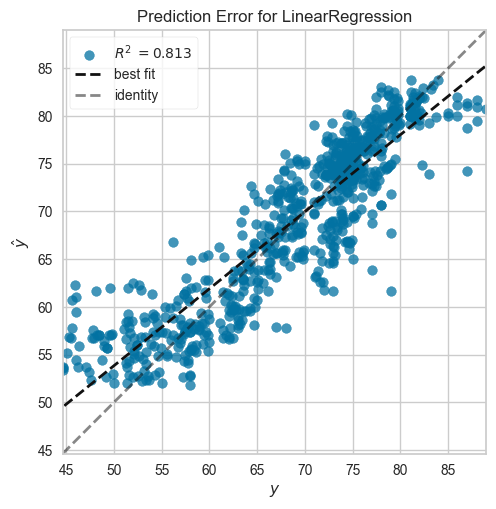

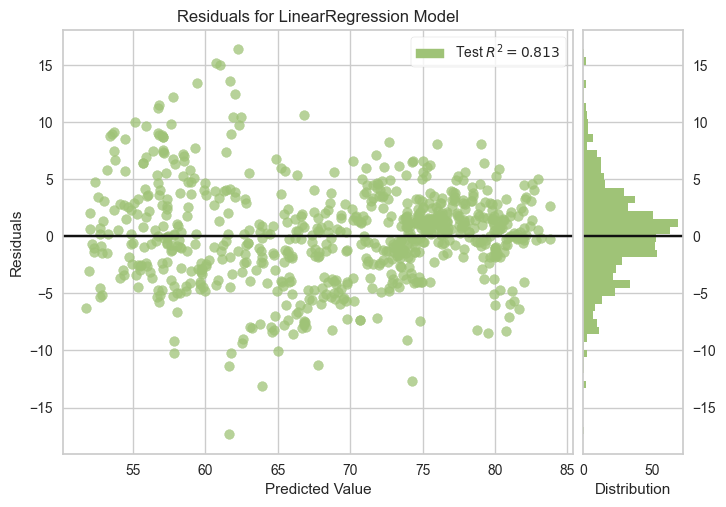

In [72]:
train_and_evaluate_model(LinearRegression())

R2 Score: 0.7037093802520233
Mean Absolute Error: 3.915793578619449
Mean Absolute Percentage Error: 0.06196005072113835
Root Mean Squared Error: 5.2736201021554745


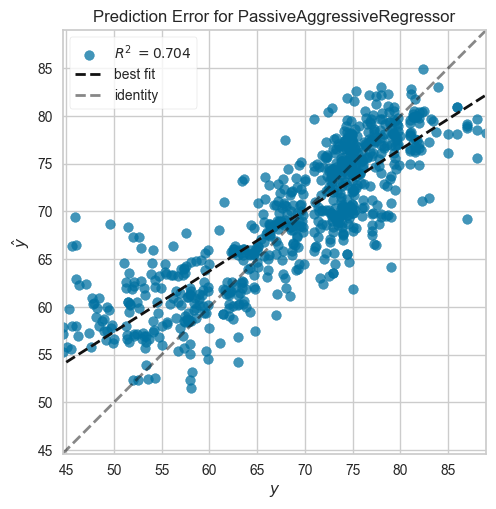

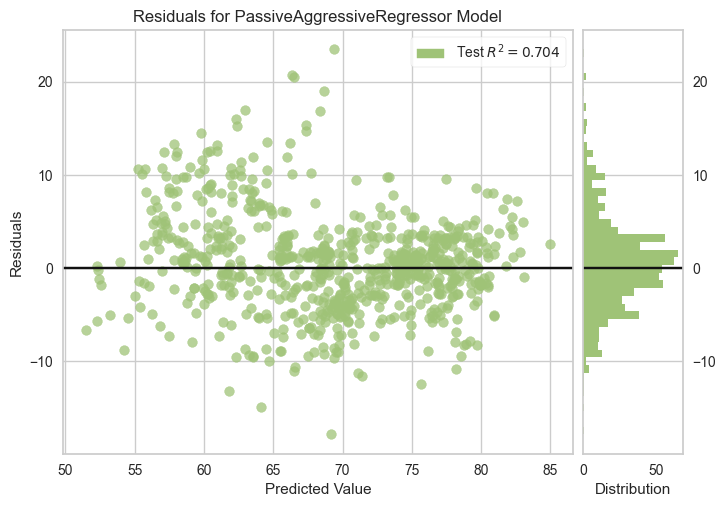

In [73]:
train_and_evaluate_model(PassiveAggressiveRegressor())

R2 Score: 0.8120021827222192
Mean Absolute Error: 3.1851872523704663
Mean Absolute Percentage Error: 0.049363160455493944
Root Mean Squared Error: 4.200744751434315


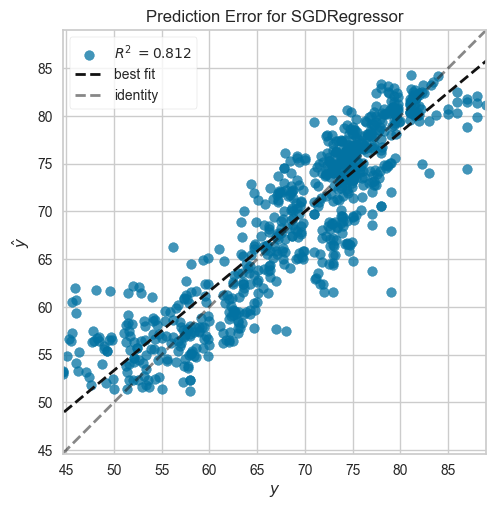

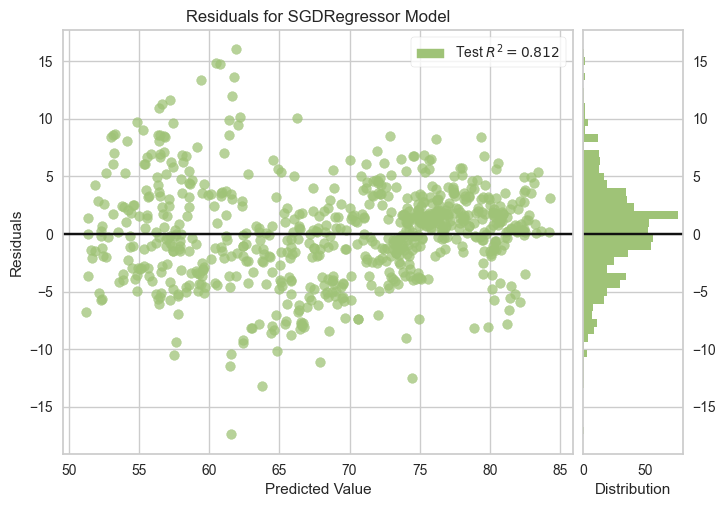

In [74]:
train_and_evaluate_model(SGDRegressor())

R2 Score: 0.7855384425764613
Mean Absolute Error: 3.2757212637074695
Mean Absolute Percentage Error: 0.05195762627083335
Root Mean Squared Error: 4.486675060959189


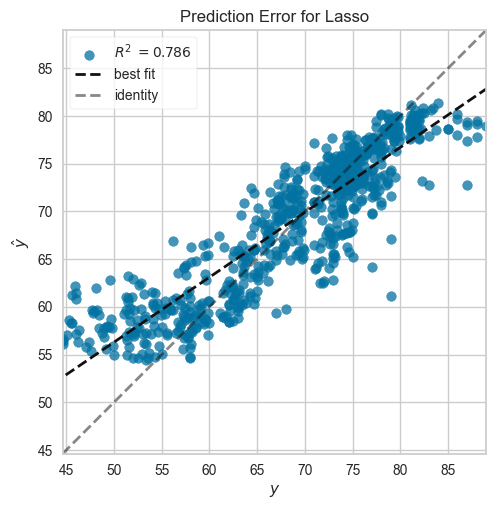

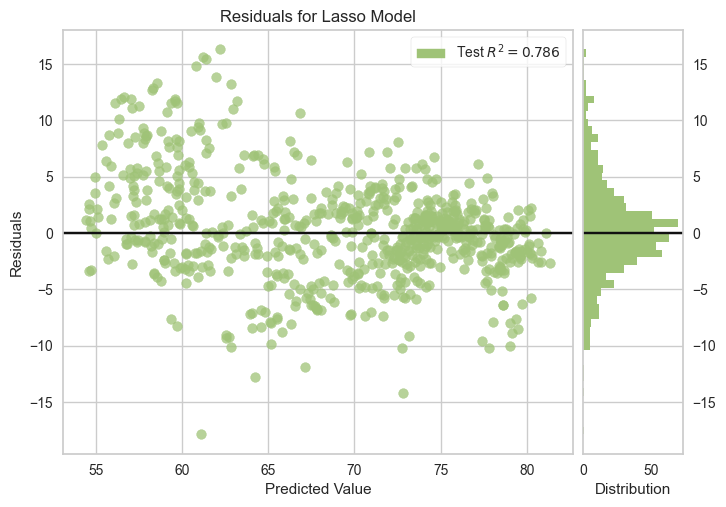

In [75]:
train_and_evaluate_model(Lasso())

R2 Score: 0.8124973410614952
Mean Absolute Error: 3.1423987644170306
Mean Absolute Percentage Error: 0.04895127242636989
Root Mean Squared Error: 4.195209034965102


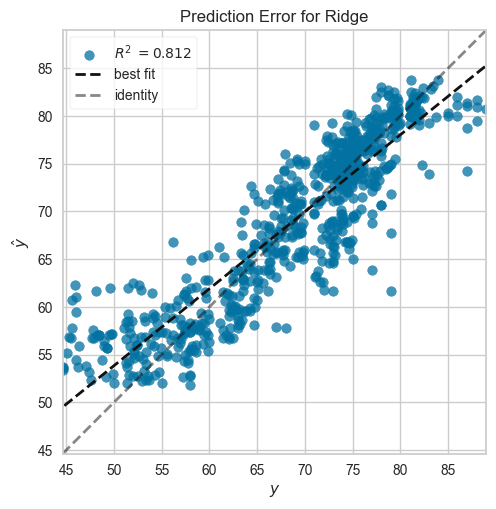

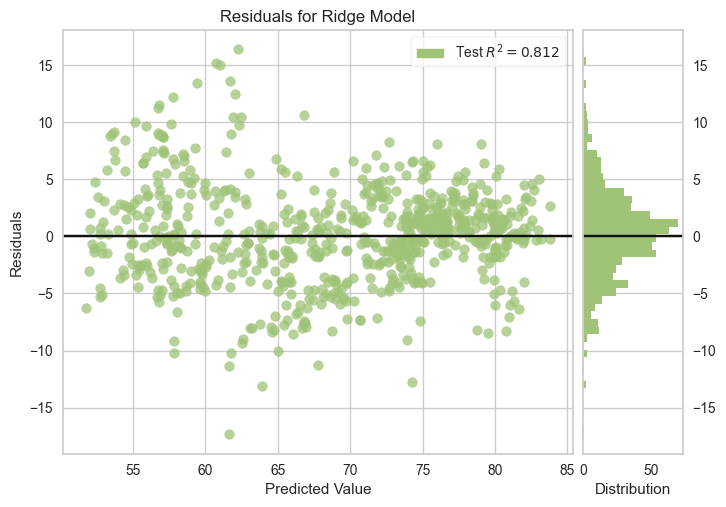

In [76]:
train_and_evaluate_model(Ridge())

R2 Score: 0.776858008444256
Mean Absolute Error: 3.323596566857411
Mean Absolute Percentage Error: 0.052890955007492794
Root Mean Squared Error: 4.576574562596033


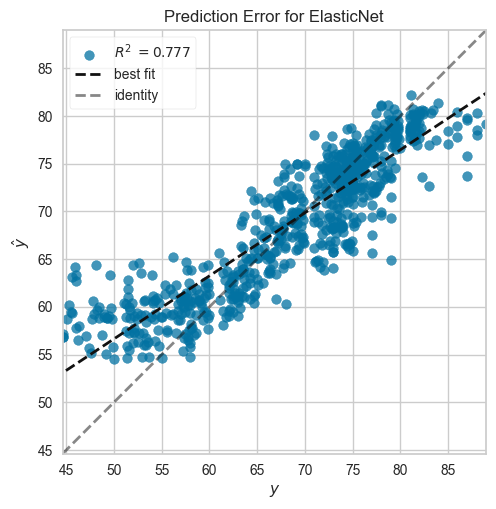

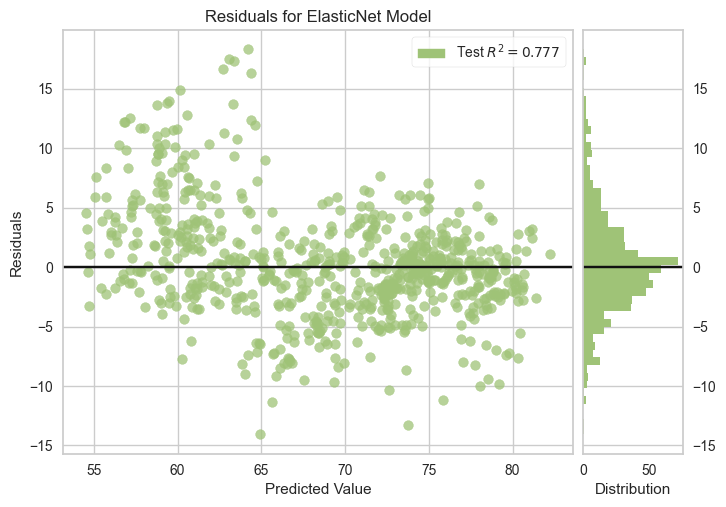

In [77]:
train_and_evaluate_model(ElasticNet())

R2 Score: 0.8124421395346527
Mean Absolute Error: 3.1419550142590356
Mean Absolute Percentage Error: 0.04895124958878098
Root Mean Squared Error: 4.1958265326137


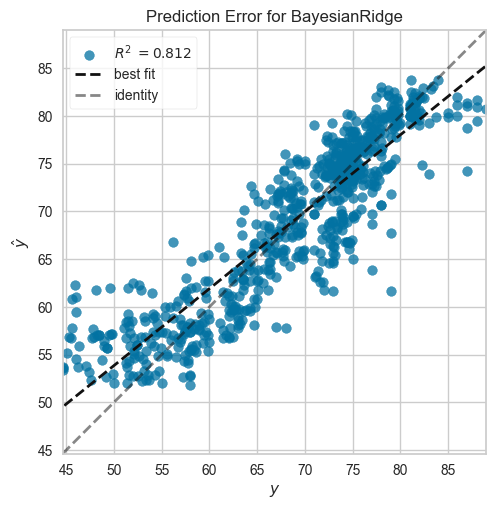

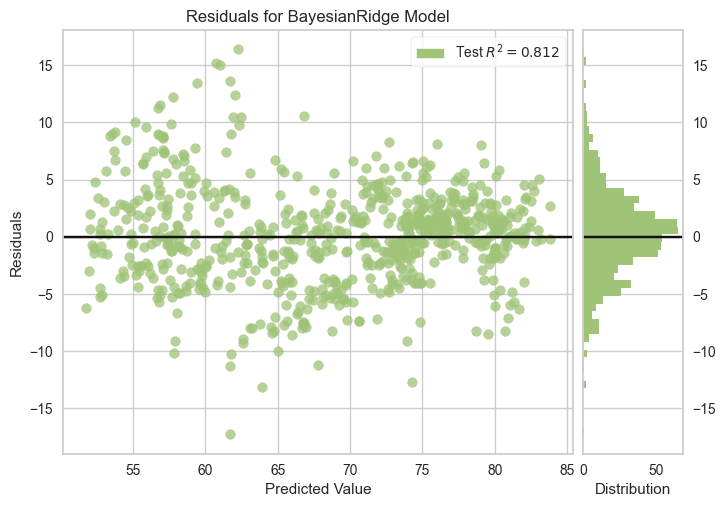

In [78]:
train_and_evaluate_model(BayesianRidge())

R2 Score: 0.8082976953545269
Mean Absolute Error: 3.1092114891729135
Mean Absolute Percentage Error: 0.04877917715362039
Root Mean Squared Error: 4.241930580200523


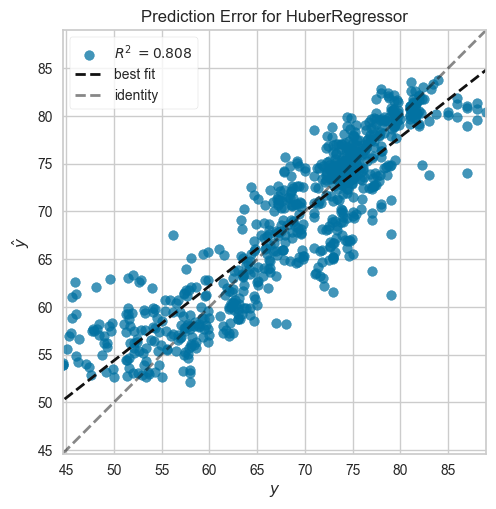

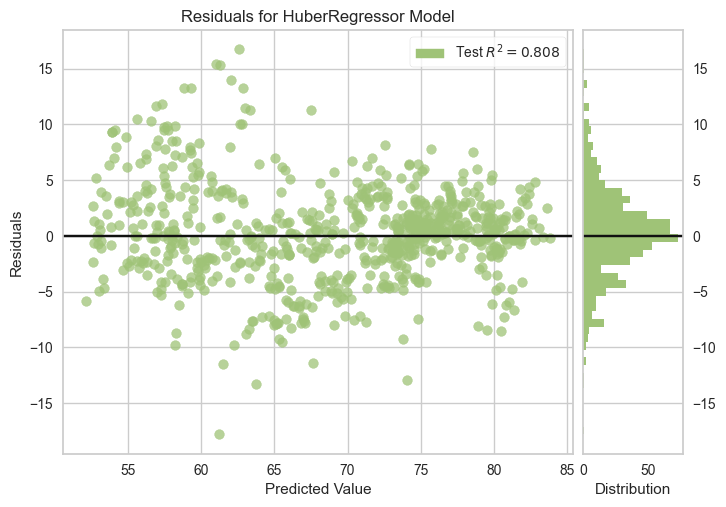

In [79]:
train_and_evaluate_model(HuberRegressor())

R2 Score: 0.8046558251489765
Mean Absolute Error: 3.2290471904245988
Mean Absolute Percentage Error: 0.050207492500552606
Root Mean Squared Error: 4.282034110174294


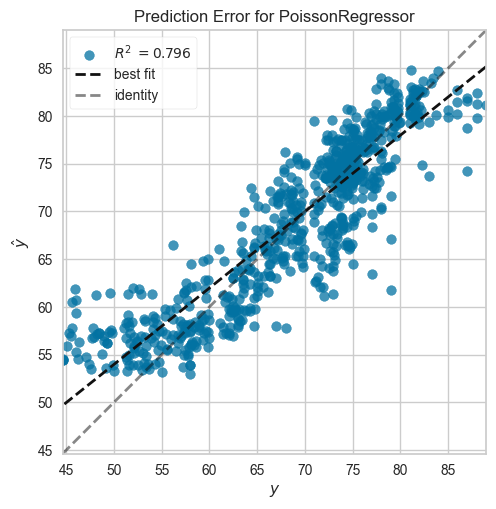

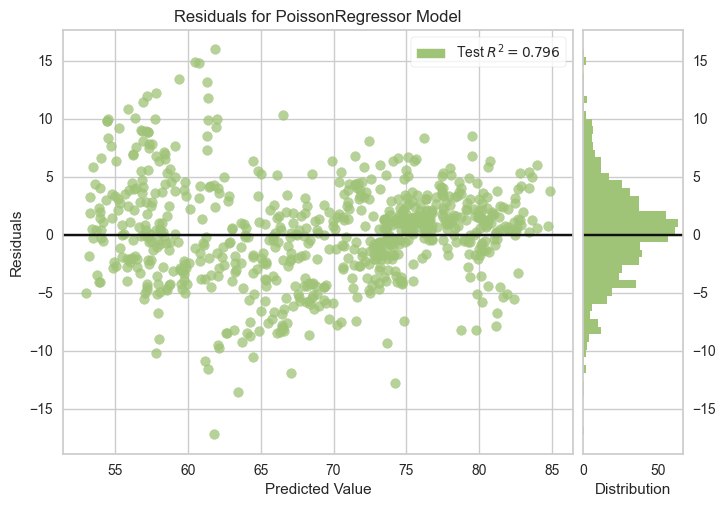

In [80]:
train_and_evaluate_model(PoissonRegressor())

R2 Score: 0.8126263448376115
Mean Absolute Error: 3.1416145665575845
Mean Absolute Percentage Error: 0.048954831519568275
Root Mean Squared Error: 4.193765612963419


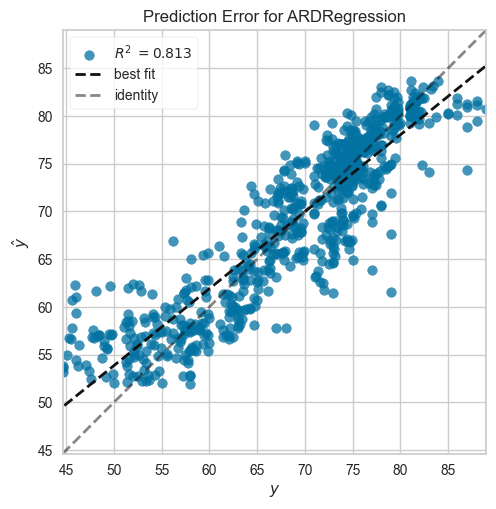

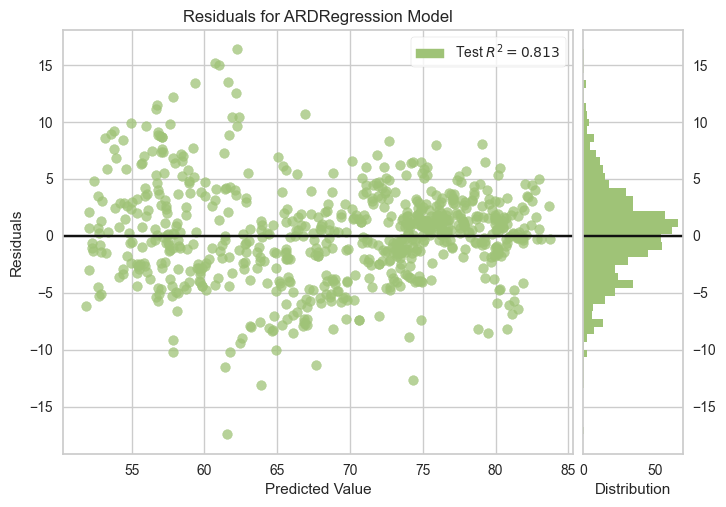

In [81]:
train_and_evaluate_model(ARDRegression())

R2 Score: 0.6839953790432538
Mean Absolute Error: 3.628581993918473
Mean Absolute Percentage Error: 0.05713740548751776
Root Mean Squared Error: 5.446237882116293


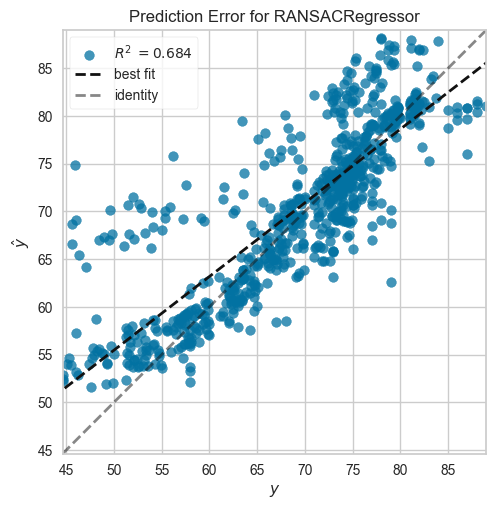

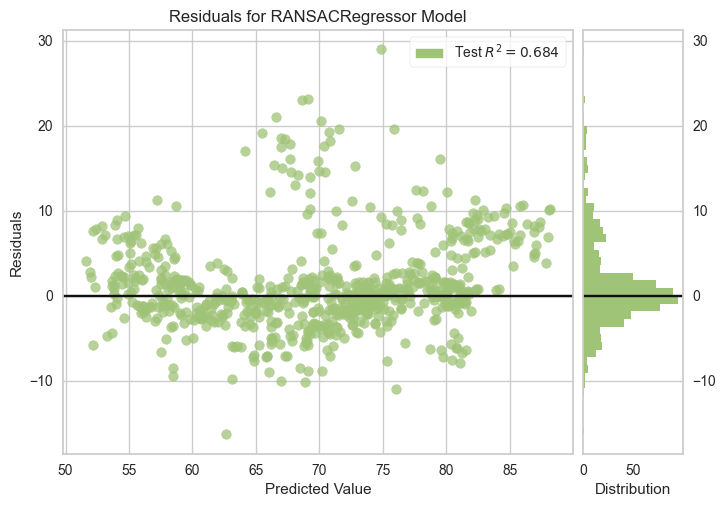

In [82]:
train_and_evaluate_model(RANSACRegressor())

R2 Score: 0.7655813956991825
Mean Absolute Error: 3.4513627551727026
Mean Absolute Percentage Error: 0.05469885057836544
Root Mean Squared Error: 4.690789322271982


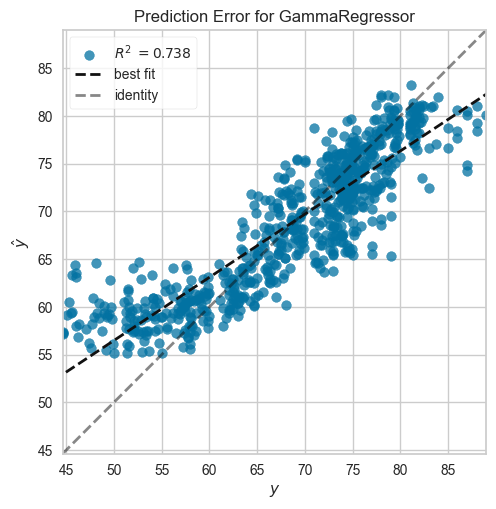

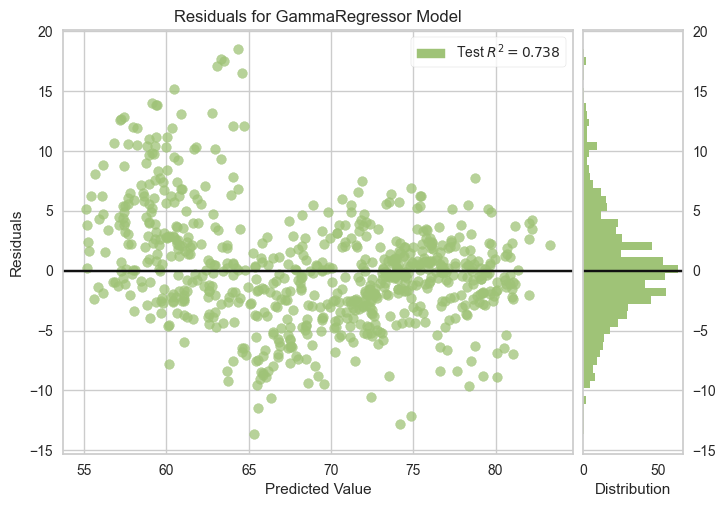

In [83]:
train_and_evaluate_model(GammaRegressor())

R2 Score: 0.7676455851854592
Mean Absolute Error: 3.4142710569515637
Mean Absolute Percentage Error: 0.054333634416027725
Root Mean Squared Error: 4.6700911192169325


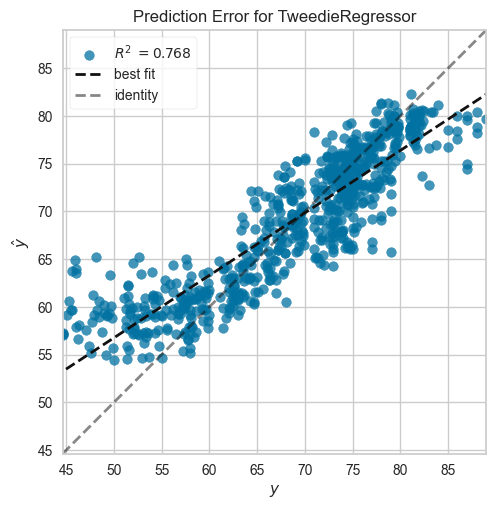

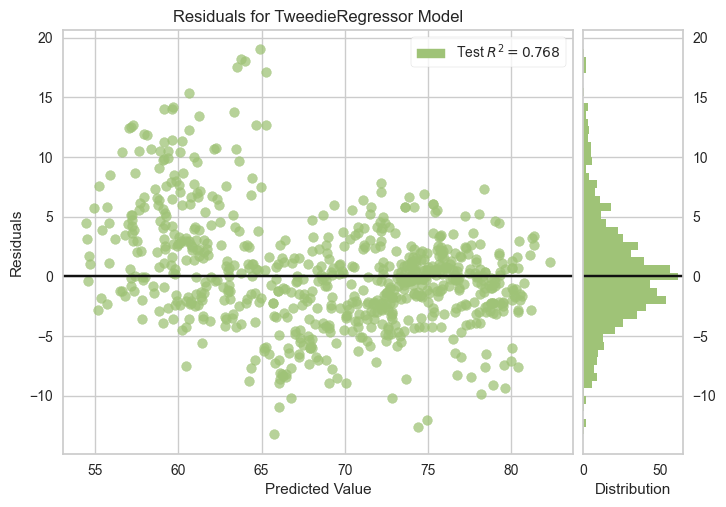

In [84]:
train_and_evaluate_model(TweedieRegressor())

R2 Score: 0.7922599774944438
Mean Absolute Error: 3.189424483333987
Mean Absolute Percentage Error: 0.050021236299993735
Root Mean Squared Error: 4.415805917370656


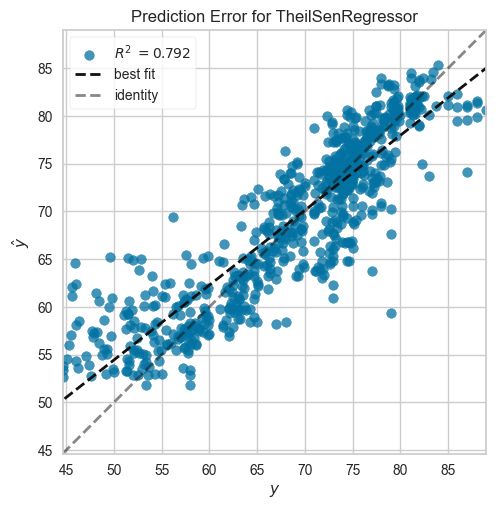

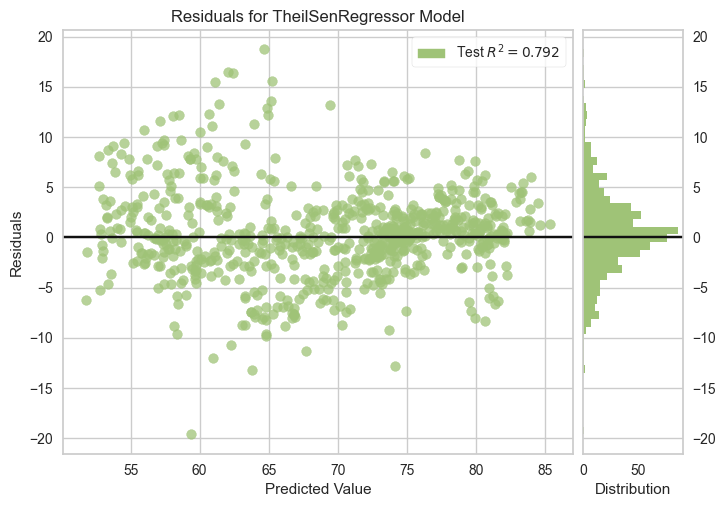

In [85]:
train_and_evaluate_model(TheilSenRegressor())

R2 Score: 0.9193863201907022
Mean Absolute Error: 1.8970952195085677
Mean Absolute Percentage Error: 0.029235659417855924
Root Mean Squared Error: 2.7507698967938943


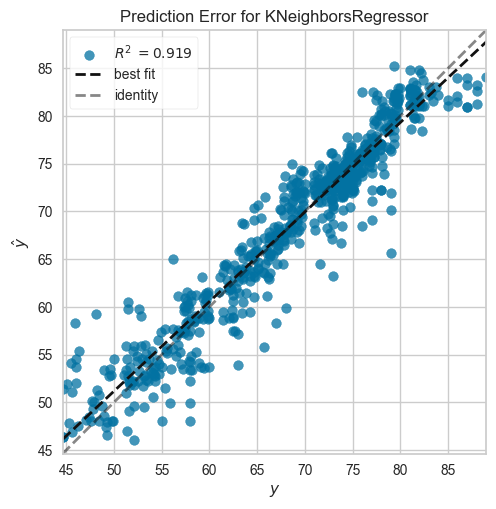

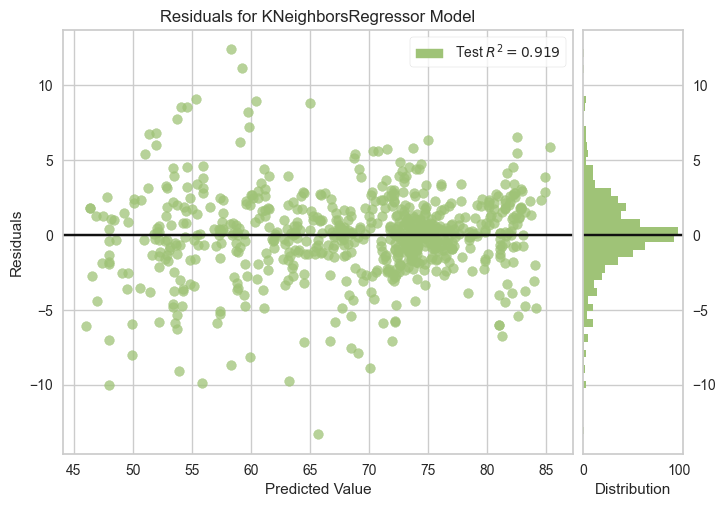

In [86]:
train_and_evaluate_model(KNeighborsRegressor())

R2 Score: 0.8867234796787697
Mean Absolute Error: 2.119101781743567
Mean Absolute Percentage Error: 0.03382030283252879
Root Mean Squared Error: 3.260767545450639


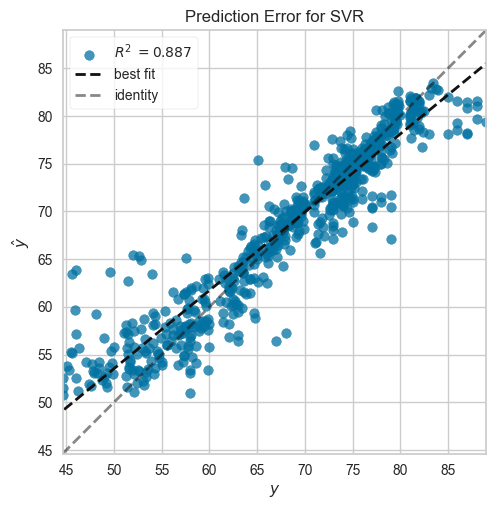

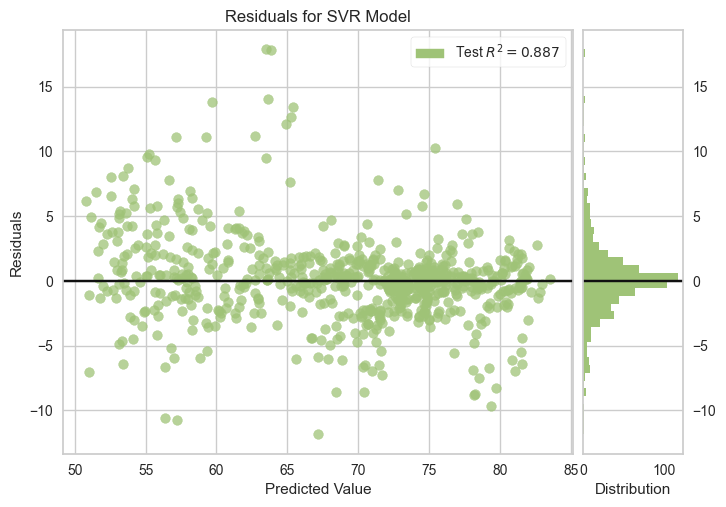

In [87]:
train_and_evaluate_model(SVR())

R2 Score: 0.8041023779791809
Mean Absolute Error: 3.092957411244529
Mean Absolute Percentage Error: 0.04857227191151071
Root Mean Squared Error: 4.288095727969798


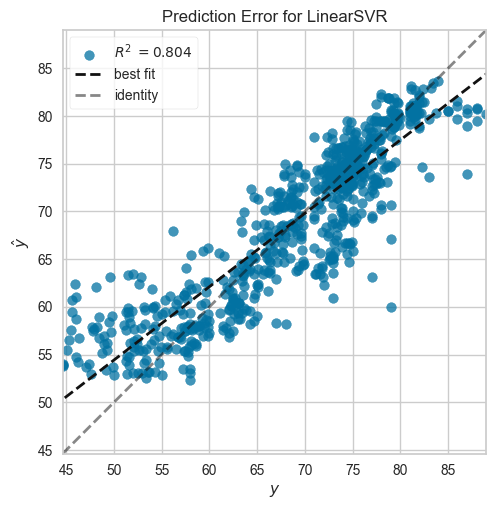

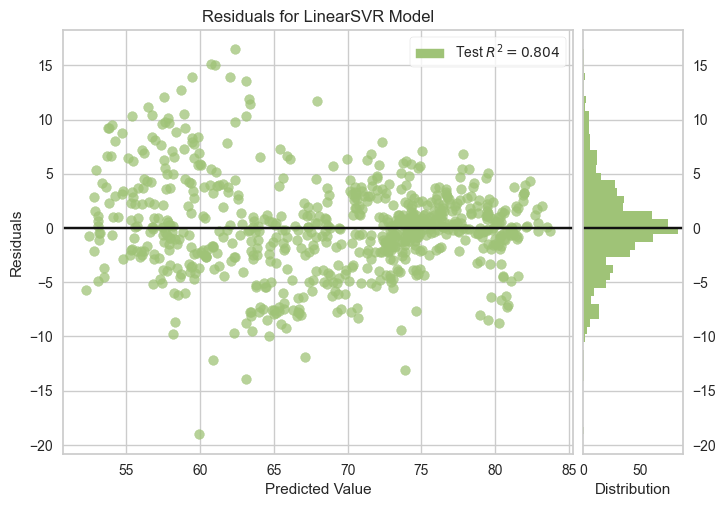

In [88]:
train_and_evaluate_model(LinearSVR())

R2 Score: 0.8844519332595349
Mean Absolute Error: 2.217397763584214
Mean Absolute Percentage Error: 0.03518219359761927
Root Mean Squared Error: 3.2932995267875302


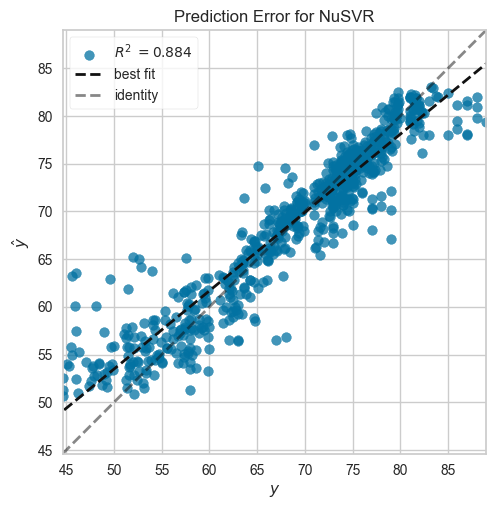

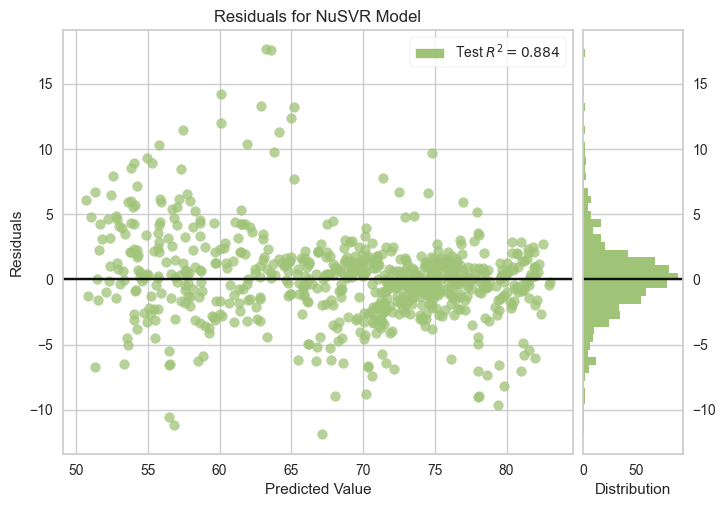

In [89]:
train_and_evaluate_model(NuSVR())

R2 Score: 0.927630520851689
Mean Absolute Error: 1.5579252630013753
Mean Absolute Percentage Error: 0.02404613954820798
Root Mean Squared Error: 2.606319260446884


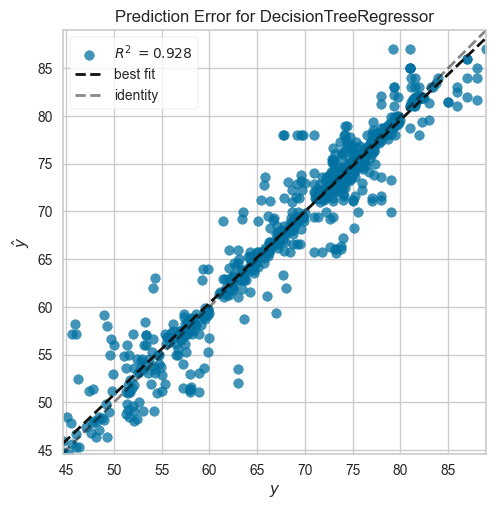

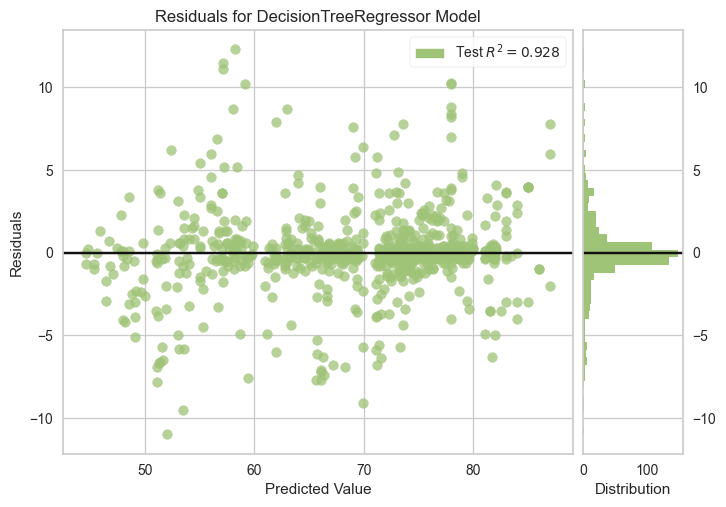

In [90]:
train_and_evaluate_model(DecisionTreeRegressor())

R2 Score: 0.9580246126702987
Mean Absolute Error: 1.2301705763726247
Mean Absolute Percentage Error: 0.01889129988248236
Root Mean Squared Error: 1.9849393714954466


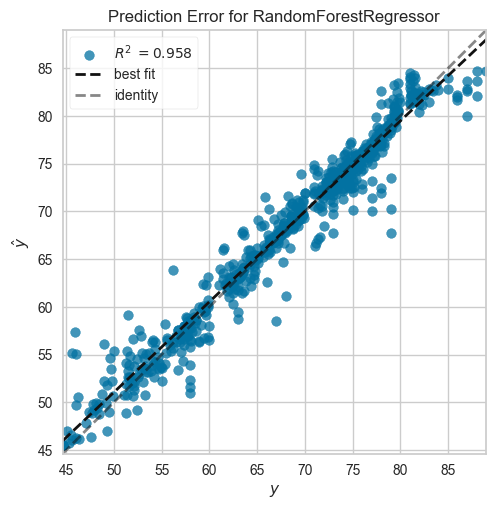

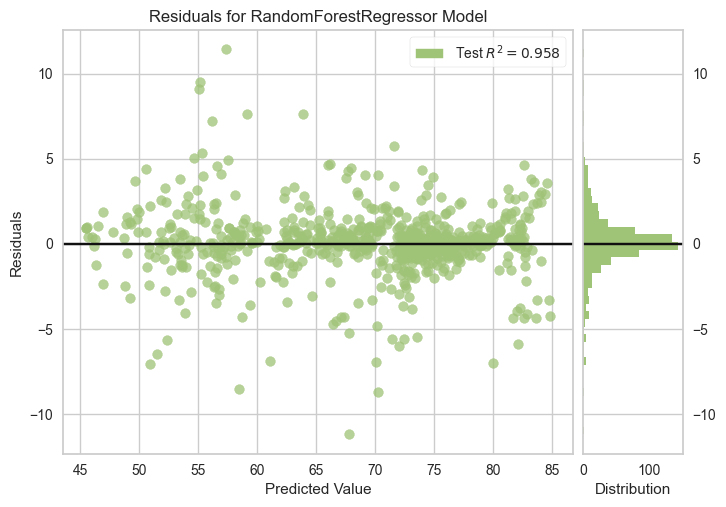

In [91]:
train_and_evaluate_model(RandomForestRegressor())

R2 Score: 0.9665145932693844
Mean Absolute Error: 1.0382012536708685
Mean Absolute Percentage Error: 0.015889652862848273
Root Mean Squared Error: 1.7728732172117148


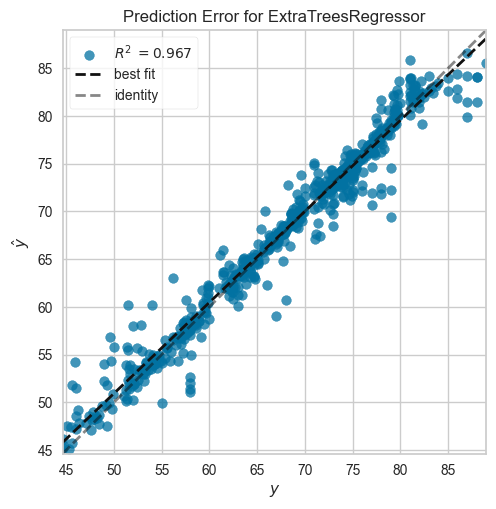

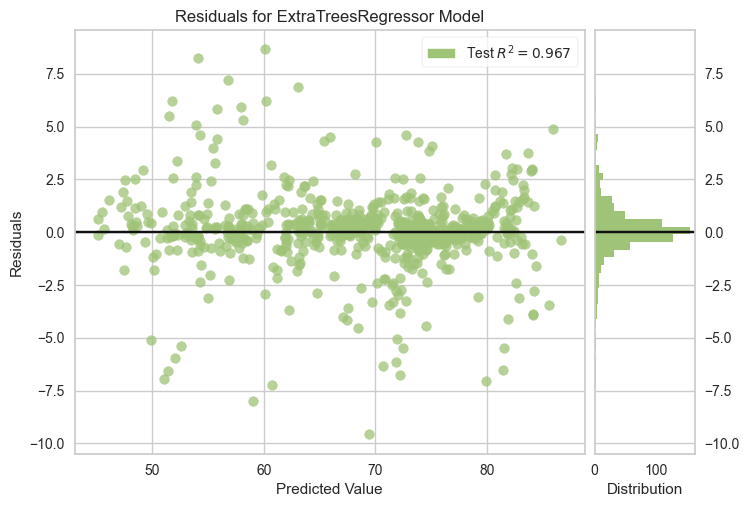

In [92]:
train_and_evaluate_model(ExtraTreesRegressor())

R2 Score: 0.9535193914322941
Mean Absolute Error: 1.3352316084903906
Mean Absolute Percentage Error: 0.020383697182322972
Root Mean Squared Error: 2.088746776908257


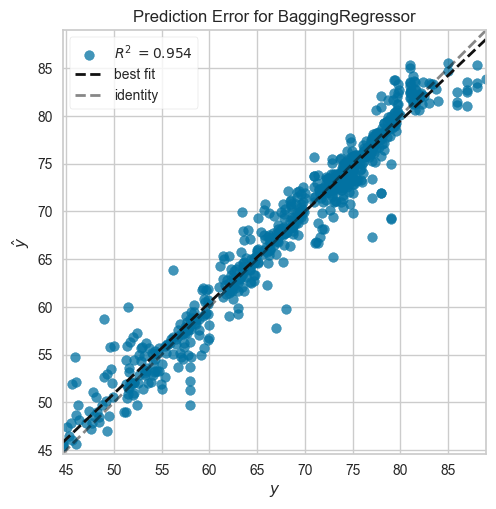

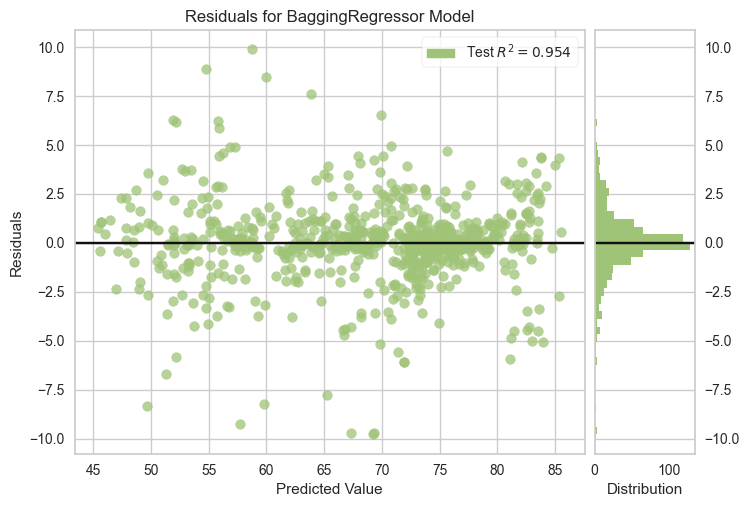

In [93]:
train_and_evaluate_model(BaggingRegressor())

R2 Score: 0.8802500685230681
Mean Absolute Error: 2.723567636419245
Mean Absolute Percentage Error: 0.04121567682571477
Root Mean Squared Error: 3.352644666626292


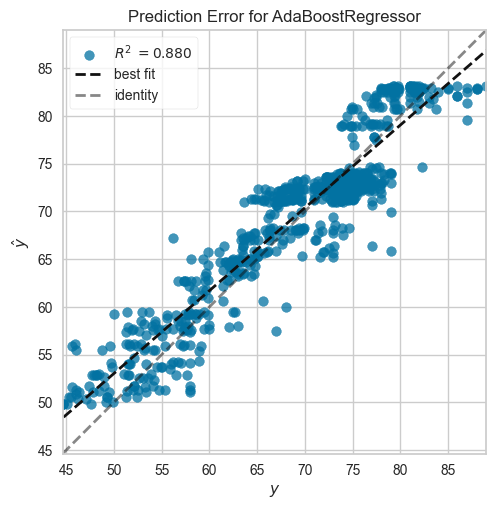

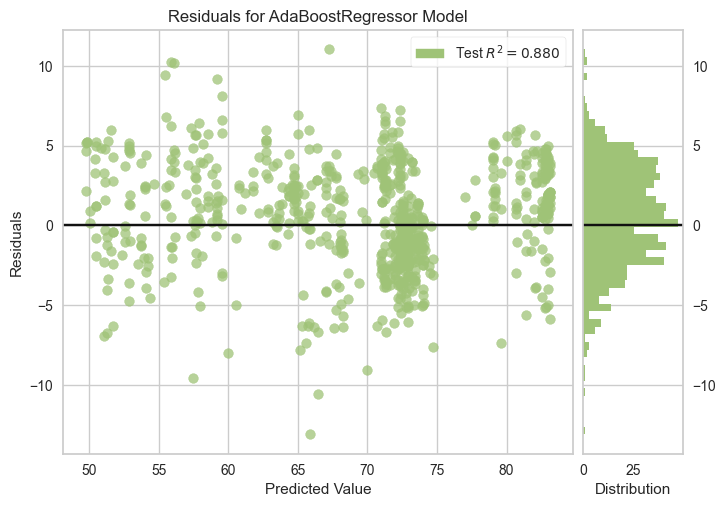

In [94]:
train_and_evaluate_model(AdaBoostRegressor())

R2 Score: 0.9352472260483397
Mean Absolute Error: 1.725865790880331
Mean Absolute Percentage Error: 0.02633766496447211
Root Mean Squared Error: 2.465352810828376


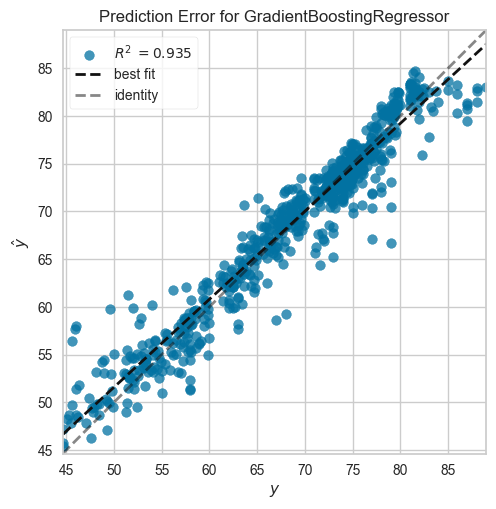

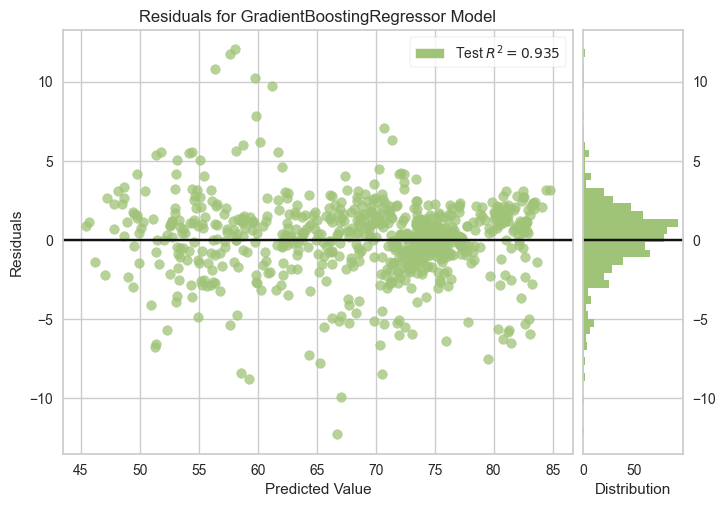

In [95]:
train_and_evaluate_model(GradientBoostingRegressor())

R2 Score: 0.9573381762829289
Mean Absolute Error: 1.2902254328030673
Mean Absolute Percentage Error: 0.019698345824972666
Root Mean Squared Error: 2.0011037156346796


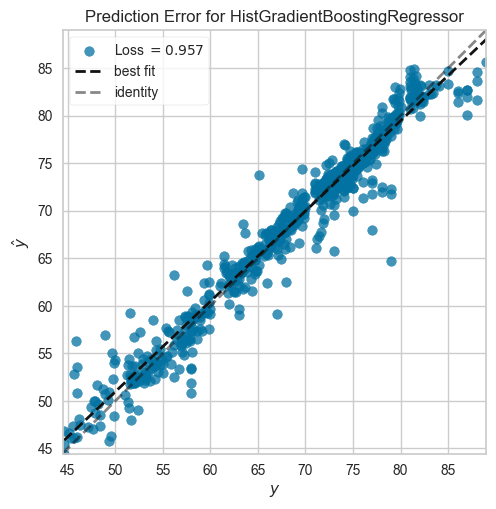

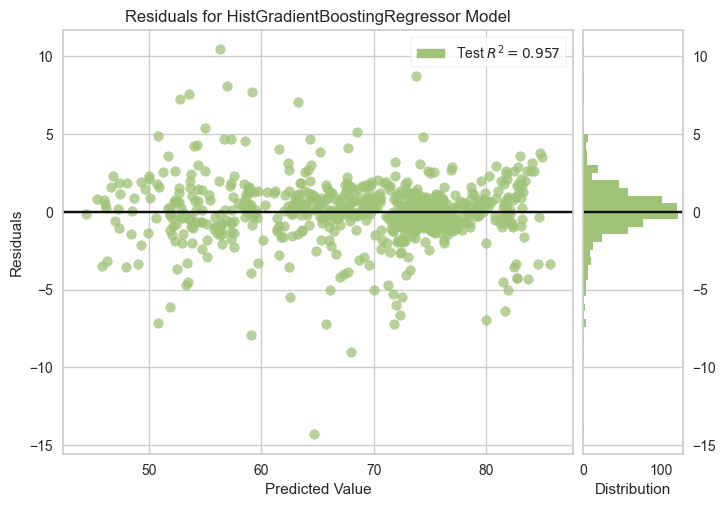

In [96]:
train_and_evaluate_model(HistGradientBoostingRegressor())

R2 Score: 0.7163784244756373
Mean Absolute Error: 3.9172744797511845
Mean Absolute Percentage Error: 0.06042134544639557
Root Mean Squared Error: 5.159641444641633


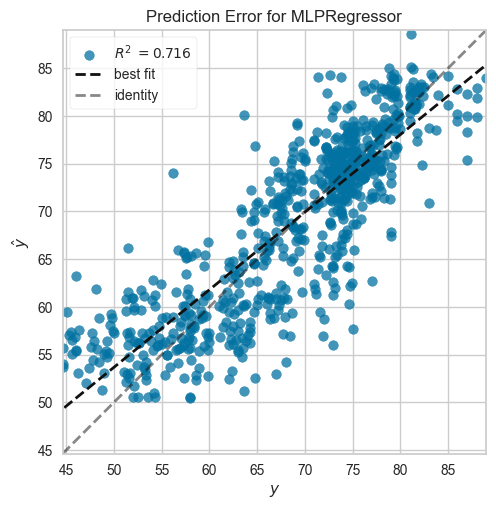

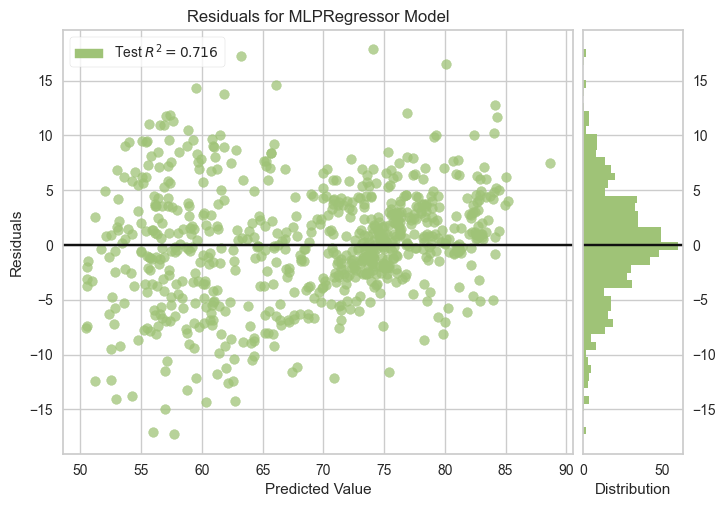

In [97]:
train_and_evaluate_model(MLPRegressor())

R2 Score: 0.9590529491737891
Mean Absolute Error: 1.2738622616411635
Mean Absolute Percentage Error: 0.019413993318950242
Root Mean Squared Error: 1.9604745268505075


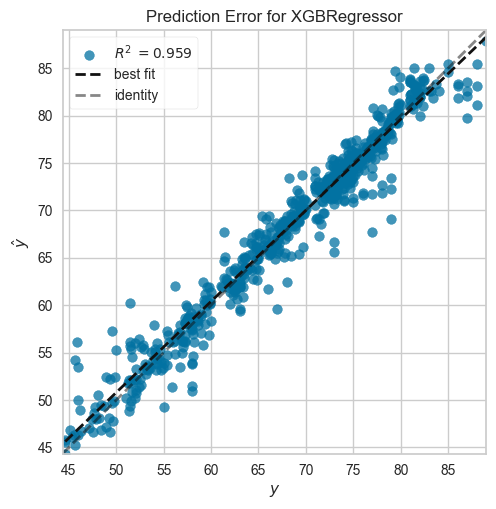

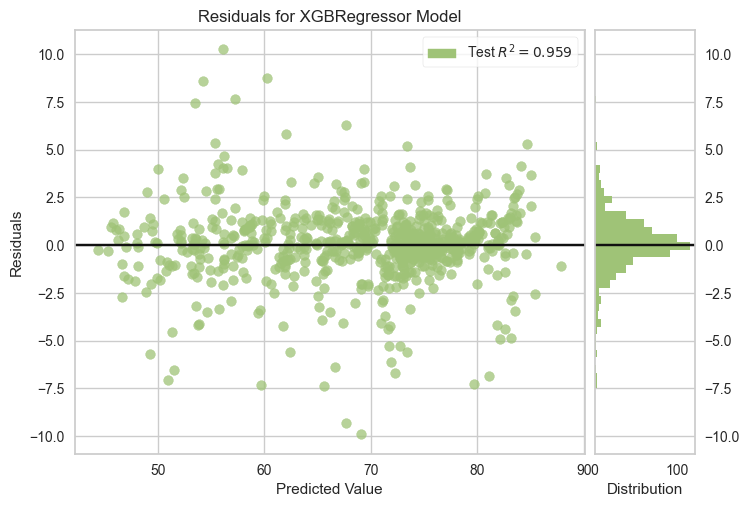

In [98]:
train_and_evaluate_model(XGBRegressor())

R2 Score: 0.9304493185085454
Mean Absolute Error: 1.7549410715844433
Mean Absolute Percentage Error: 0.026894774200695106
Root Mean Squared Error: 2.555056951245835


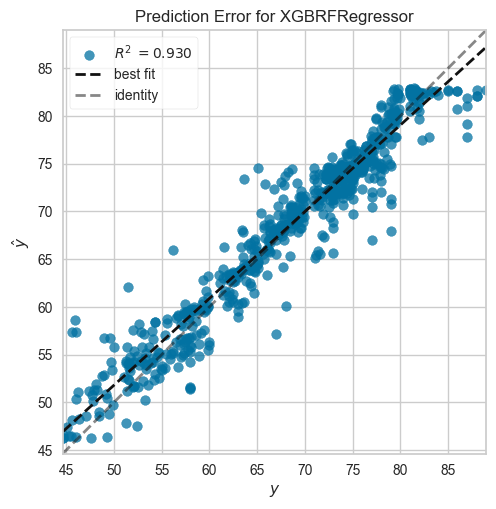

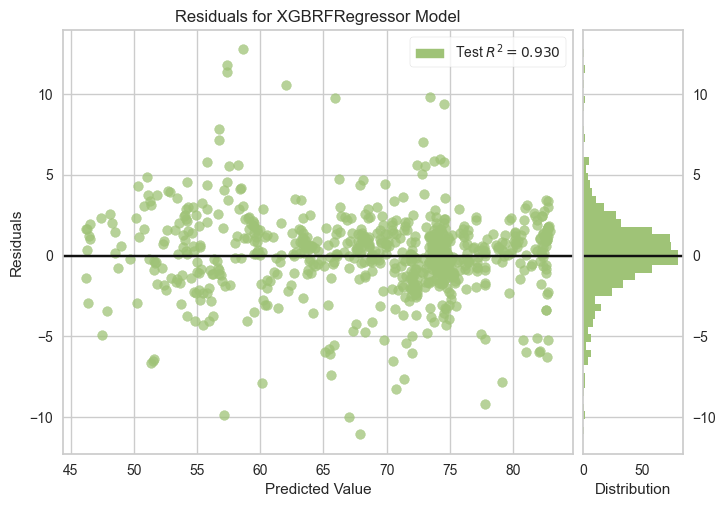

In [99]:
train_and_evaluate_model(XGBRFRegressor())

In [102]:
train_and_evaluate_model(CatBoostRegressor(silent=True))

R2 Score: 0.9620774551370573
Mean Absolute Error: 1.22060929866909
Mean Absolute Percentage Error: 0.018638346366061945
Root Mean Squared Error: 1.8866816558655775


R2 Score: 0.9566161528339396
Mean Absolute Error: 1.2776844523200053
Mean Absolute Percentage Error: 0.019588504708509258
Root Mean Squared Error: 2.0179663531506042


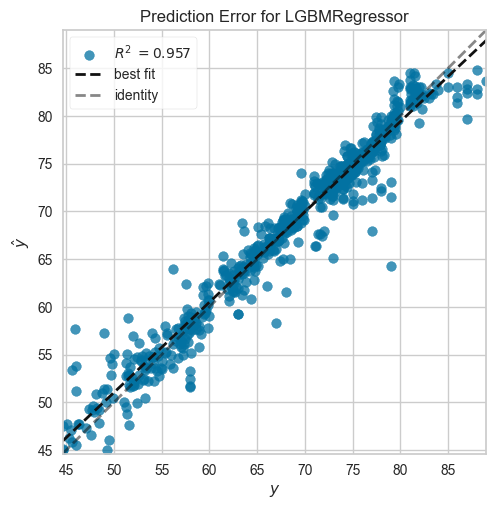

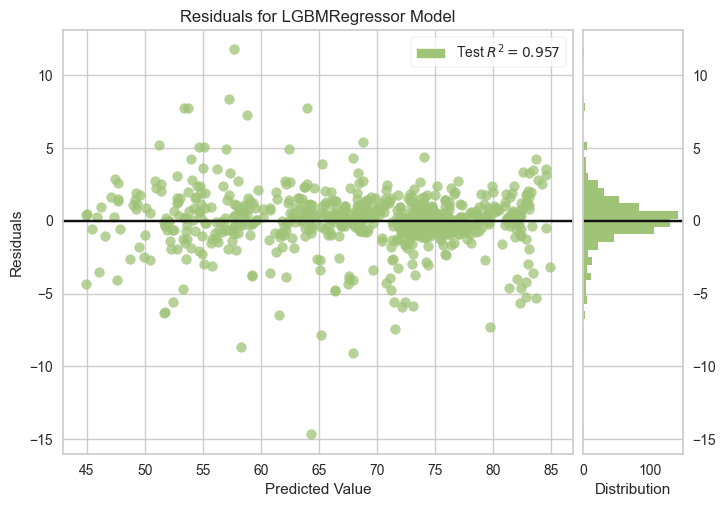

In [103]:
train_and_evaluate_model(LGBMRegressor())

[Voting] ...................... (1 of 2) Processing CAT, total=   2.3s
[Voting] ....................... (2 of 2) Processing ET, total=   0.8s
R2 Score: 0.9659866822431636
Mean Absolute Error: 1.0966672373346666
Mean Absolute Percentage Error: 0.01678756969562843
Root Mean Squared Error: 1.7867935995174982


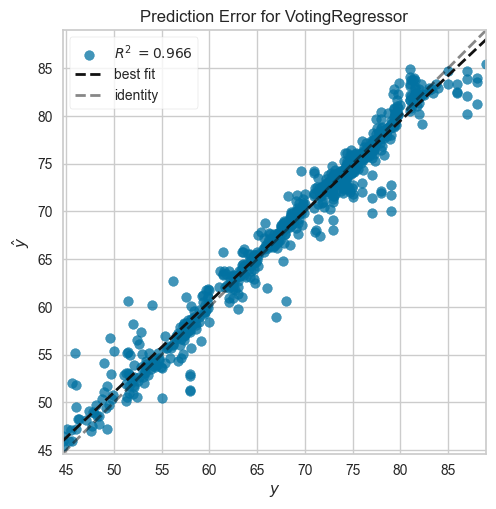

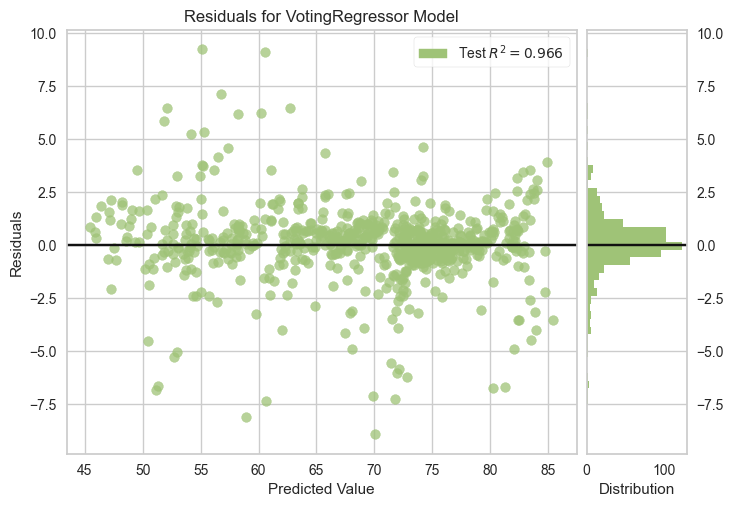

In [104]:
train_and_evaluate_model(VotingRegressor(estimators=[
    ('CAT',CatBoostRegressor(silent=True)),
    ('ET',ExtraTreesRegressor())
],verbose=2))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   12.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    3.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:    0.8s finished


R2 Score: 0.9645798268288843
Mean Absolute Error: 1.1396408255741317
Mean Absolute Percentage Error: 0.017470200267208726
Root Mean Squared Error: 1.8233717842193793


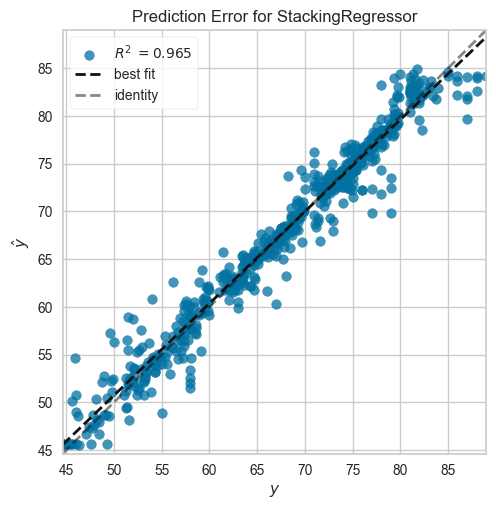

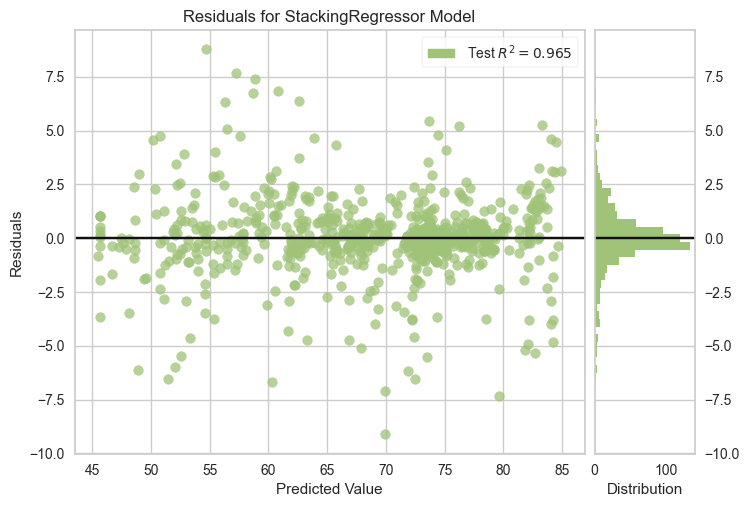

In [107]:
train_and_evaluate_model(StackingRegressor(estimators=[
    ('CAT',CatBoostRegressor(silent=True)),
    ('ET',ExtraTreesRegressor()),
    ('XGB',XGBRegressor()),
    ('RF',RandomForestRegressor())
],final_estimator=HistGradientBoostingRegressor(),verbose=2))

## Baseline Models Performance Comparison

In [108]:
model_perfs = pd.DataFrame({'model': models, 'R2': r2_scores, 'MAE': mae_scores, 'MAPE': mape_scores, 'RMSE': rmse_scores}).sort_values('R2',ascending=False).reset_index(drop=True)
model_perfs

,model,R2,MAE,MAPE,RMSE
0,"(ExtraTreeRegressor(random_state=1398445125), ...",0.966515,1.038201,0.015890,1.772873
1,"VotingRegressor(estimators=[('CAT',\n ...",0.965987,1.096667,0.016788,1.786794
2,"StackingRegressor(estimators=[('CAT',\n ...",0.964580,1.139641,0.017470,1.823372
3,<catboost.core.CatBoostRegressor object at 0x0...,0.962077,1.220609,0.018638,1.886682
4,<catboost.core.CatBoostRegressor object at 0x0...,0.962077,1.220609,0.018638,1.886682
5,"XGBRegressor(base_score=None, booster=None, ca...",0.959053,1.273862,0.019414,1.960475
6,"(DecisionTreeRegressor(max_features='auto', ra...",0.958025,1.230171,0.018891,1.984939
7,HistGradientBoostingRegressor(),0.957338,1.290225,0.019698,2.001104
8,LGBMRegressor(),0.956616,1.277684,0.019589,2.017966
9,"(DecisionTreeRegressor(random_state=81292947),...",0.953519,1.335232,0.020384,2.088747


The Extra Trees Regressor model has outperformed all other models by achieving an outstanding r2 score of more than 96.6%.  

## Hyperparameter Optimization & Cross Validation

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END algorithm=brute, metric=minkowski, n_neighbors=2, p=1, weights=distance; total time=   0.2s
[CV] END algorithm=brute, metric=minkowski, n_neighbors=2, p=1, weights=distance; total time=   0.0s
[CV] END algorithm=brute, metric=minkowski, n_neighbors=2, p=1, weights=distance; total time=   0.0s
[CV] END algorithm=brute, metric=minkowski, n_neighbors=2, p=1, weights=distance; total time=   0.0s
[CV] END algorithm=brute, metric=minkowski, n_neighbors=2, p=1, weights=distance; total time=   0.0s
[CV] END algorithm=ball_tree, metric=minkowski, n_neighbors=20, p=1, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=minkowski, n_neighbors=20, p=1, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=minkowski, n_neighbors=20, p=1, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=minkowski, n_neighbors=20, p=1, weights=uniform; total time=   0.0s
[CV] END algor

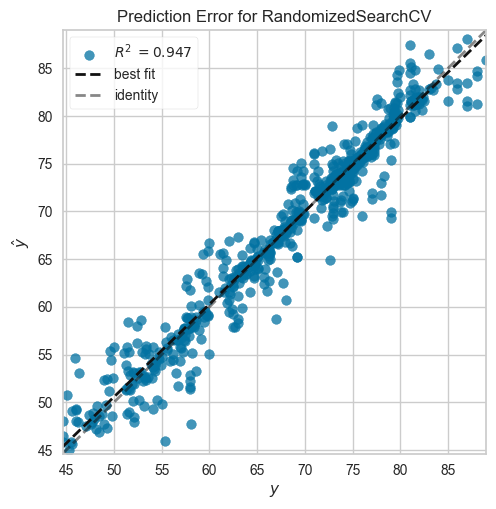

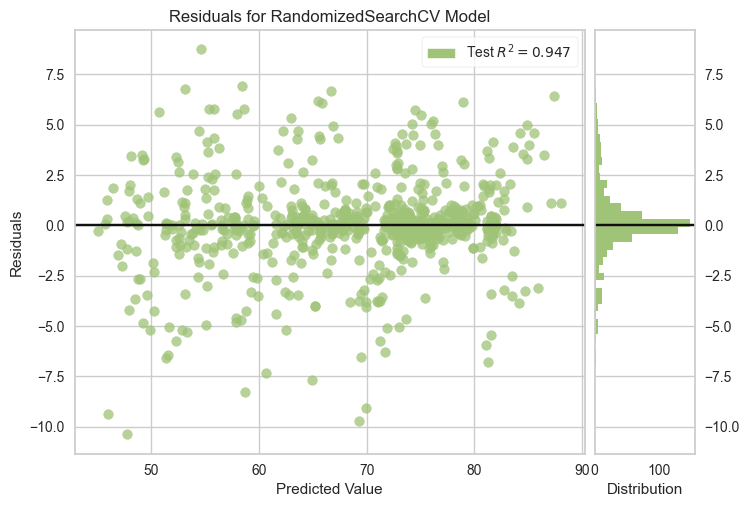

In [111]:
param_grid = {'n_neighbors': [2,8,12,20],
              'weights': ['uniform','distance'],
              'algorithm': ['ball_tree', 'brute'],
              'metric': ['minkowski','manhattan','euclidean','chebyshev'],
              'p': [1,2]
             }

grid_knn = RandomizedSearchCV(KNeighborsRegressor(),param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_knn)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END interaction_cst=pairwise, learning_rate=0.4, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.4, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.4, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.4, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.4, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=0.2, loss=poisson, max_bins=250; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=0.2, loss=poisson, max_bins=250; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=0.2, loss=poisson, max_bins=250; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=0.2, loss=poisson, max_bins=250; total time=   0.0s
[CV] END interac

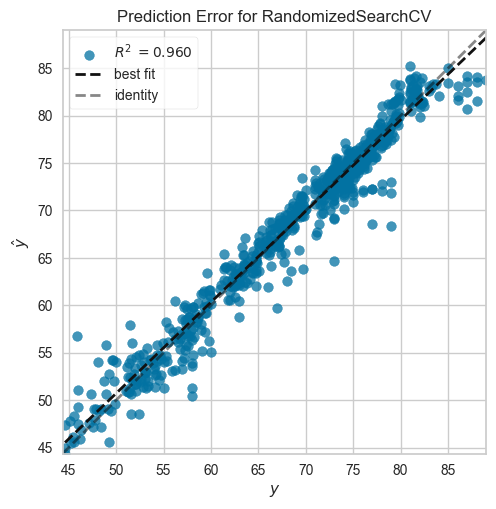

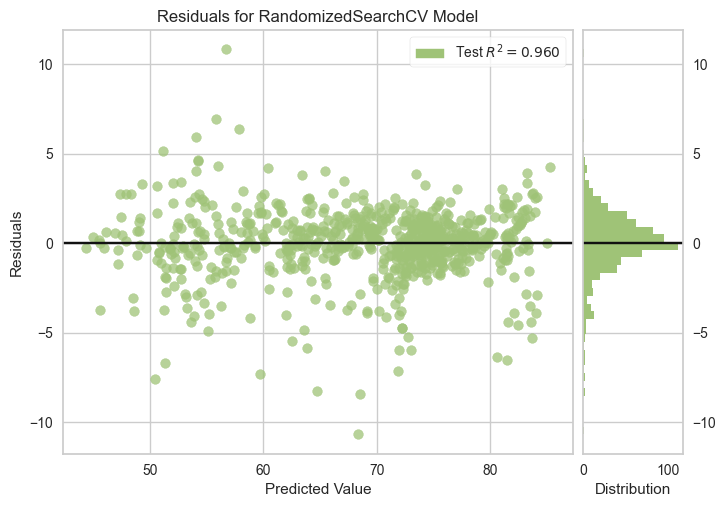

In [112]:
param_grid = {'learning_rate': [0.2,0.4,0.5,0.8,1.0],
              'loss': ['squared_error','absolute_error','poisson','quantile'],
              'max_bins': np.arange(0,255,50),
              'interaction_cst': ['pairwise','no_interaction']}

grid_hgb = RandomizedSearchCV(HistGradientBoostingRegressor(),param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_hgb)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
R2 Score: 0.8130081644046658
Mean Absolute Error: 3.136753326248989
Mean Absolute Percentage Error: 0.04874785429374977
Root Mean Squared Error: 4.189490523325227


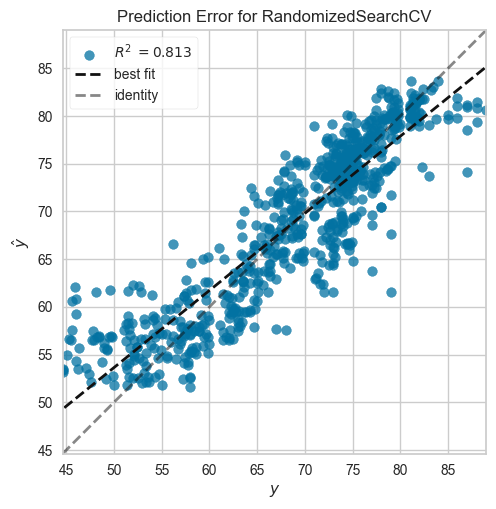

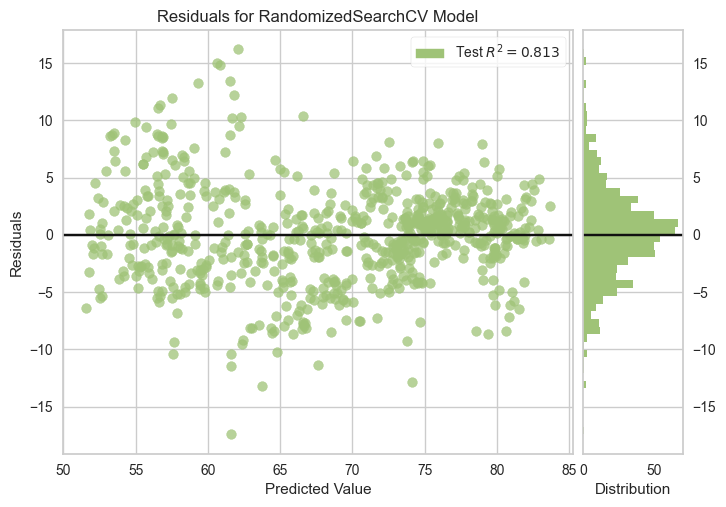

In [113]:
param_grid = {'loss': ['epsilon_insensitive','squared_epsilon_insensitive'],
             'C': [0.0001,0.001,0.01,0.1,1],
             'epsilon': np.linspace(0.001,1,5)}

grid_lsvr = RandomizedSearchCV(LinearSVR(),param_grid,cv=5,verbose=2,n_jobs=10)
train_and_evaluate_model(grid_lsvr)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END criterion=friedman_mse, max_features=log2, splitter=random; total time=   0.0s
[CV] END criterion=friedman_mse, max_features=log2, splitter=random; total time=   0.0s
[CV] END criterion=friedman_mse, max_features=log2, splitter=random; total time=   0.0s
[CV] END criterion=friedman_mse, max_features=log2, splitter=random; total time=   0.0s
[CV] END criterion=friedman_mse, max_features=log2, splitter=random; total time=   0.0s
[CV] END criterion=absolute_error, max_features=sqrt, splitter=best; total time=   0.1s
[CV] END criterion=absolute_error, max_features=sqrt, splitter=best; total time=   0.0s
[CV] END criterion=absolute_error, max_features=sqrt, splitter=best; total time=   0.0s
[CV] END criterion=absolute_error, max_features=sqrt, splitter=best; total time=   0.0s
[CV] END criterion=absolute_error, max_features=sqrt, splitter=best; total time=   0.0s
[CV] END criterion=absolute_error, max_features=sqrt, split

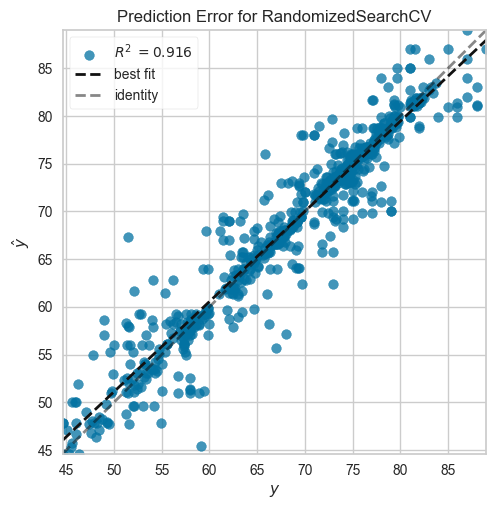

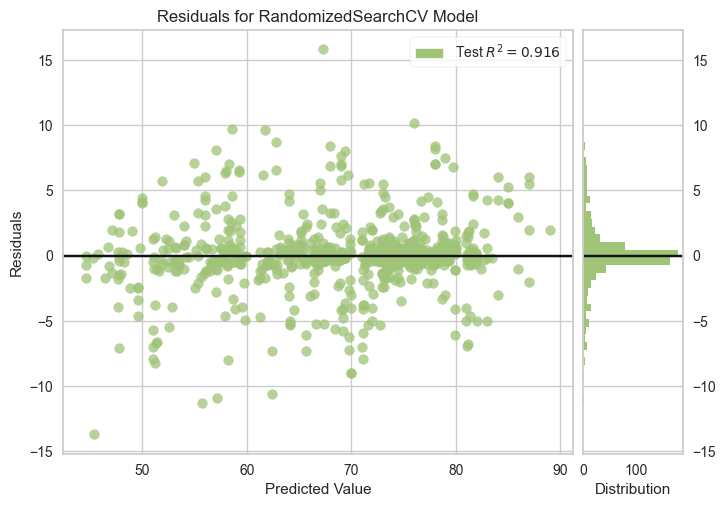

In [114]:
param_grid = {'criterion': ['squared_error','friedman_mse','absolute_error','poisson'],
              'splitter': ['best','random'],
              'max_features': ['sqrt','log2']
             }

grid_dt = RandomizedSearchCV(DecisionTreeRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_dt)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END criterion=squared_error, learning_rate=0.2, loss=huber, max_features=log2, n_estimators=1000;, score=0.954 total time=   5.4s
[CV 2/5] END criterion=squared_error, learning_rate=0.2, loss=huber, max_features=log2, n_estimators=1000;, score=0.947 total time=   4.8s
[CV 3/5] END criterion=squared_error, learning_rate=0.2, loss=huber, max_features=log2, n_estimators=1000;, score=0.952 total time=   5.8s
[CV 4/5] END criterion=squared_error, learning_rate=0.2, loss=huber, max_features=log2, n_estimators=1000;, score=0.952 total time=   4.9s
[CV 5/5] END criterion=squared_error, learning_rate=0.2, loss=huber, max_features=log2, n_estimators=1000;, score=0.954 total time=   6.1s
[CV 1/5] END criterion=squared_error, learning_rate=0.2, loss=squared_error, max_features=sqrt, n_estimators=700;, score=0.953 total time=   1.3s
[CV 2/5] END criterion=squared_error, learning_rate=0.2, loss=squared_error, max_features=sqrt, n_

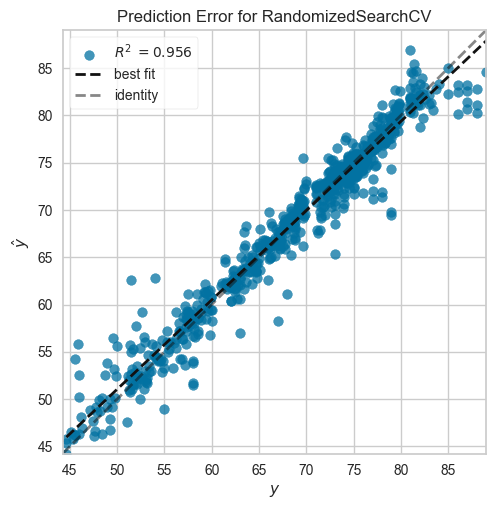

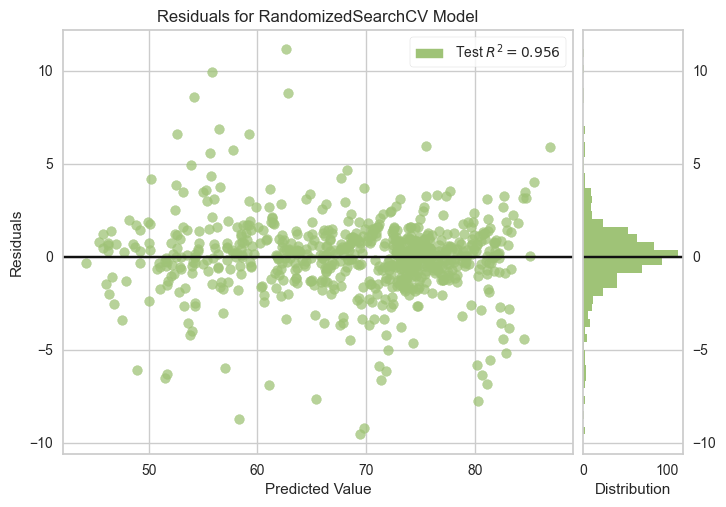

In [115]:
param_grid =  {'loss': ['squared_error','absolute_error','huber','quantile'],
                'n_estimators': [100,400,700,1000],
                'learning_rate': [0.2,0.4,0.7,1],
                'criterion': ['friedman_mse','squared_error'],
                'max_features': ['sqrt','log2']
                }
    
grid_gb = RandomizedSearchCV(GradientBoostingRegressor(),param_grid,verbose=4,cv=5)
train_and_evaluate_model(grid_gb)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END learning_rate=0.7, n_estimators=700;, score=0.946 total time=   1.6s
[CV 2/5] END learning_rate=0.7, n_estimators=700;, score=0.938 total time=   1.7s
[CV 3/5] END learning_rate=0.7, n_estimators=700;, score=0.934 total time=   1.7s
[CV 4/5] END learning_rate=0.7, n_estimators=700;, score=0.950 total time=   2.2s
[CV 5/5] END learning_rate=0.7, n_estimators=700;, score=0.952 total time=   1.9s
[CV 1/5] END learning_rate=0.4, n_estimators=400;, score=0.957 total time=   1.6s
[CV 2/5] END learning_rate=0.4, n_estimators=400;, score=0.947 total time=   1.2s
[CV 3/5] END learning_rate=0.4, n_estimators=400;, score=0.954 total time=   1.3s
[CV 4/5] END learning_rate=0.4, n_estimators=400;, score=0.954 total time=   1.3s
[CV 5/5] END learning_rate=0.4, n_estimators=400;, score=0.959 total time=   1.5s
[CV 1/5] END learning_rate=0.5, n_estimators=100;, score=0.952 total time=   0.6s
[CV 2/5] END learning_rate=0.5, n_est

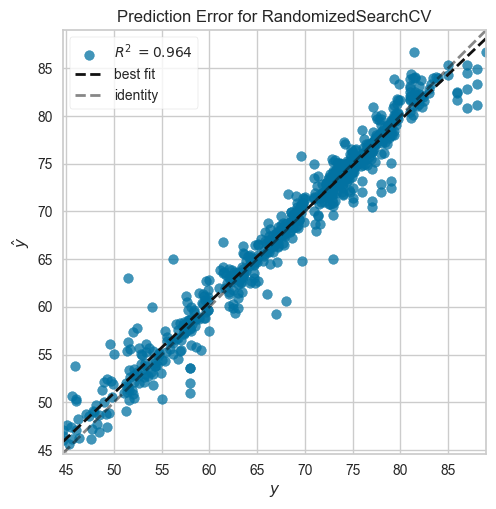

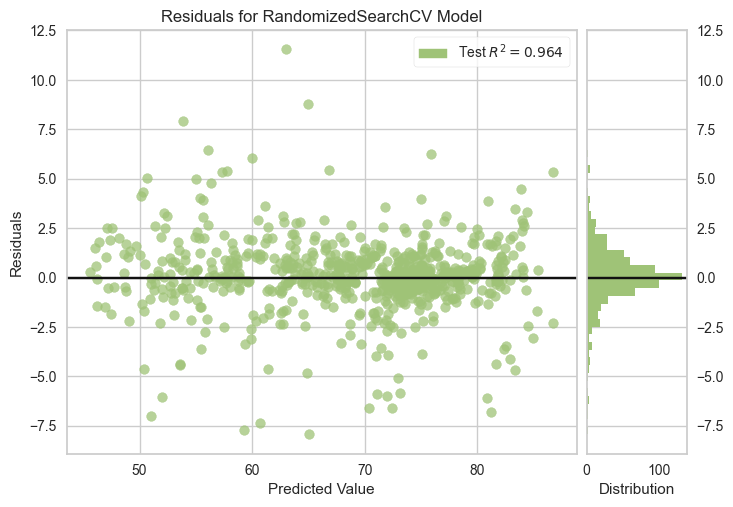

In [116]:
param_grid = {'learning_rate': [0.2,0.4,0.5,0.7,1],
'n_estimators': [100,400,700,800,1000]
}
    
grid_cat = RandomizedSearchCV(CatBoostRegressor(silent=True),param_grid,verbose=5,cv=5)
train_and_evaluate_model(grid_cat)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END boosting_type=rf, importance_type=gain, learning_rate=1.0, min_split_gain=0.68, n_estimators=800;, score=nan total time=   0.0s
[CV 2/5] END boosting_type=rf, importance_type=gain, learning_rate=1.0, min_split_gain=0.68, n_estimators=800;, score=nan total time=   0.0s
[CV 3/5] END boosting_type=rf, importance_type=gain, learning_rate=1.0, min_split_gain=0.68, n_estimators=800;, score=nan total time=   0.0s
[CV 4/5] END boosting_type=rf, importance_type=gain, learning_rate=1.0, min_split_gain=0.68, n_estimators=800;, score=nan total time=   0.0s
[CV 5/5] END boosting_type=rf, importance_type=gain, learning_rate=1.0, min_split_gain=0.68, n_estimators=800;, score=nan total time=   0.0s
[CV 1/5] END boosting_type=gbdt, importance_type=gain, learning_rate=0.6000000000000001, min_split_gain=0.87, n_estimators=100;, score=0.950 total time=   0.0s
[CV 2/5] END boosting_type=gbdt, importance_type=gain, learning_rate=0.600

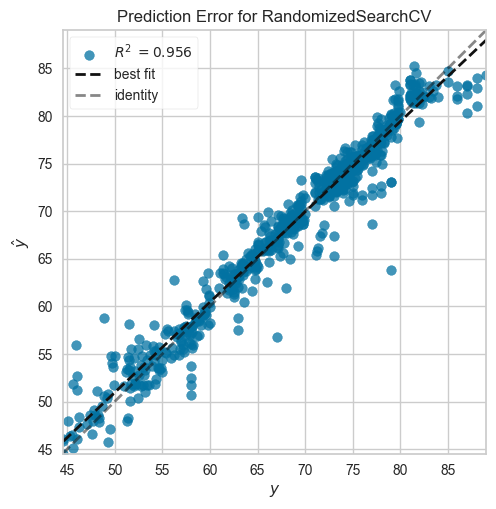

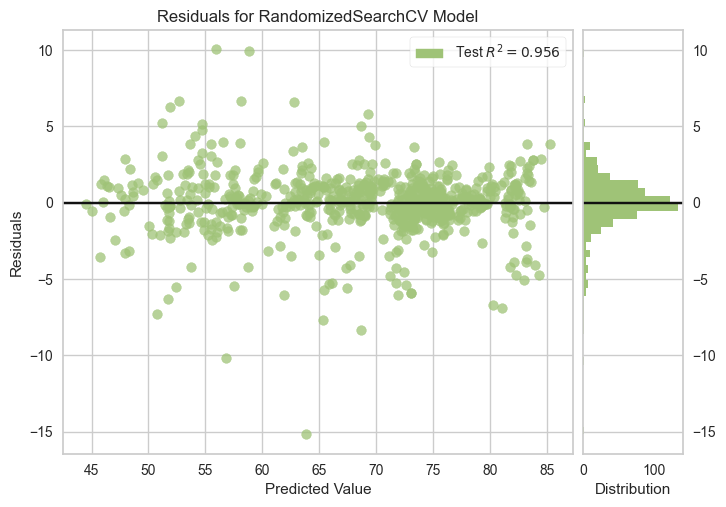

In [117]:
param_grid = {'boosting_type': ['gbdt','dart','goss','rf'],
            'learning_rate': np.linspace(0,1,6)[1:],
            'n_estimators': [100,300,500,800,1000],
            'importance_type': ['split','gain'],
            'min_split_gain': [0.68,0.79,0.87,1]}

grid_lgbm = RandomizedSearchCV(LGBMRegressor(),param_grid,verbose=3,cv=5)
train_and_evaluate_model(grid_lgbm)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[23:40:34] WARNING: C:\Users\dev-admin\croot2\xgboost-split_1675461376218\work\src\learner.cc:767: 
Parameters: { "grow_policy", "sampling_method" } are not used.

[CV 1/5] END booster=gblinear, grow_policy=1, importance_type=total_cover, learning_rate=1, n_estimators=400, sampling_method=uniform;, score=-175931357493863641387248910336.000 total time=   0.1s
[23:40:34] WARNING: C:\Users\dev-admin\croot2\xgboost-split_1675461376218\work\src\learner.cc:767: 
Parameters: { "grow_policy", "sampling_method" } are not used.

[CV 2/5] END booster=gblinear, grow_policy=1, importance_type=total_cover, learning_rate=1, n_estimators=400, sampling_method=uniform;, score=-8544427.986 total time=   0.0s
[23:40:34] WARNING: C:\Users\dev-admin\croot2\xgboost-split_1675461376218\work\src\learner.cc:767: 
Parameters: { "grow_policy", "sampling_method" } are not used.

[CV 3/5] END booster=gblinear, grow_policy=1, importance_type=total_cover, l

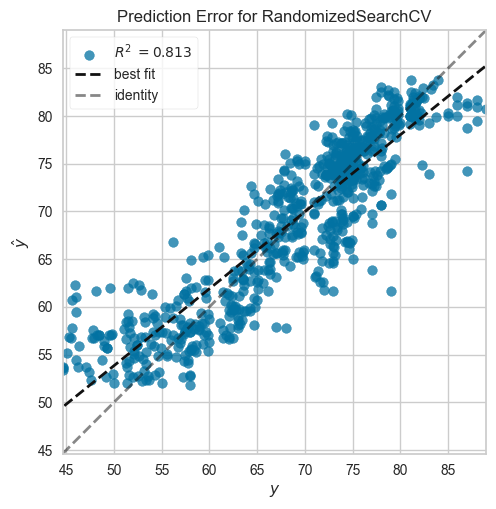

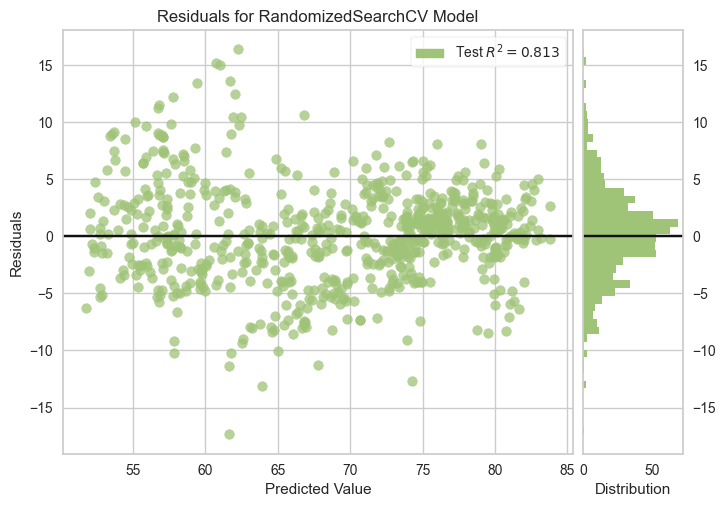

In [118]:
param_grid = {'n_estimators': [100,400,700,1000],
        'grow_policy': [0,1],
        'learning_rate': [0.1,0.4,0.7,1],
        'booster': ['gbtree','gblinear','dart'],
        'sampling_method': ['uniform','gradient_based'],
        'importance_type': ['gain','weight','cover','total_gain','total_cover']
}

grid_xgb = RandomizedSearchCV(XGBRegressor(),param_grid,verbose=3,cv=5)
train_and_evaluate_model(grid_xgb)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END alpha=0.001, average=True, epsilon=11.111999999999998, l1_ratio=0.81, learning_rate=adaptive, loss=squared_epsilon_insensitive, penalty=elasticnet, shuffle=False;, score=0.786 total time=   0.0s
[CV 2/5] END alpha=0.001, average=True, epsilon=11.111999999999998, l1_ratio=0.81, learning_rate=adaptive, loss=squared_epsilon_insensitive, penalty=elasticnet, shuffle=False;, score=0.745 total time=   0.0s
[CV 3/5] END alpha=0.001, average=True, epsilon=11.111999999999998, l1_ratio=0.81, learning_rate=adaptive, loss=squared_epsilon_insensitive, penalty=elasticnet, shuffle=False;, score=0.786 total time=   0.0s
[CV 4/5] END alpha=0.001, average=True, epsilon=11.111999999999998, l1_ratio=0.81, learning_rate=adaptive, loss=squared_epsilon_insensitive, penalty=elasticnet, shuffle=False;, score=0.804 total time=   0.0s
[CV 5/5] END alpha=0.001, average=True, epsilon=11.111999999999998, l1_ratio=0.81, learning_rate=adaptive, 

[CV 1/5] END alpha=0.0001, average=False, epsilon=0.001, l1_ratio=0.15, learning_rate=optimal, loss=squared_epsilon_insensitive, penalty=l2, shuffle=True;, score=0.745 total time=   0.0s
[CV 2/5] END alpha=0.0001, average=False, epsilon=0.001, l1_ratio=0.15, learning_rate=optimal, loss=squared_epsilon_insensitive, penalty=l2, shuffle=True;, score=0.477 total time=   0.0s
[CV 3/5] END alpha=0.0001, average=False, epsilon=0.001, l1_ratio=0.15, learning_rate=optimal, loss=squared_epsilon_insensitive, penalty=l2, shuffle=True;, score=0.602 total time=   0.0s
[CV 4/5] END alpha=0.0001, average=False, epsilon=0.001, l1_ratio=0.15, learning_rate=optimal, loss=squared_epsilon_insensitive, penalty=l2, shuffle=True;, score=0.705 total time=   0.0s
[CV 5/5] END alpha=0.0001, average=False, epsilon=0.001, l1_ratio=0.15, learning_rate=optimal, loss=squared_epsilon_insensitive, penalty=l2, shuffle=True;, score=0.726 total time=   0.0s
R2 Score: 0.8127836215632981
Mean Absolute Error: 3.1387016176329

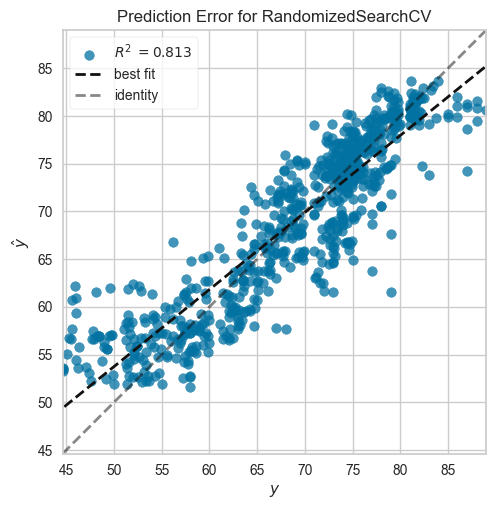

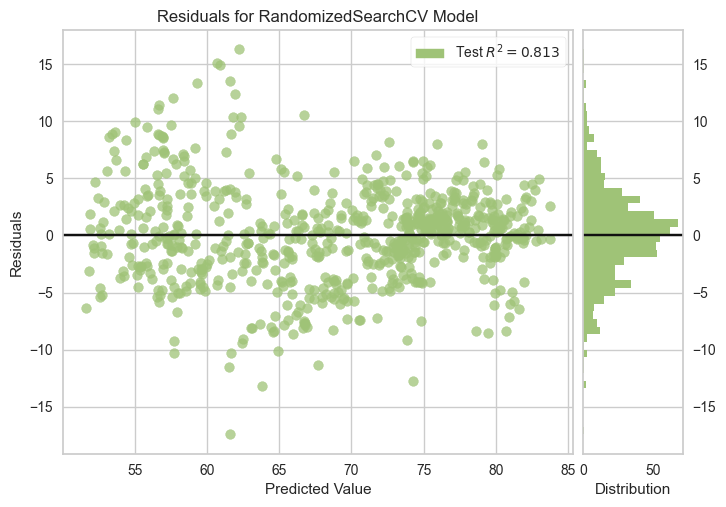

In [119]:
param_grid = {'loss': ['squared_error','huber','epsilon_insensitive','squared_epsilon_insensitive'],
'penalty': ['l2', 'l1', 'elasticnet'],
'l1_ratio': [0.15,0.45,0.68,0.81,0.97],
'alpha': [0.0001,0.001,0.01,0.1,1],
'shuffle': [True,False],
'learning_rate': ['adaptive','constant','optimal','invscaling'],
'epsilon': np.linspace(0.001,100,10),
'average': [True,False]
}

grid_sgd = RandomizedSearchCV(SGDRegressor(),param_grid,verbose=3,cv=5)
train_and_evaluate_model(grid_sgd)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END ............................alpha=10.0, epsilon=2.0; total time=   0.0s
[CV] END ............................alpha=10.0, epsilon=2.0; total time=   0.0s
[CV] END ............................alpha=10.0, epsilon=2.0; total time=   0.0s
[CV] END ............................alpha=10.0, epsilon=2.0; total time=   0.0s
[CV] END ............................alpha=10.0, epsilon=2.0; total time=   0.0s
[CV] END ..........................alpha=4.4445, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=4.4445, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=4.4445, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=4.4445, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=4.4445, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=0.0001, epsilon=9.0; total time=   0.0s
[CV] END ..........................alpha=0.0001,

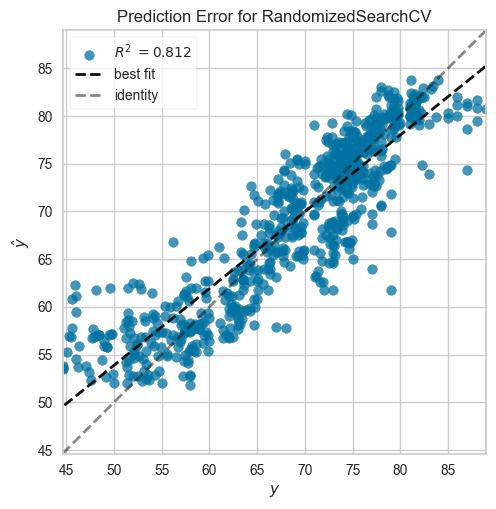

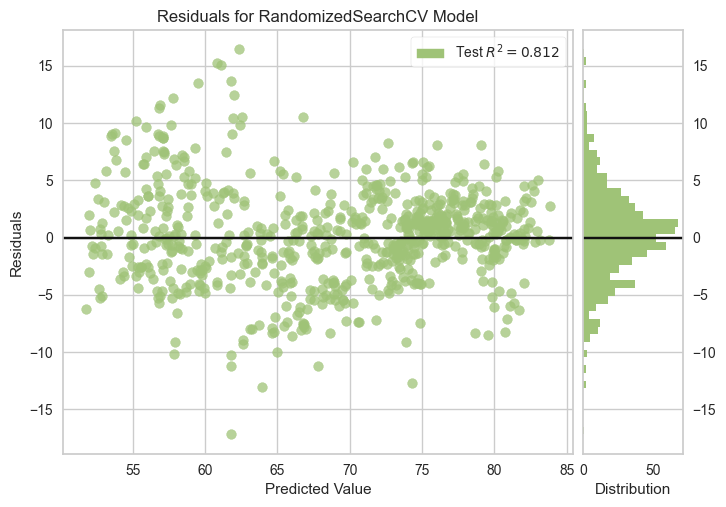

In [120]:
param_grid = {'epsilon': np.linspace(1,10,10),
'alpha': np.linspace(0.0001,10,10)}

grid_huber = RandomizedSearchCV(HuberRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_huber)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END ....alpha=3.3334, link=auto, solver=newton-cholesky; total time=   0.0s
[CV] END ....alpha=3.3334, link=auto, solver=newton-cholesky; total time=   0.0s
[CV] END ....alpha=3.3334, link=auto, solver=newton-cholesky; total time=   0.0s
[CV] END ....alpha=3.3334, link=auto, solver=newton-cholesky; total time=   0.0s
[CV] END ....alpha=3.3334, link=auto, solver=newton-cholesky; total time=   0.0s
[CV] END ..............alpha=4.4445, link=auto, solver=lbfgs; total time=   0.0s
[CV] END ..............alpha=4.4445, link=auto, solver=lbfgs; total time=   0.0s
[CV] END ..............alpha=4.4445, link=auto, solver=lbfgs; total time=   0.0s
[CV] END ..............alpha=4.4445, link=auto, solver=lbfgs; total time=   0.0s
[CV] END ..............alpha=4.4445, link=auto, solver=lbfgs; total time=   0.0s
[CV] END ....alpha=5.5556, link=auto, solver=newton-cholesky; total time=   0.0s
[CV] END ....alpha=5.5556, link=auto, solver=new

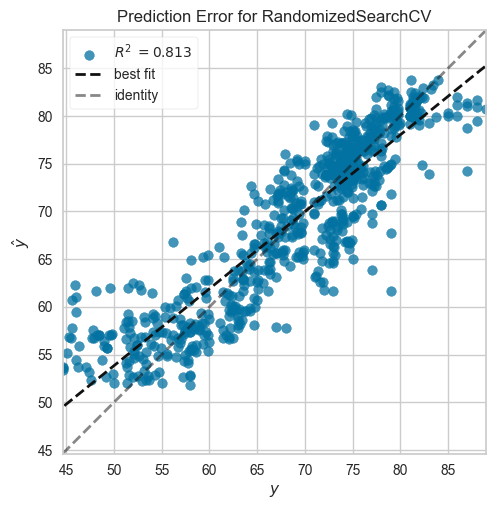

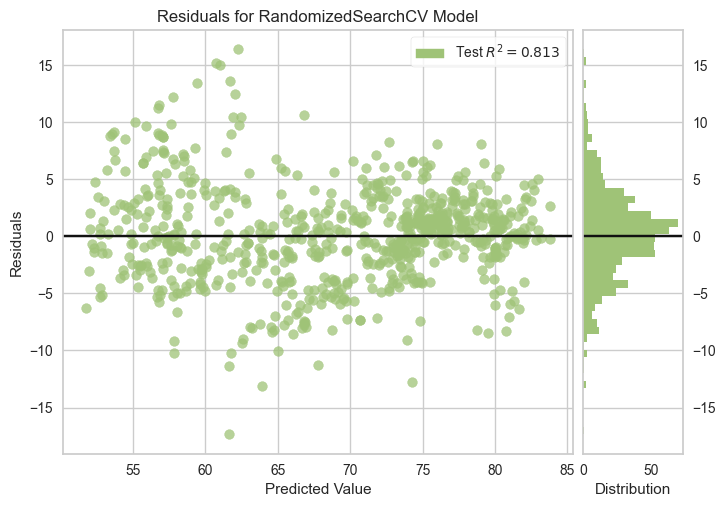

In [121]:
param_grid = {'link': ['auto', 'identity', 'log'],
'solver': ['lbfgs', 'newton-cholesky'],
'alpha': np.linspace(0.0001,10,10)}

grid_tweedie = RandomizedSearchCV(TweedieRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_tweedie)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END C=1, average=False, epsilon=0.001, loss=epsilon_insensitive, shuffle=False; total time=   0.0s
[CV] END C=1, average=False, epsilon=0.001, loss=epsilon_insensitive, shuffle=False; total time=   0.0s
[CV] END C=1, average=False, epsilon=0.001, loss=epsilon_insensitive, shuffle=False; total time=   0.0s
[CV] END C=1, average=False, epsilon=0.001, loss=epsilon_insensitive, shuffle=False; total time=   0.0s
[CV] END C=1, average=False, epsilon=0.001, loss=epsilon_insensitive, shuffle=False; total time=   0.0s
[CV] END C=0.0001, average=False, epsilon=0.75025, loss=epsilon_insensitive, shuffle=True; total time=   0.0s
[CV] END C=0.0001, average=False, epsilon=0.75025, loss=epsilon_insensitive, shuffle=True; total time=   0.0s
[CV] END C=0.0001, average=False, epsilon=0.75025, loss=epsilon_insensitive, shuffle=True; total time=   0.0s
[CV] END C=0.0001, average=False, epsilon=0.75025, loss=epsilon_insensitive, shuffle=True

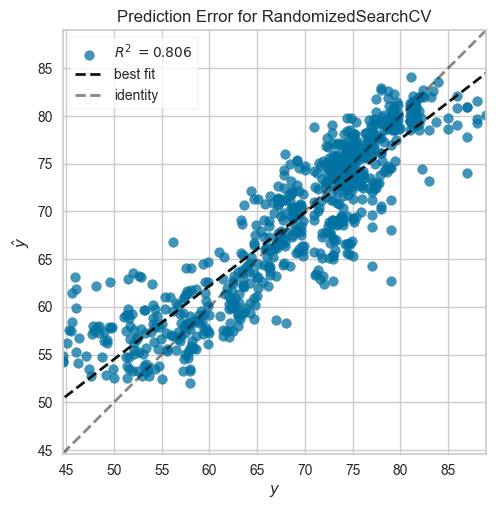

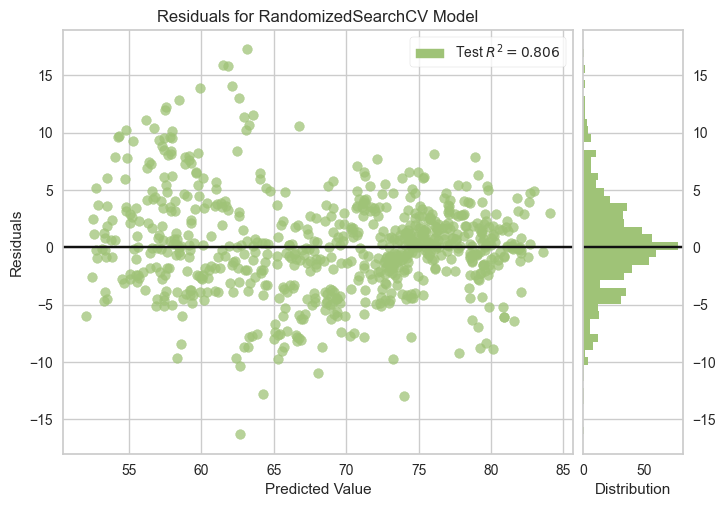

In [126]:
param_grid = {'C': [0.0001,0.001,0.01,0.1,1,10],
            'loss': ['epsilon_insensitive','squared_epsilon_insensitive'],
            'epsilon': np.linspace(0.001,1,5),
            'shuffle': [True,False],
            'average': [True,False]}

grid_pa = RandomizedSearchCV(PassiveAggressiveRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_pa)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha=0.01, fit_intercept=False, positive=False, selection=random; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, positive=False, selection=random; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, positive=False, selection=random; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, positive=False, selection=random; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, positive=False, selection=random; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=False, positive=True, selection=random; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=False, positive=True, selection=random; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=False, positive=True, selection=random; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=False, positive=True, selection=random; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=False, positive=True, selection=random; total time=   0.0s

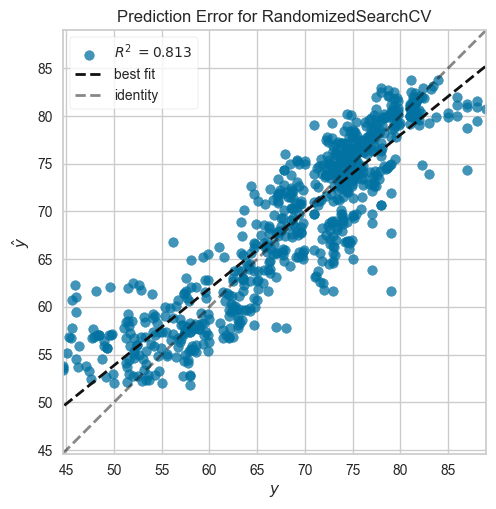

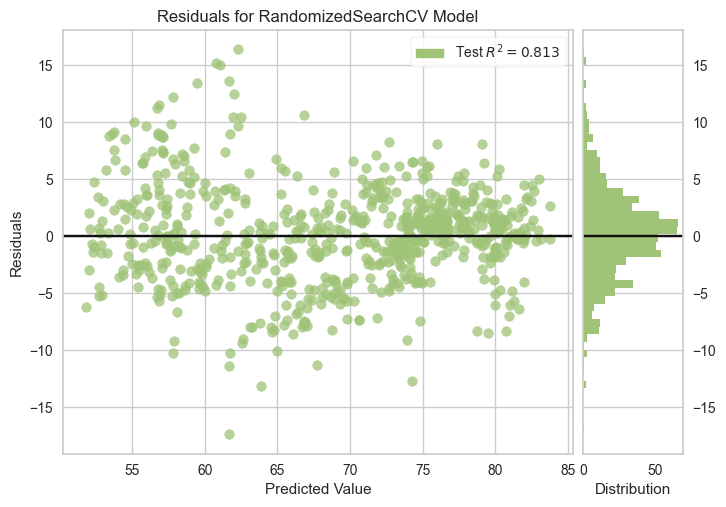

In [127]:
param_grid = {
'alpha': [0.001,0.01,0.1],
'positive': [True,False],
'selection': ['cyclic','random'],
'fit_intercept': [True,False]
}

grid_lasso = RandomizedSearchCV(Lasso(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_lasso)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha=0.01, fit_intercept=True, positive=False, solver=saga; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=True, positive=False, solver=saga; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=True, positive=False, solver=saga; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=True, positive=False, solver=saga; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=True, positive=False, solver=saga; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, positive=True, solver=sag; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, positive=True, solver=sag; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, positive=True, solver=sag; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, positive=True, solver=sag; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, positive=True, solver=sag; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=True, positive=Fal

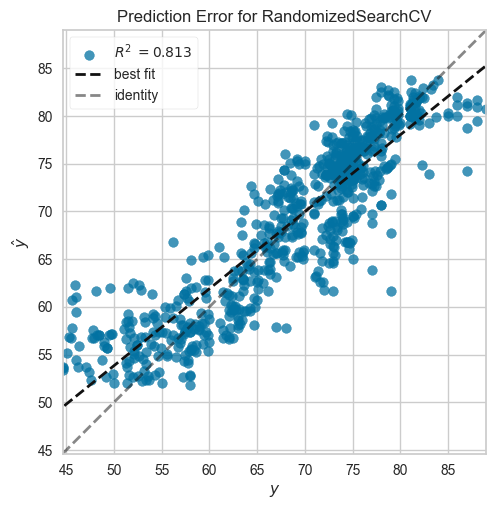

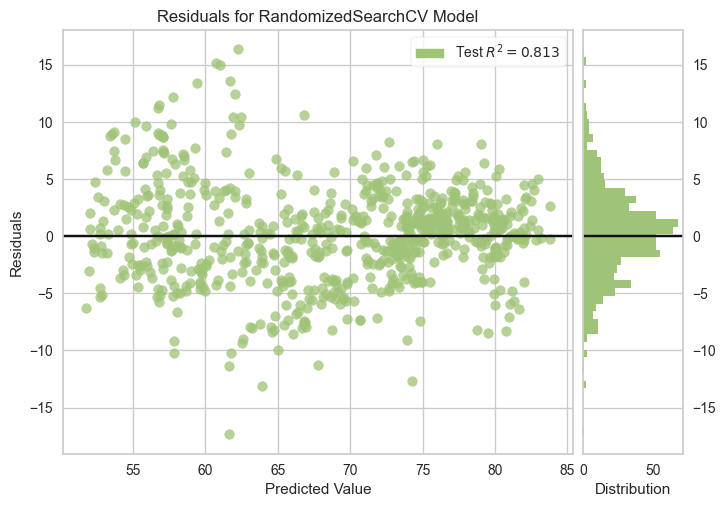

In [128]:
param_grid = {
'alpha': [0.001,0.01,0.1],
'positive': [True,False],
'fit_intercept': [True,False],
'solver': ['svd','cholesky','lsqr','sparse_cg','sag','saga','lbfgs']
}

grid_ridge = RandomizedSearchCV(Ridge(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_ridge)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha=0.01, fit_intercept=True, l1_ratio=0.1, positive=False, selection=cyclic; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=True, l1_ratio=0.1, positive=False, selection=cyclic; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=True, l1_ratio=0.1, positive=False, selection=cyclic; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=True, l1_ratio=0.1, positive=False, selection=cyclic; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=True, l1_ratio=0.1, positive=False, selection=cyclic; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=True, l1_ratio=0.8, positive=True, selection=cyclic; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=True, l1_ratio=0.8, positive=True, selection=cyclic; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=True, l1_ratio=0.8, positive=True, selection=cyclic; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=True, l1_ratio=0.8, positive=True, selection=cy

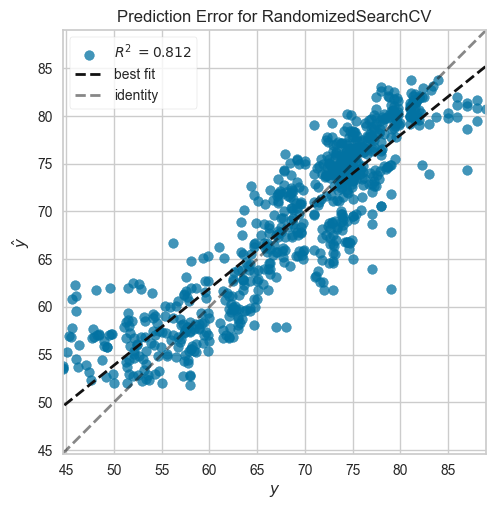

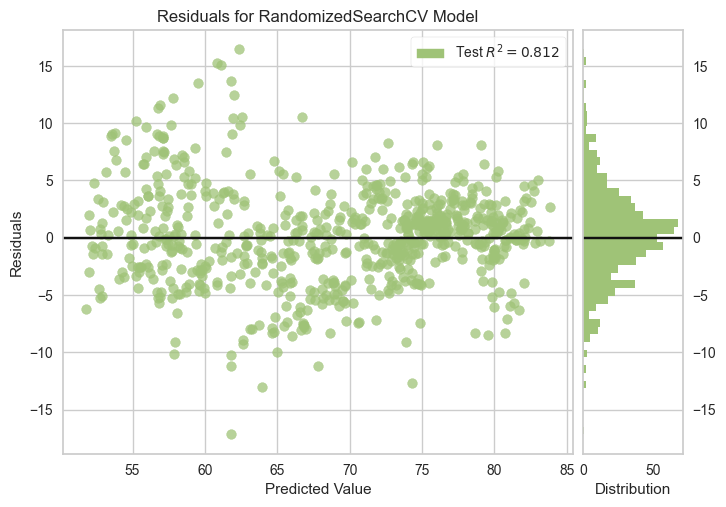

In [129]:
param_grid = {
    'alpha': [0.001,0.01,0.1],
    'selection': ['cyclic','random'],
    'l1_ratio': [0.1,0.3,0.5,0.8,1],
    'positive': [True,False],
    'fit_intercept': [True,False]
}

grid_elasticnet = RandomizedSearchCV(ElasticNet(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_elasticnet)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha_1=1e-05, alpha_2=1e-08, compute_score=False, fit_intercept=False, lambda_1=1e-06, lambda_2=1e-08; total time=   0.1s
[CV] END alpha_1=1e-05, alpha_2=1e-08, compute_score=False, fit_intercept=False, lambda_1=1e-06, lambda_2=1e-08; total time=   0.0s
[CV] END alpha_1=1e-05, alpha_2=1e-08, compute_score=False, fit_intercept=False, lambda_1=1e-06, lambda_2=1e-08; total time=   0.0s
[CV] END alpha_1=1e-05, alpha_2=1e-08, compute_score=False, fit_intercept=False, lambda_1=1e-06, lambda_2=1e-08; total time=   0.0s
[CV] END alpha_1=1e-05, alpha_2=1e-08, compute_score=False, fit_intercept=False, lambda_1=1e-06, lambda_2=1e-08; total time=   0.0s
[CV] END alpha_1=1e-07, alpha_2=1e-08, compute_score=True, fit_intercept=True, lambda_1=1e-07, lambda_2=1e-06; total time=   0.0s
[CV] END alpha_1=1e-07, alpha_2=1e-08, compute_score=True, fit_intercept=True, lambda_1=1e-07, lambda_2=1e-06; total time=   0.0s
[CV] END alpha_1=1e

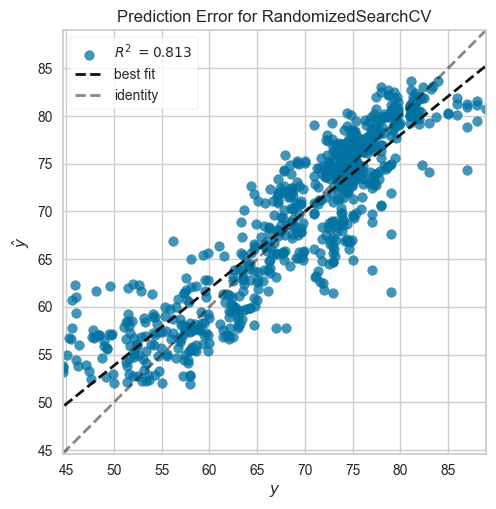

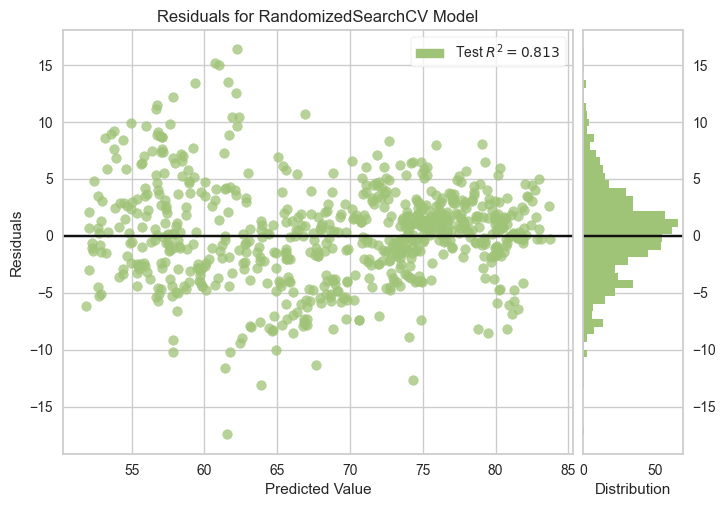

In [130]:
param_grid = {'alpha_1': [1e-5,1e-6,1e-7,1e-8],
'alpha_2': [1e-5,1e-6,1e-7,1e-8],
'lambda_1': [1e-5,1e-6,1e-7,1e-8],
'lambda_2': [1e-5,1e-6,1e-7,1e-8],
'fit_intercept': [True,False],
'compute_score': [True,False]}

grid_ard = RandomizedSearchCV(ARDRegression(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_ard)

Fitting 5 folds for each of 4 candidates, totalling 20 fits
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=False, positive=True; total time=   0.0s
[CV] END .................fit_intercept=False, po

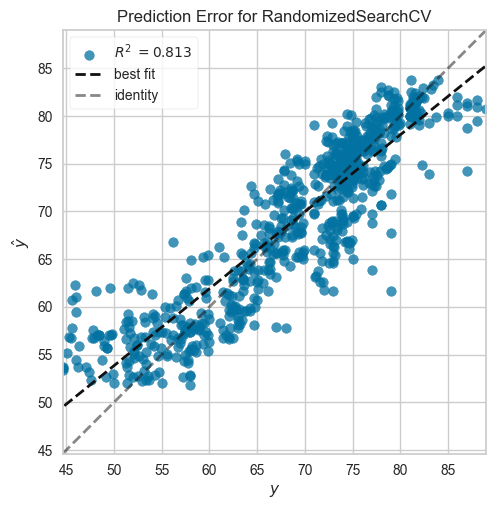

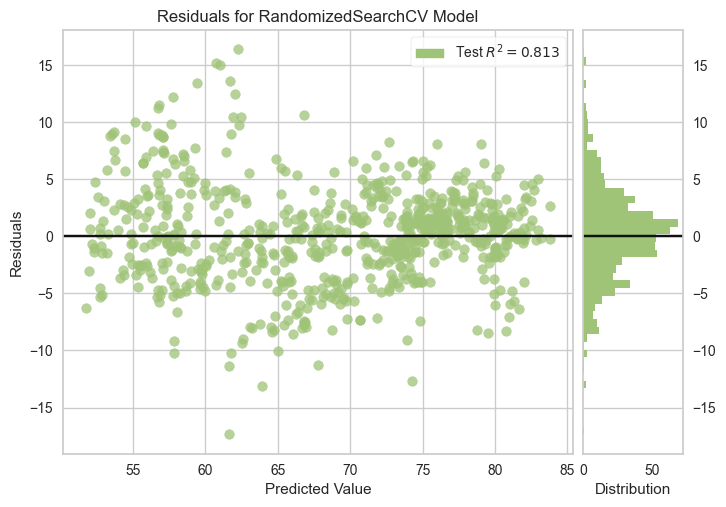

In [131]:
param_grid = {'fit_intercept': [True,False],
'positive': [True,False]}

grid_lr = RandomizedSearchCV(LinearRegression(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_lr)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha=0.1, fit_intercept=False, solver=lbfgs, warm_start=True; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=False, solver=lbfgs, warm_start=True; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=False, solver=lbfgs, warm_start=True; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=False, solver=lbfgs, warm_start=True; total time=   0.0s
[CV] END alpha=0.1, fit_intercept=False, solver=lbfgs, warm_start=True; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_start=True; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_start=True; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_start=True; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_start=True; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_

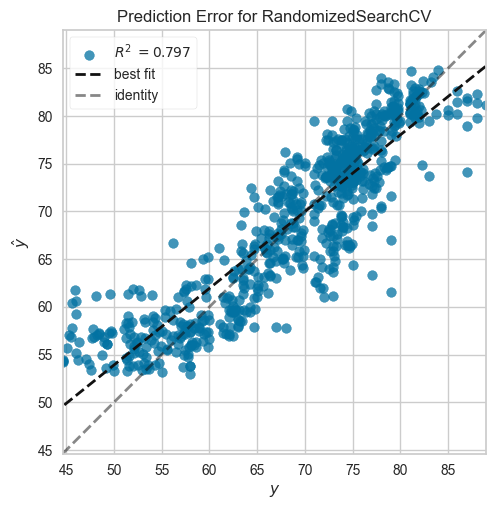

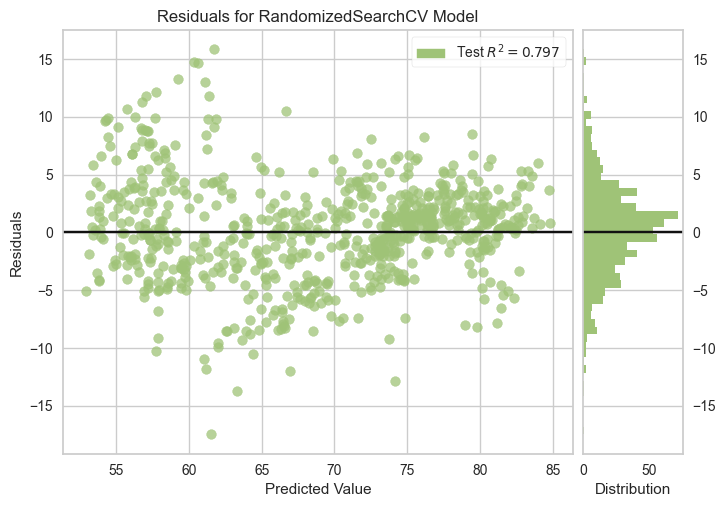

In [132]:
param_grid = {
    'alpha': [0.001,0.01,0.1],
    'fit_intercept': [True,False],
    'solver': ['lbfgs','newton-cholesky'],
    'warm_start': [True,False]
}

grid_poisson = RandomizedSearchCV(estimator=PoissonRegressor(),param_distributions=param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_poisson)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END loss=squared_error, min_samples=0.75, stop_probability=1.0; total time=   0.2s
[CV] END loss=squared_error, min_samples=0.75, stop_probability=1.0; total time=   0.2s
[CV] END loss=squared_error, min_samples=0.75, stop_probability=1.0; total time=   0.2s
[CV] END loss=squared_error, min_samples=0.75, stop_probability=1.0; total time=   0.2s
[CV] END loss=squared_error, min_samples=0.75, stop_probability=1.0; total time=   0.2s
[CV] END loss=absolute_error, min_samples=0.25, stop_probability=0.75; total time=   0.1s
[CV] END loss=absolute_error, min_samples=0.25, stop_probability=0.75; total time=   0.1s
[CV] END loss=absolute_error, min_samples=0.25, stop_probability=0.75; total time=   0.2s
[CV] END loss=absolute_error, min_samples=0.25, stop_probability=0.75; total time=   0.2s
[CV] END loss=absolute_error, min_samples=0.25, stop_probability=0.75; total time=   0.2s
[CV] END loss=absolute_error, min_samples=0.75, s

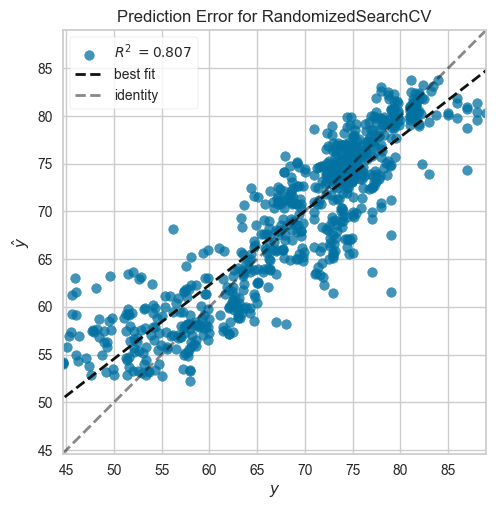

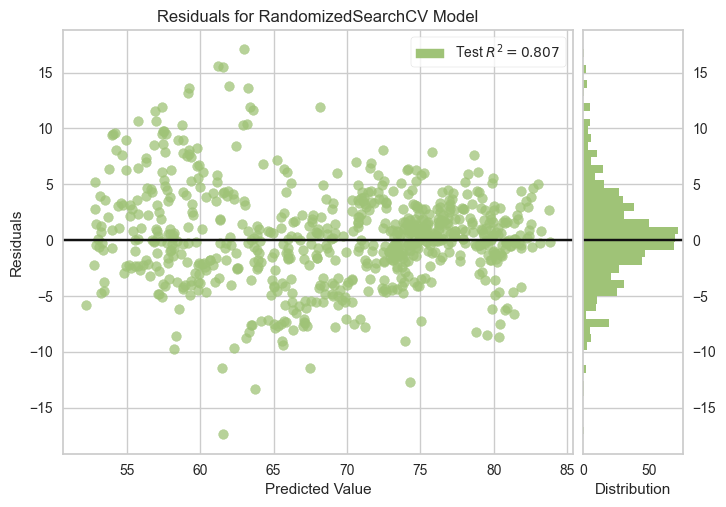

In [133]:
param_grid = {
    'stop_probability': np.linspace(0,1,5),
    'loss': ['absolute_error','squared_error'],
    'min_samples': np.linspace(0,1,5)[1:]
}

grid_ransac = RandomizedSearchCV(estimator=RANSACRegressor(),param_distributions=param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_ransac)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END bootstrap=True, criterion=poisson, max_features=sqrt, max_samples=0.25, n_estimators=1000, oob_score=False, warm_start=False; total time=   4.7s
[CV] END bootstrap=True, criterion=poisson, max_features=sqrt, max_samples=0.25, n_estimators=1000, oob_score=False, warm_start=False; total time=   4.7s
[CV] END bootstrap=True, criterion=poisson, max_features=sqrt, max_samples=0.25, n_estimators=1000, oob_score=False, warm_start=False; total time=   4.1s
[CV] END bootstrap=True, criterion=poisson, max_features=sqrt, max_samples=0.25, n_estimators=1000, oob_score=False, warm_start=False; total time=   4.3s
[CV] END bootstrap=True, criterion=poisson, max_features=sqrt, max_samples=0.25, n_estimators=1000, oob_score=False, warm_start=False; total time=   4.4s
[CV] END bootstrap=False, criterion=absolute_error, max_features=log2, max_samples=1.0, n_estimators=800, oob_score=False, warm_start=False; total time=   0.0s
[CV] END 

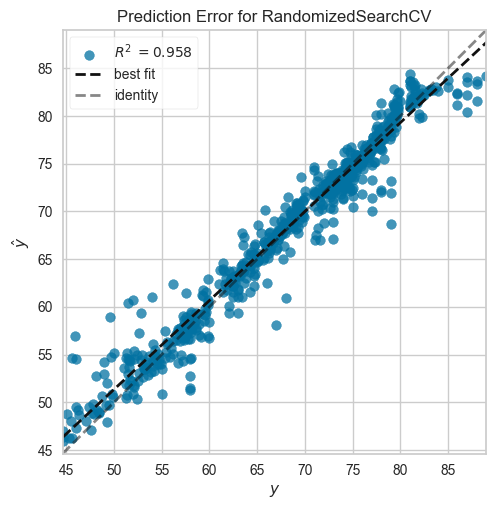

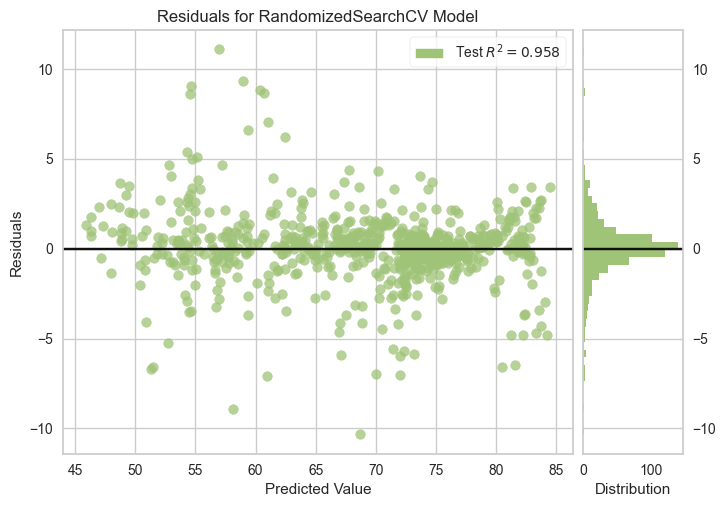

In [134]:
param_grid = {
    'n_estimators': [200,500,800,1000],
    'criterion': ['squared_error','absolute_error','friedman_mse','poisson'],
    'max_features': ['sqrt','log2'],
    'bootstrap': [True,False],
    'oob_score': [True,False],
    'warm_start': [True,False],
    'max_samples': [0.25,0.5,0.75,1.0]
}

grid_rf = RandomizedSearchCV(estimator=RandomForestRegressor(),param_distributions=param_grid,verbose=2,return_train_score=True,scoring='r2')
train_and_evaluate_model(grid_rf)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_start=True; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_start=True; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_start=True; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_start=True; total time=   0.0s
[CV] END alpha=0.001, fit_intercept=False, solver=newton-cholesky, warm_start=True; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, solver=newton-cholesky, warm_start=False; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, solver=newton-cholesky, warm_start=False; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, solver=newton-cholesky, warm_start=False; total time=   0.0s
[CV] END alpha=0.01, fit_intercept=False, solver=newton-cholesky, warm_start=False; total time=   0.0s
[CV] END alp

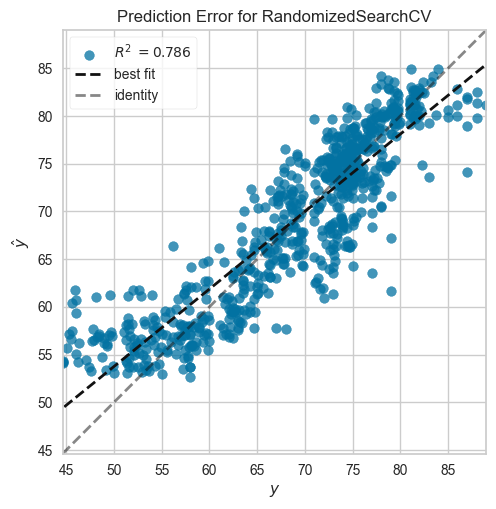

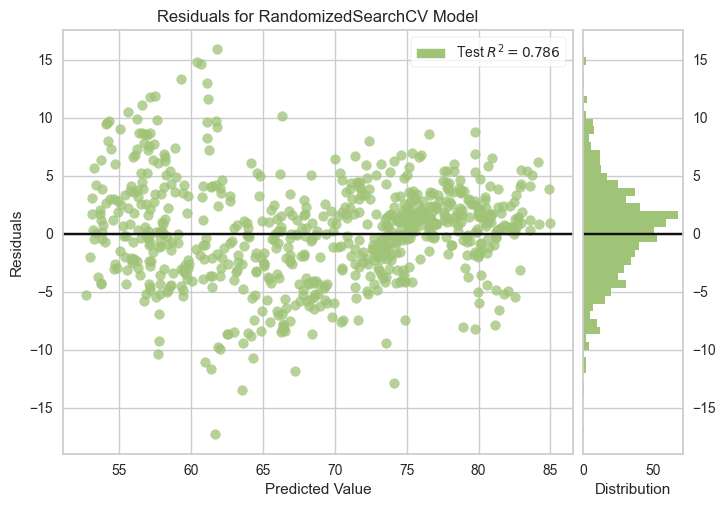

In [135]:
param_grid = {
    'alpha': [0.001,0.01,0.1],
    'fit_intercept': [True,False],
    'solver': ['lbfgs','newton-cholesky'],
    'warm_start': [True,False]
}

grid_gamma = RandomizedSearchCV(estimator=GammaRegressor(),param_distributions=param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_gamma)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END C=0.1, degree=4, epsilon=0.1, gamma=scale, kernel=sigmoid, shrinking=True; total time=   0.2s
[CV] END C=0.1, degree=4, epsilon=0.1, gamma=scale, kernel=sigmoid, shrinking=True; total time=   0.1s
[CV] END C=0.1, degree=4, epsilon=0.1, gamma=scale, kernel=sigmoid, shrinking=True; total time=   0.1s
[CV] END C=0.1, degree=4, epsilon=0.1, gamma=scale, kernel=sigmoid, shrinking=True; total time=   0.1s
[CV] END C=0.1, degree=4, epsilon=0.1, gamma=scale, kernel=sigmoid, shrinking=True; total time=   0.1s
[CV] END C=1, degree=3, epsilon=0.01, gamma=auto, kernel=poly, shrinking=False; total time=   0.1s
[CV] END C=1, degree=3, epsilon=0.01, gamma=auto, kernel=poly, shrinking=False; total time=   0.2s
[CV] END C=1, degree=3, epsilon=0.01, gamma=auto, kernel=poly, shrinking=False; total time=   0.1s
[CV] END C=1, degree=3, epsilon=0.01, gamma=auto, kernel=poly, shrinking=False; total time=   0.1s
[CV] END C=1, degree=3, epsi

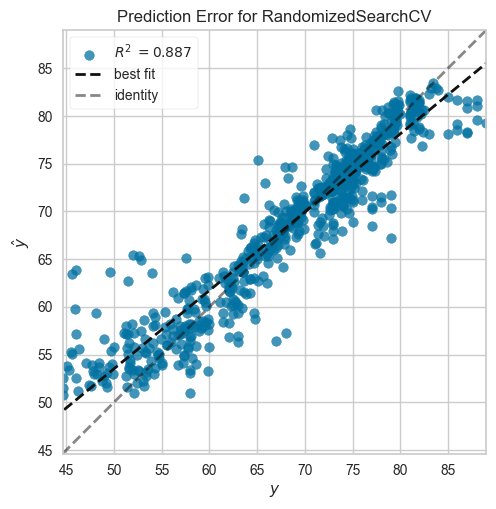

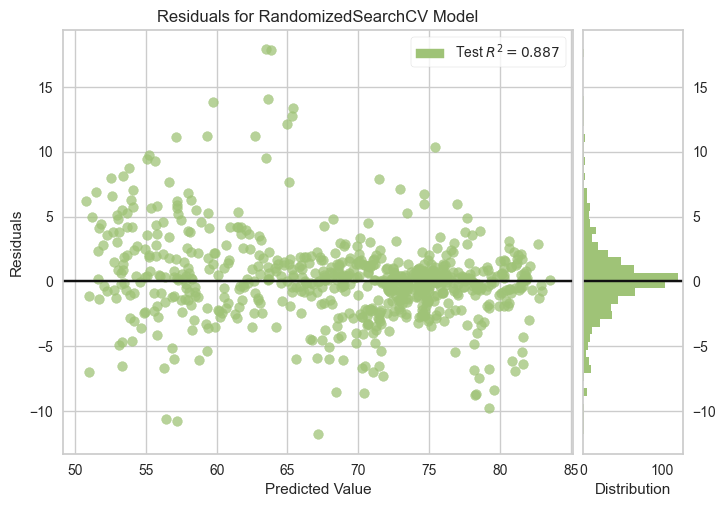

In [136]:
param_grid = {
    'kernel': ['linear','poly','rbf','sigmoid'],
    'degree': [1,2,3,4],
    'C': [0.01,0.1,1,10],
    'gamma': ['scale','auto'],
    'shrinking': [True,False],
    'epsilon': [0.001,0.01,0.1,1]
}

grid_svr = RandomizedSearchCV(estimator=SVR(),param_distributions=param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_svr)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END C=10, degree=4, kernel=poly, nu=0.1, shrinking=False; total time=   0.2s
[CV] END C=10, degree=4, kernel=poly, nu=0.1, shrinking=False; total time=   0.2s
[CV] END C=10, degree=4, kernel=poly, nu=0.1, shrinking=False; total time=   0.1s
[CV] END C=10, degree=4, kernel=poly, nu=0.1, shrinking=False; total time=   0.2s
[CV] END C=10, degree=4, kernel=poly, nu=0.1, shrinking=False; total time=   0.1s
[CV] END C=0.1, degree=4, kernel=linear, nu=0.5, shrinking=False; total time=   0.1s
[CV] END C=0.1, degree=4, kernel=linear, nu=0.5, shrinking=False; total time=   0.1s
[CV] END C=0.1, degree=4, kernel=linear, nu=0.5, shrinking=False; total time=   0.1s
[CV] END C=0.1, degree=4, kernel=linear, nu=0.5, shrinking=False; total time=   0.1s
[CV] END C=0.1, degree=4, kernel=linear, nu=0.5, shrinking=False; total time=   0.1s
[CV] END C=10, degree=2, kernel=rbf, nu=0.5, shrinking=False; total time=   0.2s
[CV] END C=10, degree=2

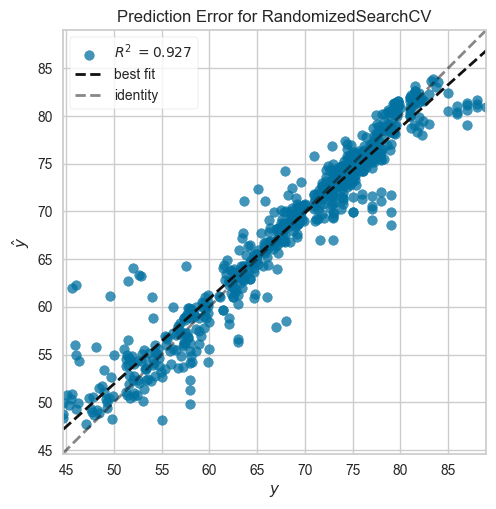

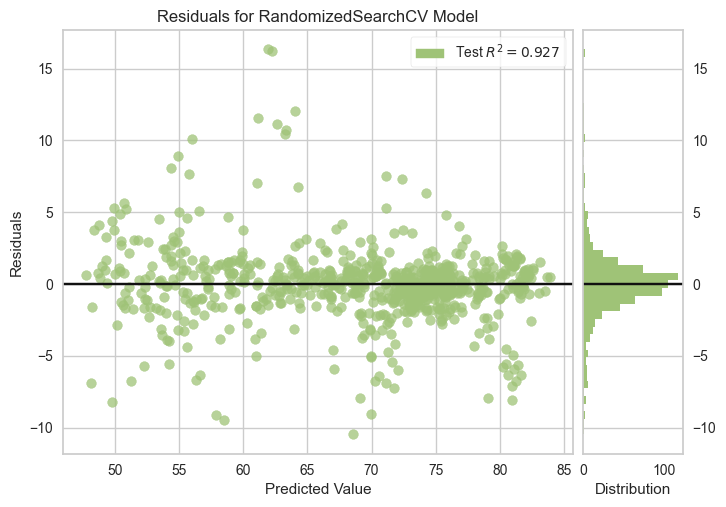

In [137]:
param_grid = {
    'nu': [0.001,0.01,0.1,0.5,1],
    'C': [0.1,1,10],
    'kernel': ['linear','poly','rbf','sigmoid'],
    'degree': [1,2,3,4],
    'shrinking': [True,False]
}

grid_nusvr = RandomizedSearchCV(estimator=NuSVR(),param_distributions=param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_nusvr)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END copy_X=False, fit_intercept=False, max_subpopulation=1, n_subsamples=753; total time=   0.0s
[CV] END copy_X=False, fit_intercept=False, max_subpopulation=1, n_subsamples=753; total time=   0.0s
[CV] END copy_X=False, fit_intercept=False, max_subpopulation=1, n_subsamples=753; total time=   0.0s
[CV] END copy_X=False, fit_intercept=False, max_subpopulation=1, n_subsamples=753; total time=   0.0s
[CV] END copy_X=False, fit_intercept=False, max_subpopulation=1, n_subsamples=753; total time=   0.0s
[CV] END copy_X=True, fit_intercept=True, max_subpopulation=1, n_subsamples=None; total time=   0.0s
[CV] END copy_X=True, fit_intercept=True, max_subpopulation=1, n_subsamples=None; total time=   0.0s
[CV] END copy_X=True, fit_intercept=True, max_subpopulation=1, n_subsamples=None; total time=   0.0s
[CV] END copy_X=True, fit_intercept=True, max_subpopulation=1, n_subsamples=None; total time=   0.0s
[CV] END copy_X=True, fit

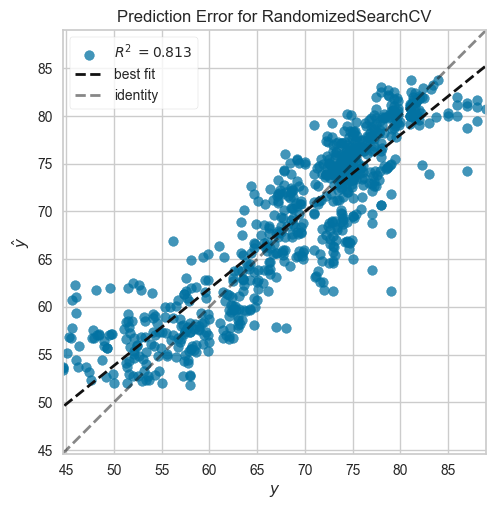

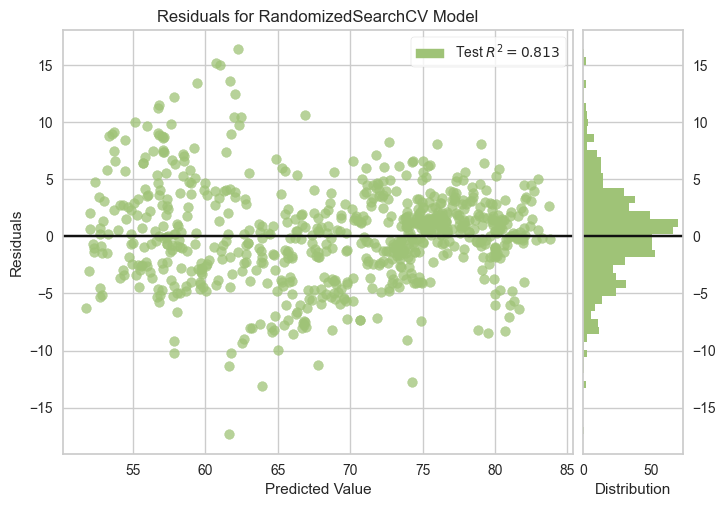

In [138]:
param_grid = {
    'fit_intercept': [True,False],
    'copy_X': [True,False],
    'max_subpopulation': [1,10,100,1000,10000,100000],
    'n_subsamples': [300,500,753,None]
}

grid_tsr = RandomizedSearchCV(estimator=TheilSenRegressor(),param_distributions=param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_tsr)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha_1=1e-08, alpha_2=1e-08, compute_score=False, fit_intercept=True, lambda_1=1e-05, lambda_2=1e-05; total time=   0.0s
[CV] END alpha_1=1e-08, alpha_2=1e-08, compute_score=False, fit_intercept=True, lambda_1=1e-05, lambda_2=1e-05; total time=   0.0s
[CV] END alpha_1=1e-08, alpha_2=1e-08, compute_score=False, fit_intercept=True, lambda_1=1e-05, lambda_2=1e-05; total time=   0.0s
[CV] END alpha_1=1e-08, alpha_2=1e-08, compute_score=False, fit_intercept=True, lambda_1=1e-05, lambda_2=1e-05; total time=   0.0s
[CV] END alpha_1=1e-08, alpha_2=1e-08, compute_score=False, fit_intercept=True, lambda_1=1e-05, lambda_2=1e-05; total time=   0.0s
[CV] END alpha_1=1e-08, alpha_2=1e-07, compute_score=False, fit_intercept=True, lambda_1=1e-05, lambda_2=1e-07; total time=   0.0s
[CV] END alpha_1=1e-08, alpha_2=1e-07, compute_score=False, fit_intercept=True, lambda_1=1e-05, lambda_2=1e-07; total time=   0.0s
[CV] END alpha_1=1e-08

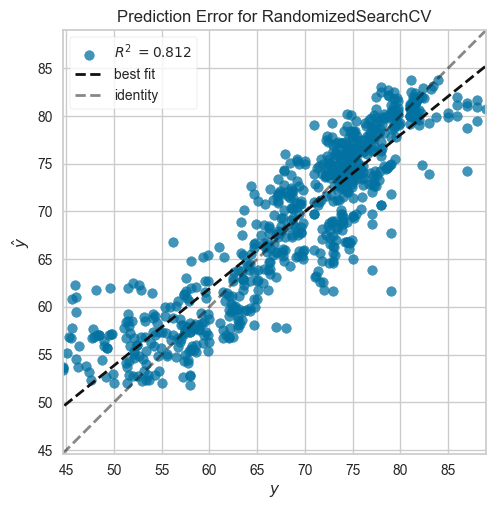

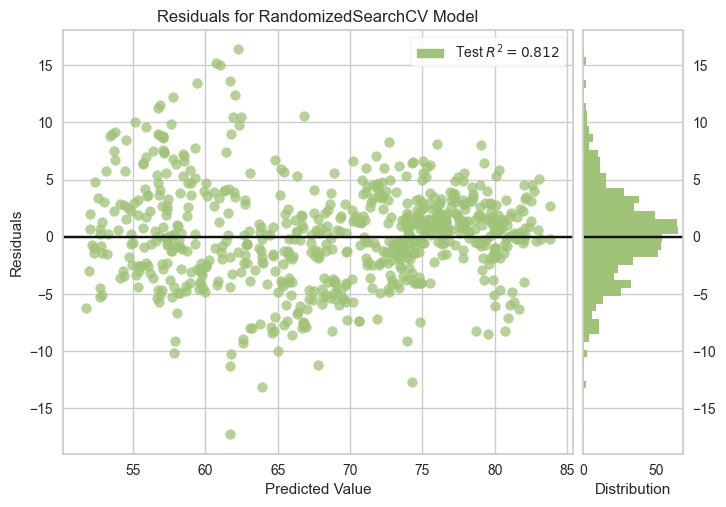

In [139]:
param_grid = {'alpha_1': [1e-5,1e-6,1e-7,1e-8],
'alpha_2': [1e-5,1e-6,1e-7,1e-8],
'lambda_1': [1e-5,1e-6,1e-7,1e-8],
'lambda_2': [1e-5,1e-6,1e-7,1e-8],
'fit_intercept': [True,False],
'compute_score': [True,False]
             }

grid_bayesian_ridge = RandomizedSearchCV(BayesianRidge(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_bayesian_ridge)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END .learning_rate=0.001, loss=square, n_estimators=500; total time=   2.6s
[CV] END .learning_rate=0.001, loss=square, n_estimators=500; total time=   2.2s
[CV] END .learning_rate=0.001, loss=square, n_estimators=500; total time=   2.3s
[CV] END .learning_rate=0.001, loss=square, n_estimators=500; total time=   2.3s
[CV] END .learning_rate=0.001, loss=square, n_estimators=500; total time=   2.4s
[CV] END ..learning_rate=0.01, loss=linear, n_estimators=200; total time=   1.1s
[CV] END ..learning_rate=0.01, loss=linear, n_estimators=200; total time=   0.9s
[CV] END ..learning_rate=0.01, loss=linear, n_estimators=200; total time=   0.9s
[CV] END ..learning_rate=0.01, loss=linear, n_estimators=200; total time=   0.9s
[CV] END ..learning_rate=0.01, loss=linear, n_estimators=200; total time=   1.0s
[CV] END ...learning_rate=0.1, loss=square, n_estimators=800; total time=   2.8s
[CV] END ...learning_rate=0.1, loss=square, n_es

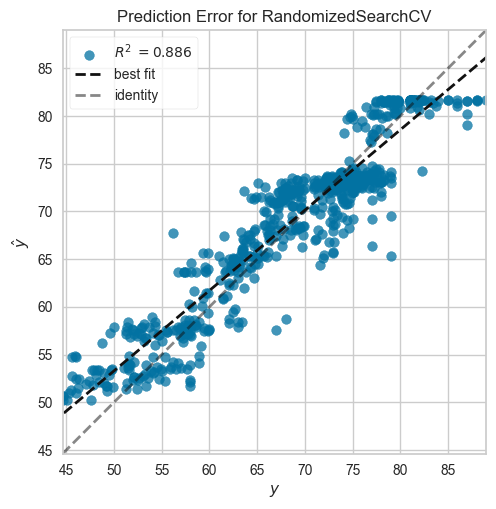

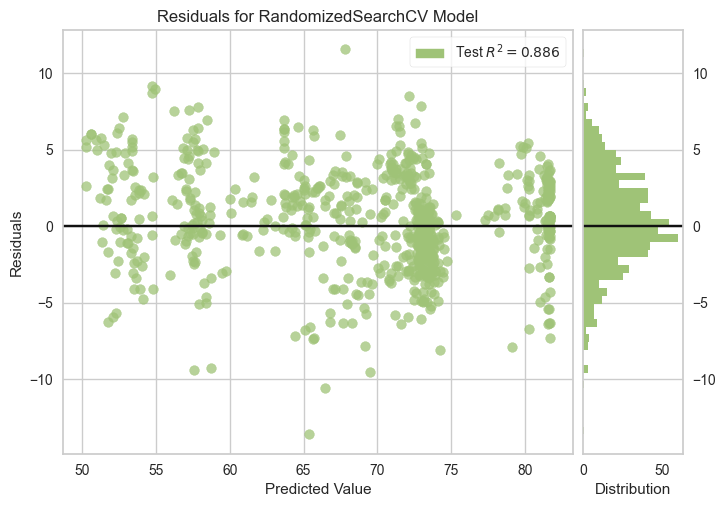

In [140]:
param_grid = {
    'n_estimators': [200,500,800,1000],
    'learning_rate': [0.001,0.01,0.1,1],
    'loss': ['linear','square','exponential']
}

grid_ab = RandomizedSearchCV(estimator=AdaBoostRegressor(),param_distributions=param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_ab)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END bootstrap=False, criterion=friedman_mse, max_features=sqrt, max_samples=0.9, n_estimators=800, oob_score=False; total time=   0.0s
[CV] END bootstrap=False, criterion=friedman_mse, max_features=sqrt, max_samples=0.9, n_estimators=800, oob_score=False; total time=   0.0s
[CV] END bootstrap=False, criterion=friedman_mse, max_features=sqrt, max_samples=0.9, n_estimators=800, oob_score=False; total time=   0.0s
[CV] END bootstrap=False, criterion=friedman_mse, max_features=sqrt, max_samples=0.9, n_estimators=800, oob_score=False; total time=   0.0s
[CV] END bootstrap=False, criterion=friedman_mse, max_features=sqrt, max_samples=0.9, n_estimators=800, oob_score=False; total time=   0.0s
[CV] END bootstrap=False, criterion=squared_error, max_features=log2, max_samples=1, n_estimators=800, oob_score=False; total time=   0.0s
[CV] END bootstrap=False, criterion=squared_error, max_features=log2, max_samples=1, n_estimators=80

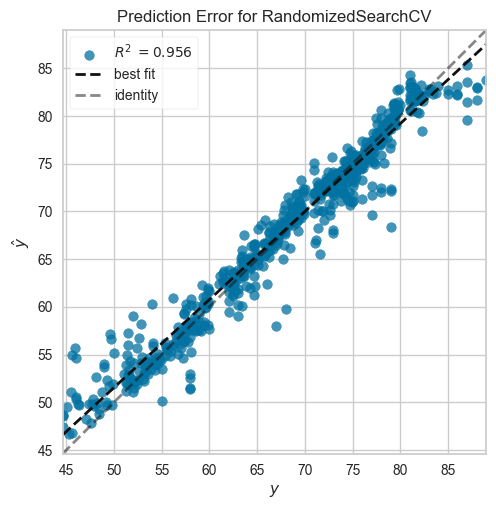

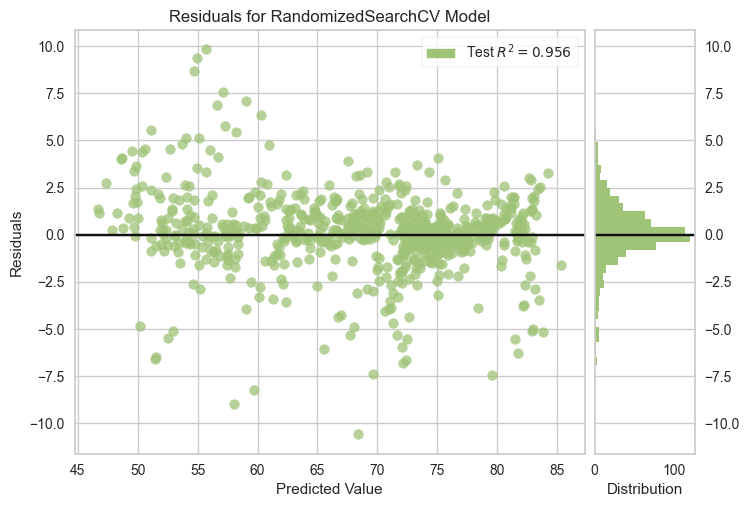

In [141]:
param_grid = {
    'n_estimators': [200,500,800,1000],
    'criterion': ['squared_error','absolute_error','friedman_mse','poisson'],
    'max_features': ['auto','sqrt','log2'],
    'bootstrap': [True,False],
    'oob_score': [True,False],
    'max_samples': [0.5,0.75,0.9,1]
}

grid_et = RandomizedSearchCV(estimator=ExtraTreesRegressor(),param_distributions=param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_et)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[23:51:28] WARNING: C:\Users\dev-admin\croot2\xgboost-split_1675461376218\work\src\learner.cc:767: 
Parameters: { "colsample_bynode", "num_parallel_tree", "subsample" } are not used.

[CV] END booster=gblinear, importance_type=total_gain, learning_rate=0.1, n_estimators=200; total time=   0.0s
[23:51:28] WARNING: C:\Users\dev-admin\croot2\xgboost-split_1675461376218\work\src\learner.cc:767: 
Parameters: { "colsample_bynode", "num_parallel_tree", "subsample" } are not used.

[CV] END booster=gblinear, importance_type=total_gain, learning_rate=0.1, n_estimators=200; total time=   0.0s
[23:51:28] WARNING: C:\Users\dev-admin\croot2\xgboost-split_1675461376218\work\src\learner.cc:767: 
Parameters: { "colsample_bynode", "num_parallel_tree", "subsample" } are not used.

[CV] END booster=gblinear, importance_type=total_gain, learning_rate=0.1, n_estimators=200; total time=   0.0s
[23:51:28] WARNING: C:\Users\dev-admin\croot2\xgboost-

R2 Score: 0.9310068659598802
Mean Absolute Error: 1.7451431623084281
Mean Absolute Percentage Error: 0.0267679013114378
Root Mean Squared Error: 2.54479513971293


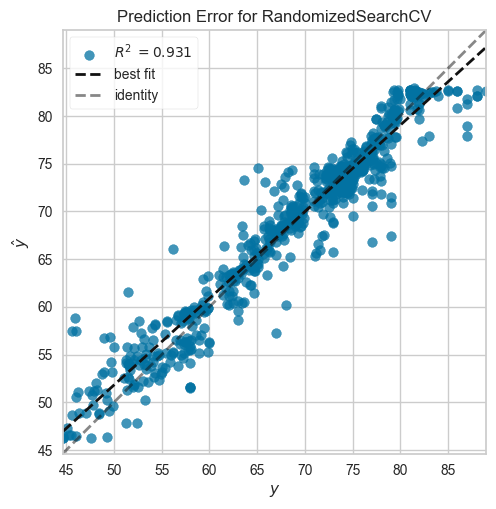

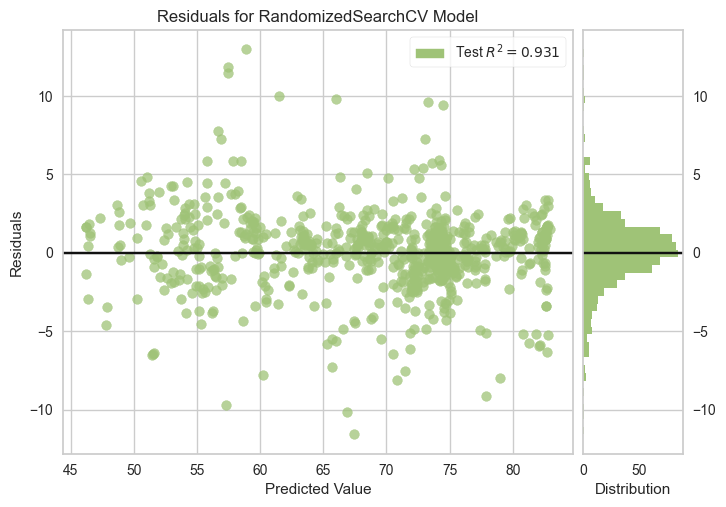

In [142]:
param_grid = {
    'n_estimators': [200,500,800,1000],
    'learning_rate': [0.001,0.01,0.1,1],
    'booster': ['gbtree','dart','gblinear'],
    'importance_type': ['gain','weight','cover','total_gain','total_cover']
}

grid_xgbrf = RandomizedSearchCV(estimator=XGBRFRegressor(),param_distributions=param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_xgbrf)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END bootstrap=True, bootstrap_features=False, max_features=0.5, max_samples=0.5, n_estimators=200, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=True, bootstrap_features=False, max_features=0.5, max_samples=0.5, n_estimators=200, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=True, bootstrap_features=False, max_features=0.5, max_samples=0.5, n_estimators=200, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=True, bootstrap_features=False, max_features=0.5, max_samples=0.5, n_estimators=200, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=True, bootstrap_features=False, max_features=0.5, max_samples=0.5, n_estimators=200, oob_score=True, warm_start=True; total time=   0.0s
[CV] END bootstrap=True, bootstrap_features=True, max_features=0.65, max_samples=1, n_estimators=200, oob_score=True, warm_start=True; total time=   0.0s
[CV] 

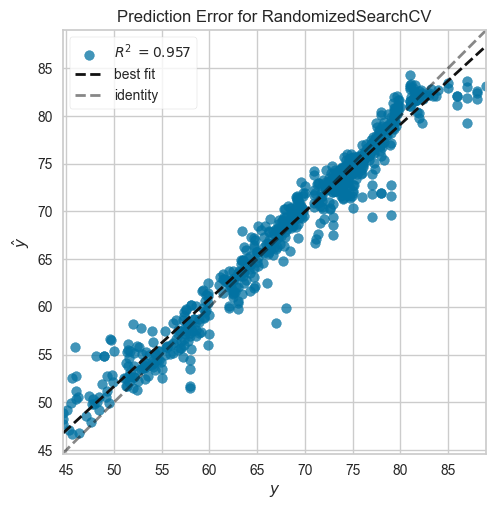

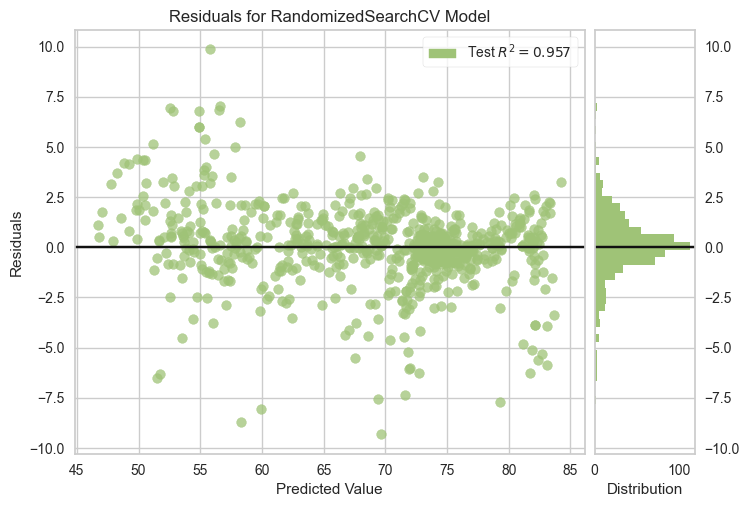

In [143]:
param_grid = {
    'n_estimators': [200,500,800,1000],
    'max_samples': [0.25,0.5,0.75,1],
    'max_features': [0.5,0.65,0.85,1],
    'bootstrap': [True,False],
    'oob_score': [True,False],
    'bootstrap_features': [True,False],
    'warm_start': [True,False]
}

grid_bag = RandomizedSearchCV(estimator=BaggingRegressor(),param_distributions=param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_bag)

## Optimized Models Performance Comparison

In [169]:
model_perfs = pd.DataFrame({'model': models, 'r2': r2_scores, 'rmse': rmse_scores, 'mape': mape_scores}).sort_values('r2',ascending=False).reset_index()
model_perfs[:20]

,index,model,r2,rmse,mape
0,20,"(ExtraTreeRegressor(random_state=1398445125), ...",0.966515,1.772873,0.015890
1,30,"VotingRegressor(estimators=[('CAT',\n ...",0.965987,1.786794,0.016788
2,31,"StackingRegressor(estimators=[('CAT',\n ...",0.964580,1.823372,0.017470
3,37,"RandomizedSearchCV(cv=5,\n e...",0.963949,1.839547,0.018028
4,28,<catboost.core.CatBoostRegressor object at 0x0...,0.962077,1.886682,0.018638
5,33,"RandomizedSearchCV(cv=5, estimator=HistGradien...",0.960036,1.936787,0.020061
6,26,"XGBRegressor(base_score=None, booster=None, ca...",0.959053,1.960475,0.019414
7,19,"(DecisionTreeRegressor(max_features='auto', ra...",0.958025,1.984939,0.018891
8,51,RandomizedSearchCV(estimator=RandomForestRegre...,0.957589,1.995218,0.019220
9,60,"RandomizedSearchCV(cv=5, estimator=BaggingRegr...",0.957385,1.999995,0.020582


In [170]:
best_model = model_perfs.iloc[0]['model']
best_model

ExtraTreesRegressor()

Even after tuning the hyperparameters of all the models, the Extra Trees Regressor model stays intact as the best performing model with an R2 score of more than 96.6%.

## Evaluating the best performing model using cross validation

In [179]:
mean_cv_r2_score = np.round(np.mean(cross_val_score(best_model,final_X_test_tf,y_test,scoring='r2'))*100,2)
print(f"Mean test cross validation R2 score: {mean_cv_r2_score}%")
del mean_cv_r2_score
gc.collect()

Mean test cross validation R2 score: 94.17%


130

That's excellent!

The Extra Trees Regressor model has produced a magnificent r2 score of more than 94.1% on the cross validation test set.

In [181]:
print("Train R2 score:",np.round(best_model.score(final_X_train_tf,y_train)*100,2))

Train R2 score: 100.0


In [182]:
mean_cv_r2_score = np.round(np.mean(cross_val_score(best_model,final_X_train_tf,y_train,scoring='r2'))*100,2)
print(f"Mean train cross validation R2 score: {mean_cv_r2_score}%")
del mean_cv_r2_score
gc.collect()

Mean train cross validation R2 score: 96.19%


3353

The performance of the Extra Trees Regressor model on train and test sets is quite comparable. So, there is no overfitting.

## Saving the best model for deployment into production

In [193]:
pipeline = Pipeline(steps=[
    ('transformer',transformer),
    ('scaler',scaler),
    ('model',best_model)
])
pipeline

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  ['Polio', 'Adult Mortality',
                                                   'Diphtheria', 'HIV/AIDS',
                                                   'Schooling',
                                                   'Income Composition of '
                                                   'Resources',
                                                   'Thinness 5-9 Years',
                                                   'Under-Five Deaths'])])),
                ('scaler', StandardScaler()),
                ('model', ExtraTreesRegressor())])

In [198]:
joblib.dump(pipeline,'pipeline.pkl')

['pipeline.pkl']

In [199]:
joblib.load('pipeline.pkl')

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('power_transform',
                                                  PowerTransformer(),
                                                  ['Polio', 'Adult Mortality',
                                                   'Diphtheria', 'HIV/AIDS',
                                                   'Schooling',
                                                   'Income Composition of '
                                                   'Resources',
                                                   'Thinness 5-9 Years',
                                                   'Under-Five Deaths'])])),
                ('scaler', StandardScaler()),
                ('model', ExtraTreesRegressor())])

In [201]:
gc.collect()

0

In [191]:
for col in final_X_train_tf.columns:
    print(f"Min value of {col}:",df[col].min())
    print(f"Max value of {col}:",df[col].max())

Min value of Polio: 49.5
Max value of Polio: 99.0
Min value of Adult Mortality: 1.0
Max value of Adult Mortality: 456.5
Min value of BMI: 1.0
Max value of BMI: 87.3
Min value of Diphtheria: 49.5
Max value of Diphtheria: 99.0
Min value of HIV/AIDS: 0.1
Max value of HIV/AIDS: 1.85
Min value of Schooling: 4.600000000000002
Max value of Schooling: 19.799999999999997
Min value of Income Composition of Resources: 0.10262499999999991
Max value of Income Composition of Resources: 0.948
Min value of Thinness 5-9 Years: 0.1
Max value of Thinness 5-9 Years: 15.599999999999998
Min value of Under-Five Deaths: 0
Max value of Under-Five Deaths: 70
Min value of Alcohol: 0.01
Max value of Alcohol: 17.87
